In [69]:
from platform import python_version

print(python_version())

from IPython.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

import matplotlib.pyplot as plt
import matplotlib.lines as mlines
from matplotlib.lines import Line2D
from matplotlib import cm
import matplotlib as mpl
from mpl_toolkits.axes_grid1 import make_axes_locatable

from rdkit.Chem import rdMolDescriptors
from rdkit.Chem import Lipinski
from rdkit.Chem import AllChem

from mendeleev import element

#import chemcoord as cc
from scipy import stats
from rdkit import Chem
import seaborn as sns
import pandas as pd
import numpy as np
import shutil
import glob
import csv
import ast
import os
import re
from os.path import exists
import rmsd
from itertools import product
from itertools import combinations
import pickle

#sns.set_context('paper', font_scale=1.1)

## CHANGE FOR YOUR COMPUTER ##
comp_loc = '/Users/z5380625/Documents/Research/'

3.10.6


# Calculate RMSD

In [70]:
def RMSD(file_1,file_2): 
    print(file_1,file_2)
    inp_list = [open(file_1, 'r'),open(file_2, 'r')]
    xyz_list = []
    for inp in inp_list:
        line_list = [line.strip().split() for line in inp]

        xyz = []
        i = 0
        for line in line_list:
            if i > 1:
                #print(line)
                xyz.append([float(line[1]),float(line[2]),float(line[3])])
            i += 1
        
        xyz_list.append(xyz)

    U = rmsd.kabsch(xyz_list[0], xyz_list[1])
    A = np.dot(xyz_list[0], U)
    
#     # Plotting
#     xyz_A = list(zip(*A))
#     xyz_B = list(zip(*xyz_list[1]))
    
#     ax = plt.axes(projection='3d')
#     ax.scatter3D(xyz_A[0], xyz_A[1], xyz_A[2], color = 'r')
#     ax.scatter3D(xyz_B[0], xyz_B[1], xyz_B[2], color = 'b')
    
    return rmsd.rmsd(A, xyz_list[1])

# RMSD CREST/CREST

In [20]:
### get and calculate RMSD for all molecules an save them##
number_atoms_files = glob.glob(comp_loc+'4_BigData/?_Atoms')+glob.glob(comp_loc+'4_BigData/??_Atoms')
number_atoms_files.remove(comp_loc+'4_BigData/21_Atoms')# Didnot work in QCOpt
#print(number_atoms_files)

## DataFile  ##
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')


df = pd.DataFrame(columns = ['Formula','Conf_1','Conf_2','RMSD'])
for file_loc in number_atoms_files:
    print(file_loc)
    num_atoms = float(file_loc.split('/')[-1].split('_')[0])
    if num_atoms == 6:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']<=6]['Formula'].values)
    elif num_atoms == 8:
        molecules_list = np.unique(data_all.loc[(data_all['# Atoms']>6)&(data_all['# Atoms']<=8)]['Formula'].values)
    else:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']==num_atoms]['Formula'].values)
    print(molecules_list)
    for mol in molecules_list:
        print(mol)
        conf_list = data_all.loc[data_all['Formula']==mol]['Conf#'].values
        crest_files_list = glob.glob('/Users/z5380625/Documents/Research/4_BigData/'+str(int(num_atoms))+'_Atoms/' +'3_CREST_CENSO_Outputs/FinalGeoms_CREST/'+mol+'_*.xyz')
        print(crest_files_list)
        # Get all combinations of confs
        combos_conf_list = list(combinations(crest_files_list,2))
        
        # compute RMSD of combos
        combo_rmsd_list = []
        for combo in combos_conf_list:
            CONFA = 'CONF'+str(int(float(combo[0].split('/')[-1].split('_')[-1].split('.xyz')[0] )+1))
            CONFB = 'CONF'+str(int(float(combo[1].split('/')[-1].split('_')[-1].split('.xyz')[0])+1))
            #print(mol,set([CONFA,CONFB]).issubset( conf_list ),CONFA,CONFB,conf_list)
            if set([CONFA,CONFB]).issubset( conf_list ):
                num_rmsd = RMSD(combo[0],combo[1])
                df.loc[len(df)] = list([mol,CONFA,CONFB,float(num_rmsd)])

            
df

/Users/z5380625/Documents/Research/4_BigData/6_Atoms
['C2H2' 'C2H2O2' 'C2H2OS_1' 'C2H2OS_2' 'C2H2O_1' 'C2H2O_2' 'C2H2S2_1'
 'C2H2S2_2' 'C2H2S_1' 'C2H2S_2' 'C2H3N_1' 'C2H3N_2' 'C2H3N_3' 'C2H4'
 'C2HN3' 'C2HNO' 'C2HNS2' 'C2HOP' 'C2N2' 'C2N2O' 'C2N2S' 'C2S2' 'C3H2O_1'
 'C3H2O_2' 'C3H2O_3' 'C3HN' 'C3HNO' 'C3N2O' 'C3S2' 'C4H2' 'C4S2' 'CH2N2'
 'CH2N2O_1' 'CH2N2O_2' 'CH2N2S' 'CH2O' 'CH2O2' 'CH2O3' 'CH2OS' 'CH2S'
 'CH3NO' 'CH3NS' 'CH3OP' 'CH4' 'CH4O' 'CH4S' 'CHN' 'CHN3O' 'CHNO2S'
 'CHNO3_1' 'CHNO3_2' 'CHNO_1' 'CHNO_2' 'CHNS' 'CN2O3' 'CN2OS' 'CN2O_2'
 'CO' 'CO2' 'COS' 'CS2' 'H2N2O2' 'H2O' 'H2O2' 'H2O2S2' 'H2O3S' 'H2S' 'H3N'
 'H3NO' 'H3O2P' 'H3OP' 'H3P' 'H4N2' 'H4NP' 'HN3' 'HNO' 'HNO2S' 'HNO3'
 'HO2P' 'HOP' 'N2' 'O2' 'O2S' 'O3' 'O3S' 'P4']
C2H2
['/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2_conformers_0.xyz']
C2H2O2
['/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O2_conformers_0.xyz']
C2H2OS_1
[

['/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO2S_1_conformers_0.xyz']
C2H3NO2S_2
['/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO2S_2_conformers_0.xyz']
C2H3NO2S_3
['/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO2S_3_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO2S_3_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO2S_3_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO2S_3_conformers_1.xyz']
C2H3NO3_1
['/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO3_1_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO3_1_c

/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NS_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NS_4_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NS_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NS_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NS_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NS_4_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_C

/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS_3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS_3_conformers_2.xyz
C3H4OS_4
['/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS_4_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS_4_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS_4_conformers_1.xyz
C3H4OS_5
['/Users/z5380625/Documents/Res

CH4N2OS_2
['/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4N2OS_2_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4N2OS_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4N2OS_2_conformers_1.xyz']
CH4N2S2_1
['/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4N2S2_1_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4N2S2_1_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4N2S2_1_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4N2S2_1_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4N2S2_1_conformers_2.xyz', '/

C2H2O3_1
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O3_1_conformers_0.xyz']
C2H2O3_2
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O3_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O3_2_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O3_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O3_2_conformers_1.xyz
C2H2O4
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O4_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O4_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O4_conformers_2.xyz', '/Users/z5380625

['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2HN3S_1_conformers_0.xyz']
C2HN3S_2
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2HN3S_2_conformers_0.xyz']
C2HNO3
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2HNO3_conformers_0.xyz']
C2HNS3_1
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2HNS3_1_conformers_0.xyz']
C2HNS3_2
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2HNS3_2_conformers_0.xyz']
C3H2N2O_1
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H2N2O_1_conformers_0.xyz']
C3H2N2O_3
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H2N2O_3_conformers_0.xyz']
C3H2N2O_4
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/Final

/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH2S4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH2S4_conformers_6.xyz
CH2S5
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH2S5_conformers_0.xyz']
CH3N2P
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH3N2P_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH3N2P_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH3N2P_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH3N2P_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH3N2P_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigDa

H3O3PS
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3O3PS_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3O3PS_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3O3PS_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3O3PS_conformers_1.xyz
H3O4P
['/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3O4P_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3O4P_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3O4P_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3O4P_conformers_3.xyz']
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_30.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_30.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_42.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_40.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_11_conformers_33.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_66.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_54.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_66.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_13.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_54.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_11.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_2.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_30.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_37.xyz
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_54.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_54.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_55.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_52.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_18.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_40.xyz
/Users/z5380625/Documents/Resea

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_79.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_50.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_79.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_50.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_79.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_16_conformers_50.xyz
C4H12N2_17
['/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_17_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_17_conformers_8.xyz', '/Users/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_19_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_19_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_19_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_19_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_19_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_19_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_19_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_19_conformers_13.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_104.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_4.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_86.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_45.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_36.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_36.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_20_conformers_24.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_60.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_35.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_60.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_60.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_60.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_25.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_6.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_67.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_67.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_43.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_67.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_67.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_0.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_6.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_79.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_35.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_44.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_79.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_43.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_1.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_19.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_23_conformers_34.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_24_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_24_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_24_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_24_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_24_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_24_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_24_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_24_conformers_2.xyz
/Users/z5380625/Documents/Re

['/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_25_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_25_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_25_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_25_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_25_conformers_0.xyz
C4H12N2_3
['/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_26.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_32.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_7.xyz', '/U

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_16.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_14.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_41.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_8_conformers_8.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_1_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_1_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_1_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_1_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_1_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_1_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_1_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/18

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_12_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_12_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_12_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_12_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_12_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_12_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_12_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_12_conformers_2.xyz
/Users/z5380625/Documents/Research/

['/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_3.xyz', '/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_14_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_14_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_14_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_14_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_14_conformers_2.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_8_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_7.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_11_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_11_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_11_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_11_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_11_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_11_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_11_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_11_conformers_7.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_13_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_13_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_13_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_13_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_13_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_13_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_13_conformers_7.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_3_conformers_0.xyz
C5H12S_4
['/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_4_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_4_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_4_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_4_conformers_4.xyz', '/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_6_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_6_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_6_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_6_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_6_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_6_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_6_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/18_

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_8_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_8_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_8_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_8_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_16_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_16_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_16_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_16_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_16_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_16_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_16_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_16_conformers_3.xyz
C6H12_17
['/Users/z5380625/Documents/Research/4_

['/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_3_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_3_conformers_1.xyz']
C6H12_4
['/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_4_conformers_0.xyz']
C6H12_5
['/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_5_conformers_0.xyz']
C6H12_6
['/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_6_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_6_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_6_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_6_conformers_1.xyz']
/Use

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_5.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_13_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_13_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_13_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_13_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_13_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_13_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_13_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_13_conformers_2.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_14_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_14_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_14_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_14_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_14_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_14_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_14_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_14_conformers_12.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_45.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_15_conformers_11.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_17_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_17_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_17_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_17_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_17_conformers_3.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_2_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_2_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_2_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_2_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_4_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_4_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_4_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_4_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_4_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_4_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/19

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_12_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_12_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_12_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_12_conformers_19.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_13_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_13_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_13_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_13_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_13_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_13_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_13_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_13_conformers_10.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_18.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_3.xyz
/Users/z5380625/Documents/Research/4_

C5H13P_3
['/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_3_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_3_conformers_39.xyz', '/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_3_conformers_38.xyz', '/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_3_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_3_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_3_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_3_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_3_conformers_17.xyz', '/Users

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_4_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_4_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/20_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H14_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/20_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H14_3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/20_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H14_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/20_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H14_3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/20_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H14_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/20_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H14_3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/20_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H14_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/20_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H14_3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/20_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NO2S_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NO2S_2_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NO2S_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NO2S_2_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NO2S_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NO2S_2_conformers_0.xyz
C2H7NO2S_3
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NO2S_3_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NO2S_3_conformers_8.xyz', '/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_7.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_3_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_3_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_3_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_3_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_3_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_3_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_3_conformers_10.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_10.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_4_conformers_15.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_5_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_5_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_5_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_5_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_5_conformers_8.xyz
C2H8N2S
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2S_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2S_conformers_1.xyz', '/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_5_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_5_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_5_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_5_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_5_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_5_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_13_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_13_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_13_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_13_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_13_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_13_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_13_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_13_conformers_3.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_8_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_8_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_8_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_8_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_8_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_8_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_8_conformers_0.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_18.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NOS_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_5_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_5_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_5_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_5_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_5_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_5_conformers_8.xyz
C3H7O2P_6
['/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_6_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_6_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_6_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_

['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_3_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_3_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_3_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_3_conformers_3.xyz']
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_3_conformers_0.xyz
C3H8O2_4
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_4_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_4_conformers_10.xyz', '/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_6_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_6_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_6_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_6_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_6_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_6_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_6_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2_6_conformers_8.xyz
C3H8OS_1
['/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_23.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_5_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_2_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_2_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_2_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_2_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_5_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_5_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_5_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_5_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_5_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_5_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_5_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_5_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9P_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9P_3_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9P_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9P_3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9P_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9P_3_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9P_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9P_3_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_

C4H7NO_23
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_23_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_23_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_23_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_23_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_23_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_23_conformers_1.xyz
C4H7NO_24
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_24_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_24_conformers_0.xyz', 

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_3_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_3_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_

C4H7NO_31
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_31_conformers_0.xyz']
C4H7NO_32
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_32_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_32_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_32_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_32_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_32_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_32_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_32_conformers

C4H7NO_44
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_44_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_44_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_44_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_44_conformers_0.xyz
C4H7NO_45
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_45_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_45_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_45_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_45_conformers_1.xyz']


/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_10_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_10_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_10_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_10_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_10_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_10_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_10_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_10_conformers_2.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_8_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_8_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_8_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_8_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_8_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_8_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_8_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_8_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigDat

['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_7_conformers_0.xyz']
C4H8O_8
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_8_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_8_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_8_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_8_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_8_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_8_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_8_conformers_1.xyz', '/Users/z5380625/Docum

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_13_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_13_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_13_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_13_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_

['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_1_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_1_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_1_conformers_1.xyz
C5H7N_10
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_10_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_10_conformers_1.xyz']
C5H7N_11
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_11_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_11_conformers_3.xyz', '/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_4_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_4_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_4_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7P_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7P_9_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7P_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7P_9_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7P_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7P_9_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7P_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7P_9_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_

C5H8_9
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8_9_conformers_0.xyz']
CH7N5
['/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH7N5_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH7N5_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH7N5_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH7N5_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH7N5_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH7N5_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH7N5_conformers_14.xyz', '/Users/z5380625/Documents/

['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_5_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_5_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_5_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_5_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_5_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_5_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_5_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_5_conformers_3.xyz', '/Use

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_3_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_3_conformers_7.xyz
C2H5NO3_4
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_4_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_4_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_4_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_4_conformers_6.xyz', '/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S_5_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S_5_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S_5_conformers_0.xyz
C2H6N2S_6
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S_6_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S_6_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S_6_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S_6_conformers_0.xyz /Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S3_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S3_4_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S3_4_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S3_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S3_4_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S3_4_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S3_4_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S3_4_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_5_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_5_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_5_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_5_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_5_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_5_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_5_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_

['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_19_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_19_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_19_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_19_conformers_1.xyz
C3H5N3_2
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_2_conformers_0.xyz']
C3H5N3_20
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_20_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_20_conformers_0.xyz']
C3H5N3_3
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_3_conformers_

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5O2P_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5O2P_4_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5O2P_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5O2P_4_conformers_1.xyz
C3H5O2P_5
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5O2P_5_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5O2P_5_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5O2P_5_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5O2P_5_conformers_0.xyz', '/Users/z5380625/

['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2_9_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2_9_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2_9_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2_9_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2_9_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2_9_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2_9_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2_9_conformers_6.xyz']
/Users/z5380625/Documen

['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N_5_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N_5_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N_5_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N_5_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N_5_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigDat

['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_25_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_25_conformers_0.xyz']
C4H5NO_3
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_3_conformers_0.xyz']
C4H5NO_4
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_4_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_4_conformers_0.xyz']
C4H5NO_5
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_5_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_5_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_5_conformers_

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_15_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_15_conformers_2.xyz
C4H6O_16
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_16_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_16_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_16_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_16_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_16_conformers_4.xyz']
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_16_conformers_2.xyz /Users/z5380625/Documen

C4H6S_17
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S_17_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S_17_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S_17_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S_17_conformers_0.xyz
C4H6S_18
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S_18_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S_18_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S_18_conformers_0.xyz /Users/z53806

CH5NO3S_1
['/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO3S_1_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO3S_1_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO3S_1_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO3S_1_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO3S_1_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO3S_1_conformers_5.xyz']
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO3S_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO3S_1_conformers_0.xyz
CH5NO3S_2
[

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO2P_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO2P_1_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO2P_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO2P_1_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO2P_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO2P_1_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO2P_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO2P_1_conformers_6.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_10_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_10_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_10_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_10_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_10_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_10_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_10_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_10_conformers_19.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_4_conformers_1.xyz
C3H10N2_5
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_5_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_5_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_5_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_5_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_5_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_5_conformers_3.xyz', '/Users/z53

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_0.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_8_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_8_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_8_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_8_conformers_11.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_0.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_9_conformers_2.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_0.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_1_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_1_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_1_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_31.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_64.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_70.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_71.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_65.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_12.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_46.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_90.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_58.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_90.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_64.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_90.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_70.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_2_conformers_17.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_76.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_B

['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_6_conformers_19.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_6_conformers_25.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_6_conformers_24.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_6_conformers_18.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_6_conformers_26.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_6_conformers_27.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_6_conformers_23.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_6_conformers_22.xyz', '/Users

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_7.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_0.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_2.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_45.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_50.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_44.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_38.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_44.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_91.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_46.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_42.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_45.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_50.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_44.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_91.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_61.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_46.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_64.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_64.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_64.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_64.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_31.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_57.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_57.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_57.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_57.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_27.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_23.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_2_conformers_25.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_3.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_9_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_9_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_9_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_9_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_9_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_9_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_9_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_9_conformers_3.xyz
/Users/z5380625/Documents/Research/4_Big

['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_6_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_6_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_6_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_6_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_6_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_6_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_6_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_6_conformers_2.xyz', '/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S_4_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S_4_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S_4_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S_4_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_14_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_14_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_14_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_14_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_14_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_14_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_14_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_14_conformers_12.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_16_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_16_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_16_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_16_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_16_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_16_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_16_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_16_conformers_0.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_17.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_40.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_19_conformers_40.xyz
/Users/z5380625/Documents/Researc

['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_20_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_20_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_20_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_20_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_20_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_20_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_20_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_20_conformers_7.xyz', '/Users/z538062

['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_24_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_24_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_24_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_24_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_24_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_24_conformers_1.xyz
C4H9NO_25
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_25_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_25_conformers_9.xyz', '/Users/z5

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_27_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_27_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_27_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_27_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_27_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_27_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_27_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_27_conformers_1.xyz
C4H9NO_28
['/Users/z5380625/Documents/Re

['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_38.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_39.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_16.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_17.xyz', '/Users

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_4.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_7.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_27.xyz
/Users/z5380625/Documents/Resear

['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_33_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_33_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_33_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_33_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_33_conformers_3.xyz']
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_33_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_33_conformers_0.xyz
C4H9NO_34
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_34_conformers_8.xyz', '/Users/z5

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_42_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_42_conformers_9.xyz
C4H9NO_43
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_43_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_43_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_43_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_43_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_43_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_43_conformers_3.xyz', '/Users/z5

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_8.xyz
/Users/z5380625/Documents/Research/4_Big

C4H9NO_52
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_7.xyz', '/Use

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_52_conformers_8.xyz
C4H9NO_53
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_53_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_53_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_53_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_53_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_53_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_53_conformers_5.xyz', '/Users/z5

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_55_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_55_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_55_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_55_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_55_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_55_conformers_0.xyz
C4H9NO_56
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_56_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_56_conformers_6.xyz', '/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_59_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_59_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_59_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_59_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_59_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_59_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_59_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_59_conformers_10.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_36.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_22.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_29.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_36.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_23.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_1.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_23.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_7_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_7_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_7_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_7_conformers_30.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_7_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_7_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_7_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_7_conformers_36.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_5_conformers_2.xyz
C4H9NS_6
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_6_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_6_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_6_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_6_conformers_1.xyz']
C4H9NS_7
['/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_4_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_4_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_4_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_4_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_6_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/1

C5H10_2
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10_2_conformers_1.xyz']
C5H10_3
['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10_3_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10_3_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10_3_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10_3_conformers_3.xyz']
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10_3_conformers_0.xyz
C5H10_4
['/Users/z53

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_14_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_14_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_14_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_14_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_14_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_14_conformers_8.xyz
C5H9N_15
['/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_23_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_23_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_23_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_23_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_23_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_23_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_23_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_23_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_36_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_36_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_36_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_36_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_36_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_36_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_36_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_36_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_44_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_44_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_44_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_44_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_44_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_44_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_44_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_44_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_47_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_47_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_47_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_47_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_47_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_47_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_47_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_47_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_49_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_49_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_49_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_49_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_49_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_49_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_49_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_49_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_13_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_20_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_20_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_20_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_20_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_20_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_20_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_20_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_20_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_23_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_23_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_23_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_23_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_23_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_23_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_23_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_23_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_25_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_25_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_25_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_25_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_25_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_25_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_25_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_25_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_3_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_3_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_3_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_

['/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_9_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/17_Atoms
['C3H11N3' 'C4H11NO_1' 'C4H11NO_10' 'C4H11NO_11' 'C4H11NO_12' 'C4H11NO_13'
 'C4H11NO_14' 'C4H11NO_15' 'C4H11NO_16' 'C4H11NO_17' 'C4H11NO_18'
 'C4H11NO_19' 'C4H11NO_2' 'C4H11NO_20' 'C4H11NO_21' 'C4H11NO_22'
 'C4H11NO_23' 'C4H11NO_24' 'C4H11NO_25' 'C4H11NO_26' 'C4H11NO_27'
 'C4H11NO_28' 'C4H11NO_29' 'C4H11NO_3' 'C4H11NO_30' 'C4H11NO_31'
 'C4H11NO_32' 'C4H11NO_33' 'C4H11NO_34' 'C4H11NO_35' 'C4H11NO_36'
 'C4H11NO_4' 'C4H11NO_5' 'C4H11NO_6' 'C4H11NO_7' 'C4H11NO_8' 'C4H11NO_9'
 'C4H11NS_1' 'C4H11NS_2' 'C4H11NS_3' 'C4H11NS_4' 'C4H11NS_5' 'C4H11NS_6'
 'C4H11NS_7' 'C4H11NS_8' 'C4H11NS_9' 'C4H11OP_1' 'C4H11OP_2' 'C4H11OP_3'
 'C4H11OP_4' 'C4H11OP_5' 'C4H11PS_1' 'C4H11PS_2' 'C4H11PS_3' 'C5H11N_1'
 'C5H11N_10' 'C5H11N_11' 'C5H11N_12' 'C5H11N_13' 'C5H11N_14' 'C5H11N_15'
 'C5H11N_16' 'C5H11N_17' 'C5H11N_18' 'C5H11N_19' 'C5H11N_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_99.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_88.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_70.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_65.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_70.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_65.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_67.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_66.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_70.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_70.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_75.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_70.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_70.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_74.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_74.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_45.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_67.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_67.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_67.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_67.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_47.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_45.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_93.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_87.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_72.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_97.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_72.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_68.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_72.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_54.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_72.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_88.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_54.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_88.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_88.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_88.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_75.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_75.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_30.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_75.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_75.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_56.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_95.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_97.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_68.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_85.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_85.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_85.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_85.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_47.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_30.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_97.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_30.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_97.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_97.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_97.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_29.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_70.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_10_conformers_70.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_13_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_13_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_13_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_13_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_13_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_13_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_13_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_13_conformers_2.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_23.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_15_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_15_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_15_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_15_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_15_conformers_2.xyz
/Users/z5380625/Documents/Res

['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_19_conformers_48.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_19_conformers_74.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_19_conformers_60.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_19_conformers_61.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_19_conformers_75.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_19_conformers_49.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_19_conformers_63.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_19_conformers_77.xyz',

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_2.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_33.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_22_conformers_4.xyz
/Users/z5380625/Documents/R

['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_24_conformers_86.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_24_conformers_92.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_24_conformers_45.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_24_conformers_51.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_24_conformers_79.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_24_conformers_78.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_24_conformers_50.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_24_conformers_44.xyz',

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_6.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_3_conformers_58.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_3_conformers_60.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_3_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_3_conformers_56.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_3_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_3_conformers_57.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_32_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_32_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_32_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_32_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_32_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_32_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_32_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_32_conformers_2.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_33_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_33_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_33_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_33_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_33_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_33_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_33_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_33_conformers_7.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_36_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_36_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_36_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_36_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_36_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_36_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_36_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_36_conformers_0.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_5_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_5_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_5_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_5_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_5_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_5_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_5_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_5_conformers_5.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_6_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_6_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_10.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_28.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_0.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_1_conformers_13.xyz
C4H11NS_2
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_2_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_2_conformers_18.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_2_conformers_19.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_2_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_2_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_2_conformers_6.xyz', '/Users

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_58.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_82.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_82.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_42.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_82.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_81.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_11.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_81.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_81.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_81.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_81.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_16.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_44.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_87.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_86.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_21.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_33.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_60.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_48.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_59.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_39.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_31.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_60.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_48.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_59.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_60.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_48.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_9.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_3.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_47.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_42.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_1.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_42.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_0.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_75.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_13.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_5_conformers_28.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_10.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_39.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_28.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_13.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_15.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_0.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_8_conformers_23.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_76.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_71.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_30.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_45.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_84.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_46.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_30.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_84.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_20.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_57.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_68.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_54.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_9.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_46.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_46.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_46.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_27.xyz
/Users/z5380625/Documents/Resear

['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_3_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_3_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_3_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_3_conformers_1.xyz
C4H11OP_4
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_20.xyz', '/Users/z

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_19.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_4_conformers_7.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_1_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_1_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_1_conformers_5.xyz
C5H11N_10
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_10_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_10_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_10_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_10_conformers_3.xyz', '/Users/z5380625/Docu

['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_6.xyz', '/Users/z5

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_5.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_18_conformers_23.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_2_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_2_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_2_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_2_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_26_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_26_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_26_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_26_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_26_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_26_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_26_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_26_conformers_5.xyz']
/Users/z5380625

C5H11N_30
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_30_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_30_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_30_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_30_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_30_conformers_16.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_30_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_30_conformers_15.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_30_conformers_1.xyz'

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_3.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_3.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_3.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_35_conformers_23.xyz
C5H11N_36
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_36_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_36_conformers_9.xyz', '/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_1.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_38_conformers_15.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_6.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_40_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_40_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_40_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_40_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_40_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_40_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_40_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_40_conformers_9.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_22.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_37.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_37.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_37.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_37.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_7.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_9.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_9.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_41_conformers_11.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_10.xyz
/Users/z5380625/Documents/Research/4_

C5H11N_47
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_47_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_47_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_47_conformers_1.xyz']
C5H11N_48
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_48_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_48_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_48_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_48_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_48_conformers_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_10_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_10_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_10_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_10_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_10_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_10_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_10_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_10_conformers_0.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_12.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_15_conformers_9.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_13.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_17_conformers_17.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_19_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_19_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_19_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_19_conformers_2.xyz
C5H11P_2
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_2_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_2_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_2_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_2_conformers_5.xyz', '/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_23_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_23_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_23_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_23_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_23_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_23_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_23_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_23_conformers_4.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_25_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_25_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_25_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_25_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_25_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_25_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_25_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_25_conformers_7.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_5.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_9.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_3.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_2.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_19.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_27_conformers_3.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_4.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_4.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_20.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_5_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_5_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_5_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_5_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_5_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_6_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/1

C5H12_2
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12_2_conformers_1.xyz']
C5H12_3
['/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12_3_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12_3_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12_3_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12_3_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12_3_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12_3_conformers_1.xyz', '/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4O2S2_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4O2S2_4_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4O2S2_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4O2S2_4_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4O2S2_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4O2S2_4_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4O2S2_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4O2S2_4_conformers_3.xyz
/Users/z5380625/Documents/Rese

['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4S4_4_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4S4_4_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4S4_4_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4S4_4_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4S4_4_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4S4_4_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4S4_4_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4S4_4_conformers_0.xyz']
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_8_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_8_conformers_3.xyz
C2H6N2_9
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_9_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_9_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_9_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_9_conformers_1.xyz', '/Users/z5380625/Documents

C2H6OS_5
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6OS_5_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6OS_5_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6OS_5_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6OS_5_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6OS_5_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6OS_5_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6OS_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6OS_5_conformers_0.xyz
C2H6S2_1
['/Users/z5

C3H4O3_6
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4O3_6_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4O3_6_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4O3_6_conformers_1.xyz']
C3H4OS2_1
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS2_1_conformers_0.xyz']
C3H4OS2_2
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS2_2_conformers_0.xyz']
C3H4OS2_3
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS2_3_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4OS2_3_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4O

C3H5OP_3
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5OP_3_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5OP_3_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5OP_3_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5OP_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5OP_3_conformers_1.xyz
C3H5OP_4
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5OP_4_conformers_0.xyz']
C3H5OP_5
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5OP_5_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5OP_5_conformers_1.xyz']


['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4N2_8_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4N2_8_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4N2_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4N2_8_conformers_1.xyz
C4H4O2_1
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4O2_1_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4O2_1_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4O2_1_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4O2_1_conformers_2.xyz']
/Users/z5380625/Doc

['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_4_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_4_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_4_conformers_1.xyz
C5H4O_5
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_5_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_5_conformers_0.xyz']
C5H4O_6
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_6_conformers_0.xyz']
C5H4O_8
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_8_conformers_1.xyz', '/Users/z5

['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3O_2_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3O_2_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3O_2_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3O_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3O_2_conformers_0.xyz
CH5N3S
['/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3S_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3S_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3S_conformers_0.xyz']
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_3_conformers_8.xyz
C2H6N2O2_4
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_4_conformers_15.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_4_conformers_29.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_4_conformers_28.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_4_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_4_conformers_16.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_4_conformers_17.xy

['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_5_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_5_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_5_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_5_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_5_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_5_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_5_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_5_conformers_4.xyz', '/Users

['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S2_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S2_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S2_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S2_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S2_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S2_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S2_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2S2_conformers_0.xyz', '/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N4_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N4_4_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N4_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N4_4_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N4_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N4_4_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N4_4_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N4_4_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData

C2H6O4
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O4_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O4_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O4_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O4_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O4_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O4_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O4_conformers_16.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O4_conformers_17.xyz', '/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_1_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_1_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_1_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_1_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_1_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_1_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_1_conformers_8.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_1.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_3_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_3_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_3_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_3_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_3_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_3_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_3_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NP_1_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NP_1_conformers_9.xyz
C2H8NP_2
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NP_2_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NP_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NP_2_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NP_2_conformers_3.xyz']
C2H8NP_3
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NP_3_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NP_3_conformers_1.xyz']
C2H8P2_1
[

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8P2_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8P2_3_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8P2_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8P2_3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8P2_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8P2_3_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8P2_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8P2_3_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/12_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_0.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_3_conformers_0.xyz
C3H6N2O_4
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_4_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_4_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_4_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_4_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_4_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_4_conformers_3.xyz /Users/z538062

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_2_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_2_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_2_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_2_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_2_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_2_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_2_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_2_conformers_0.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_6_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_6_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_6_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_6_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_6_conformers_9.xyz
C3H6O2S_7
['/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O3_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O3_6_conformers_7.xyz
C3H6O3_7
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O3_7_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O3_7_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O3_7_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O3_7_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O3_7_conformers_4.xyz']
C3H6O3_8
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O3_8_conformers_4.xyz', '/Users/z5

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_11_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_11_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_11_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_11_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_11_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_11_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_11_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_11_conformers_5.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_4_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_4_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_4_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7OP_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7OP_6_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7OP_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7OP_6_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7OP_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7OP_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7OP_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7OP_6_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_1_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_1_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_1_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_17_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_17_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_17_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_17_conformers_6.xyz
/Users/z5380625/Documents/Research/4_Bi

['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_29_conformers_0.xyz']
C4H6O2_3
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_3_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_3_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_3_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_3_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_3_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_3_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_3_conformers_6.xyz']
/Users/z5380

['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S2_10_conformers_0.xyz']
C4H6S2_11
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S2_11_conformers_0.xyz']
C4H6S2_12
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S2_12_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S2_12_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S2_12_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S2_12_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S2_12_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6S2_12_conformers_3

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_18_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_18_conformers_2.xyz
C4H7N_19
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_19_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_19_conformers_1.xyz']
C4H7N_2
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_2_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_2_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_2_conformers_0.xyz /Users/z5380625/Do

['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_2_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_2_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_2_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_2_conformers_1.xyz
C4H7P_3
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_3_conformers_0.xyz']
C4H7P_4
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_4_conformers_4.xyz', '/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_12_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_12_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_12_conformers_1.xyz
C5H6O_13
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_13_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_13_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_13_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_13_conformers_0.xyz']
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_26_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_26_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_26_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_26_conformers_5.xyz
C5H6O_27
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_27_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_27_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_27_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_27_conformers_0.xyz /Users/z5380625/Documents/Res

['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6S_13_conformers_0.xyz']
C5H6S_14
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6S_14_conformers_0.xyz']
C5H6S_15
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6S_15_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6S_15_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6S_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6S_15_conformers_0.xyz
C5H6S_16
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6S_16_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6S_16_conformers_0.xyz']

['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_10_conformers_0.xyz']
C6H6_11
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_11_conformers_0.xyz']
C6H6_12
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_12_conformers_0.xyz']
C6H6_13
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_13_conformers_0.xyz']
C6H6_14
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_14_conformers_0.xyz']
C6H6_15
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_15_conformers_0.xyz']
C6H6_16
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_16_conformers_0.xyz']
C6H6_17
['/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_C

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO3P_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6NO3P_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms
['C3H10N2O_1' 'C3H10N2O_2' 'C3H10N2O_3' 'C3H10N2O_4' 'C3H10N2O_5'
 'C3H10N2O_6' 'C3H10N2S_1' 'C3H10N2S_2' 'C3H10N2S_3' 'C3H10N2S_4'
 'C3H10N2S_5' 'C3H10N2S_6' 'C3H10NOP' 'C3H10NPS' 'C4H10N2_1' 'C4H10N2_10'
 'C4H10N2_11' 'C4H10N2_12' 'C4H10N2_13' 'C4H10N2_14' 'C4H10N2_15'
 'C4H10N2_16' 'C4H10N2_17' 'C4H10N2_18' 'C4H10N2_19' 'C4H10N2_2'
 'C4H10N2_20' 'C4H10N2_21' 'C4H10N2_22' 'C4H10N2_23' 'C4H10N2_24'
 'C4H10N2_25' 'C4H10N2_26' 'C4H10N2_27' 'C4H10N2_28' 'C4H10N2_3'
 'C4H10N2_4' 'C4H10N2_5' 'C4H10N2_6' 'C4H10N2_7' 'C4H10N2_8' 'C4H10N2_9'
 'C4H10O2_1' 'C4H10O2_10' 'C4H10O2_11' 'C4H10O2_12' 'C4H10O2_13'
 'C4H10O2_14' 'C4H10O2_15' 'C4H10O2_16' 'C4H10O2_17' 'C4H10O2_18'
 'C4H10O2_19' 'C4H10O2_2' 'C4H10O2_20'

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_40.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_30.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_19.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_42.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_42.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_2_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_2_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_2_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_2_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_2_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_2_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_2_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_2_conformers_8.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_66.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_74.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_66.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_49.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_14.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_51.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_4_conformers_18.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_1.xyz
/Users/z5380625/Documents/Resea

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_5_conformers_6.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_21.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_8.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_55.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_1.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_9.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_24.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_59.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_59.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_73.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_56.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_73.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_2.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_55.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_55.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_1.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_53.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_53.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_53.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_53.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_1_conformers_19.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_91.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_102.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_73.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_73.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_73.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_73.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_10.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_34.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_10.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_44.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_45.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_113.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_53.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_17.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_10.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_55.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_40.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_101.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_55.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_101.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_55.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_54.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_4.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_36.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_44.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_30.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_91.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_102.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_81.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_102.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_81.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_101.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_91.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_102.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_113.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_113.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_91.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_113.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_46.xyz
/Users/z5380625/Docum

C3H10N2S_3
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_63.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_62.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_60.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_48.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_3_conformers_19.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_21.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_0.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_4_conformers_18.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_94.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_25.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_23.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_62.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_7.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_26.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_75.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_75.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_77.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_59.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_77.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_16.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_6_conformers_35.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10NOP_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10NOP_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10NOP_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10NOP_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10NOP_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10NOP_conformers_0.xyz
C3H10NPS
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10NPS_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10NPS_conformers_1.xyz', '/Users/z5380625/Documents/Resea

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_6.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_15_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_15_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_15_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_15_conformers_15.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_51.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_43.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_48.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_47.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_48.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_48.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_46.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_48.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_6.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_57.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_43.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_46.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_46.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_30.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_46.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_46.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_19.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_30.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_16_conformers_27.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_17_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_17_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_17_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_17_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_17_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_17_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_17_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_17_conformers_7.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_0.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_2_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_2_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_2_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_2_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_2_conformers_4.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_25_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_25_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_25_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_25_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_25_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_25_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_25_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_25_conformers_13.xyz
/Users/z5380625/Documents/Resea

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_27_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_27_conformers_0.xyz
C4H10N2_28
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_28_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_28_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_28_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_28_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_28_conformers_4.xyz']
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_28_conformers_3.xyz /User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_3_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_3_conformers_12.xyz
C4H10N2_4
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_4_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_4_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_4_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_4_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_4_conformers_18.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_4_conformers_1.xyz', '/Users/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_5_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_5_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_5_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_5_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_20.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_2.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_7_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_7_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_7_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_7_conformers_0.xyz
C4H10N2_8
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_8_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_8_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_8_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_8_conformers_9.xyz', '/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_9.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_10.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_40.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_7.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_14_conformers_28.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_15_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_15_conformers_30.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_15_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_15_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_15_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_15_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_15_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_15_conformers_5.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_11.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_58.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_62.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_75.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_55.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_40.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_62.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_75.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_17_conformers_62.xyz
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_44.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_6.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_44.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_7.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_18_conformers_30.xyz
/Users/z5380625/Documents/Rese

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_19_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_19_conformers_15.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_19_conformers_17.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_19_conformers_16.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_19_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_19_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_19_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_19_conformers_13.xyz', '

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_21_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_21_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_21_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_21_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_21_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_21_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_21_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_21_conformers_28.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_4_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_4_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_4_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_4_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_4_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_4_conformers_11.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_6_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_6_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_6_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_6_conformers_1.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_8_conformers_4.xyz
C4H10O2_9
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_9_conformers_28.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_9_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_9_conformers_15.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_9_conformers_29.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_9_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_9_conformers_17.xyz', '/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_1_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_1_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_1_conformers_1.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_11.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_4.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_11_conformers_28.xyz
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_104.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_121.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_75.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_71.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_69.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_82.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_69.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_96.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_69.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_80.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_36.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_117.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_96.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_96.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_76.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_96.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_77.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_96.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_73.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_100.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_22.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_75.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_60.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_48.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_36.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_34.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_77.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_72.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_70.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_39.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_104.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_121.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_26.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_100.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_117.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_100.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_100.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_100.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_32.xyz
/Users/z5380625/Doc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_104.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_49.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_77.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_72.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_70.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_75.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_60.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_109.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_109.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_72.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_109.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_70.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_109.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_58.xyz
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_77.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_72.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_70.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_48.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_48.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_71.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_77.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_73.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_3_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_3_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_3_conformers_19.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_4_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_4_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_4_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_3.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_66.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_66.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_66.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_66.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_3.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_5_conformers_7.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_14.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_13.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_8.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_44.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_35.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_16.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_35.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_44.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_7.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_50.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_50.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_68.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_50.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_50.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_54.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_53.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_53.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_52.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_53.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_42.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_53.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_2.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_16.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_55.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_68.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_55.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_55.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_55.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_65.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_14.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_8_conformers_14.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_3.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_87.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_62.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_60.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_58.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_19.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_25.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_87.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_62.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_60.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_58.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_8.xyz
/Users/z5380625/Documents/Researc

C4H10S2_1
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_1_conformers_28.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_1_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_1_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_1_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_1_conformers_15.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_1_conformers_17.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_1_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_1_conformers_4.xyz', '

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_10_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_10_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_10_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_10_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_10_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_10_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_10_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_10_conformers_2.xyz
/Users/z5380625/Documents/R

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_12_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_12_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_12_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_12_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_12_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_12_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_12_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_12_conformers_5.xyz', '/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_4_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_4_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_4_conformers_7.xyz
/Users/z5380625/Documents/Research/4_Big

C4H10S2_5
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_72.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_66.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_99.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_98.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_67.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_73.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_65.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_71.xyz

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_64.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_64.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_64.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_64.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_1.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_77.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_107.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_77.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_110.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_77.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_77.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_90.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_109.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_109.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_109.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_109.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_15.xyz
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_55.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_54.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_107.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_110.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_53.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_107.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_110.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_90.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_85.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_52.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_94.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_43.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_28.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_107.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_110.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_36.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_107.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_110.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_90.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_90.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_85.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_52.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_85.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_55.xyz
/Users/z5380625/Documents/Resear

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_39.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_38.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_13.xyz', '/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_0.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_0.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_6.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_36.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_22.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_4.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_42.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_56.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_30.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_23.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_54.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_54.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_54.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_66.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_54.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_4.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_22.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_22.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_66.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_60.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_61.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_0.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_70.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_70.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_60.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_8_conformers_61.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_54.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_54.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_54.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_54.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_5.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_10.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_66.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_65.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_70.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_58.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_1.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_49.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_1.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_9_conformers_61.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_1_conformers_0.xyz
C4H11N_2
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_2_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_2_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_2_conformers_0.xyz
C4H11N_3
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_3_conformers_6.xyz', '/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_4_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_4_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_4_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_4_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_4_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_4_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_7_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_7_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_7_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_7_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_7_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_7_conformers_6.xyz
C4H11N_8
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_8_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_8_conformers_2.xyz', '/Users/z5380625/Documents/Resea

C4H11P_2
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_2_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_2_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_2_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_2_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_2_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_2_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_2_conformers_2.xyz', '/Users/z53

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_11_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_11_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_11_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_11_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_11_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_11_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_11_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_11_conformers_4.xyz
C5H10O_12
['/Users/z5380625/Documents/Re

C5H10O_2
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_2_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_2_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_2_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_2_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_2_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_2_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_2_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_2_conformers_7.xyz', '/Users/z538

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_23_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_23_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_23_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_23_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_23_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_23_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_23_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_23_conformers_1.xyz /Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_26_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_26_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_26_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_26_conformers_23.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_27_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_27_conformers_7.xyz
C5H10O_28
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_28_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_28_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_28_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_28_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_28_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_28_conformers_7.xyz', '/Users/z53

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_31_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_31_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_31_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_31_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_31_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_31_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_31_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_31_conformers_5.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_33_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_33_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_33_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_33_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_33_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_33_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_33_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_33_conformers_4.xyz
/Users/z5380625/Documents/Research/4_Big

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_38_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_38_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_38_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_38_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_38_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_38_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_38_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_38_conformers_15.xyz', '/Users/z

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_39_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_39_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_39_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_39_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_39_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_39_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_39_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_39_conformers_2.xyz', '/Users/z5

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_40_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_40_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_40_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_40_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_40_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_40_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_40_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_40_conformers_4.xyz', '/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_44_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_44_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_44_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_44_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_44_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_44_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_44_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_44_conformers_0.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_1.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_10.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_49_conformers_12.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_50_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_50_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_50_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_50_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_50_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_50_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_50_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_50_conformers_16.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_28.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_51_conformers_32.xyz
/Users/z5380625/Documents/Research/4_

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_52_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_52_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_52_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_52_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_52_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_52_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_52_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_52_conformers_3.xyz', '/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_8.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_5.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_28.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_10.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_54_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_54_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_54_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_54_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_54_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_54_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_54_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_54_conformers_8.xyz
/Users/z5380625/Documents/Research/

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_55_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_55_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_55_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_55_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_55_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_55_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_55_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_55_conformers_7.xyz', '/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_57_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_57_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_57_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_57_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_57_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_57_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_57_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_57_conformers_5.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_4.xyz
C5H10O_61
['/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_10_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_10_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_10_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_10_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_10_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_10_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_10_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_10_conformers_3.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_4.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_29.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_15_conformers_13.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_17_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_17_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_17_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_17_conformers_3.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_21_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_21_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_21_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_21_conformers_2.xyz
C5H10S_22
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_22_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_22_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_22_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_22_conformers_3.xyz', '/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_9.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_24_conformers_14.xyz
C5H10S_25
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_25_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_25_conformers_4.xyz', '/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_28_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_28_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_28_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_28_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_28_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_28_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_28_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_28_conformers_6.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_29_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_29_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_29_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_29_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_29_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_29_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_29_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_29_conformers_3.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_31_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_31_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_31_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_31_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_31_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_31_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_31_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_31_conformers_2.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_38_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_38_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_38_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_38_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_38_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_38_conformers_0.xyz
C5H10S_39
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_39_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_39_conformers_0.xyz', '/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_2.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_40_conformers_17.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_33.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_11.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_2.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_2.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_1.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_41_conformers_11.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_0.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_3.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_43_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_43_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_43_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_43_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_43_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_43_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_43_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_43_conformers_3.xyz
/Users/z5380625/Documents/Research/4

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_1_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_1_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_1_conformers_2.xyz']
C6H10_10
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_10_conformers_0.xyz']
C6H10_11
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_11_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_11_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_11_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_11_conformers_0.xyz /Users/z5

C6H10_20
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_20_conformers_0.xyz']
C6H10_21
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_21_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_21_conformers_1.xyz']
C6H10_22
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_22_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_22_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_22_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_22_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_22_conformers_6.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_28_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_28_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_28_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_28_conformers_4.xyz
C6H10_29
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_29_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_29_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_29_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_29_conformers_1.xyz', '/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_35_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_35_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_35_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_35_conformers_3.xyz
C6H10_36
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_36_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_36_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_36_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_36_conformers_0.xyz', '/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_46_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_46_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_46_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_46_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_46_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_46_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_46_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_46_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_5_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_5_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_5_conformers_1.xyz
C6H10_50
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_50_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_50_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_50_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_50_conformers_2.xyz', '/Users/z5380625/Docum

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_51_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_51_conformers_2.xyz
C6H10_52
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_52_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_52_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_52_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_52_conformers_1.xyz']
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_52_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_52_conformers_1.xyz
C6H10_53
['/Users/z5380625

['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_62_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_62_conformers_1.xyz']
C6H10_7
['/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_7_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_7_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_7_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_7_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_7_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_7_conformers_0.xyz', '/Users/z5380625/Doc

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O2_2_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O2_2_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O2_2_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O2_2_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O2_2_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O2_2_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O2_2_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O2_2_conformers_27.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_1_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_1_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_1_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_1_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_1_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_1_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_1_conformers_8.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NOPS_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NOPS_conformers_4.xyz
C2H9N3
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_51.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_45.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_79.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_78.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_44.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_50.xyz', '/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_66.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_63.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_47.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_69.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_69.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_67.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_69.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_69.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_66.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_67.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_36.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_63.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H9N3_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CRE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_1_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_1_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_1_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_1_conformers_3.xyz
C3H8N2O_10
['/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_0.xyz
/Users/z5380625/Documents/Resear

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_16_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_16_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_16_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_16_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_16_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_16_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_16_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_16_conformers_6.xyz', '/Users

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_5_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_5_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_5_conformers_4.xyz
C3H8N2O_6
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_6_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_6_conformers_1.xyz', '/Users/z5380625/Docume

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_3.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_1.xyz /Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_21.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_18.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_40.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_55.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_43.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_42.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_44.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_2_conformers_40.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O2S_4_conformers_1.xyz
C3H8O3_1
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_1_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_1_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_1_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_1_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_1_conformers_15.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_1_conformers_14.xyz', '/Users/z538

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_25.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_3_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_3_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_3_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_3_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_3_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_3_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_4_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_4_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_4_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_4_conformers_29.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_4_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_4_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_4_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_4_conformers_43.xyz
/Users/z5380625/Documents/Research/4_BigD

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_132.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_126.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_22.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_36.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_37.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_23.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_127.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_133.xyz', '/U

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_158.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_107.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_158.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_139.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_158.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_114.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_158.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS2_1_conformers_116.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_1_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_1_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_1_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_1_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_1_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_1_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_1_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_35.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_85.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_53.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_51.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_69.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_43.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_69.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_43.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_14_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_14_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_14_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_14_conformers_6.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_2_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_2_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_2_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_2_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_2_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_2_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_2_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_2_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_4_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_4_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_6_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_6_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_6_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_6_conformers_20.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_9_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_9_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_9_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_9_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_13.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_28.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_15.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_17.xyz', '/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_4_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_4_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_4_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_4_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_4_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_4_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_4_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_4_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_5_conformers_8.xyz
C3H9NS_6
['/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_27.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_22.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_31.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_33.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_35.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_6_conformers_34.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_22.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_26.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_27.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_3_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_3_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_3_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_3_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9PS_1_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9PS_1_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9PS_1_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9PS_1_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9PS_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9PS_1_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9PS_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9PS_1_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/1

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_12_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_12_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_12_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_12_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_12_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_12_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_12_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_12_conformers_4.xyz', '/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_9.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_4.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_15_conformers_2.xyz
/Users/z5380625/Documents/Research/4_Big

C4H8N2_18
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_23.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_22.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_20.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_21.xyz', '

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_18_conformers_15.xyz
/Users/z5380625/Documents/Research/4

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_16.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_14.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_15.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_9.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_13.xyz', '/Users/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_1.xyz
/Users/z5380625/Documents/Research/4_Big

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_6_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_6_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_6_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_6_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_6_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_6_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_6_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_6_conformers_0.xyz /Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_11_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_11_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_11_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_11_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_11_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_11_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_11_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_11_conformers_3.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_13_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_13_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_13_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_13_conformers_6.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_1.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_16_conformers_9.xyz
C4H8O2_17
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_17_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_17_conformers_7.xyz', '/Users/z5380625/Docu

C4H8O2_18
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_18_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_18_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_18_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_18_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_18_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_18_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_18_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_18_conformers_5.xyz', '/Use

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_2_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_2_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_2_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_2_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_21_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_21_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_21_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_21_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_21_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_21_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_21_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_21_conformers_10.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_0.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_35.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_24.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_34.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_31.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_14.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_4.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_29.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_12.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_26_conformers_15.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_21.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_4.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_48.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_27_conformers_11.xyz
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_3_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_3_conformers_4.xyz
C4H8O2_30
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_30_conformers_12.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_30_conformers_10.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_30_conformers_11.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_30_conformers_8.xyz', '/Users/z5380625/D

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_38_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_38_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_38_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_38_conformers_3.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_38_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_38_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_38_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_38_conformers_2.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_9_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_9_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_9_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_9_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_9_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_9_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_9_conformers_9.xyz
C4H8OS_1
['/Users/z5380625/Documents/Research/4_

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_15_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_15_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_15_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_15_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_15_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_15_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_15_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_15_conformers_4.xyz /Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_19_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_19_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_19_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_19_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_19_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_19_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_19_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_19_conformers_5.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_5_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_5_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_5_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_5_conformers_19.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_8_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_8_conformers_18.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_8_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_8_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_8_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_8_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_8_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_8_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigDat

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_1_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_1_conformers_1.xyz']
C4H8S2_10
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_10_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_10_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_10_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_10_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_10_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_10_conformers_5.xyz', '/User

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_6_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_6_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_6_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_6_conformers_8.xyz
C4H8S2_7
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_7_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S2_7_conformers_2.xyz', '/Users/z5380625/Documents/Resea

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_11_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_11_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_11_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_11_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_11_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_11_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_11_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_11_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_15_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_15_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_15_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_15_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

C4H9N_6
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_6_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_6_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_6_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_6_conformers_0.xyz
C4H9N_7
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_7_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_7_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_7_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_7_conformers_1.xyz']
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_10_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_10_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_10_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_10_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_10_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_10_conformers_9.xyz
C4H9P_11
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_11_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_11_conformers_0.xyz', '/Users/z5380625/Documents/Resea

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_14_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_14_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_14_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_14_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_14_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_14_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_14_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_14_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

C4H9P_7
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_7_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_7_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_7_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_7_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_7_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_7_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_7_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_7_conformers_7.xyz', '/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3

C5H8O_13
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_13_conformers_0.xyz']
C5H8O_14
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_14_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_14_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_14_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_14_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_14_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_14_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_14_conformers_0.xyz
C5H8O_15
[

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_19_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_19_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_19_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_19_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_19_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_19_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_19_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_19_conformers_5.xyz']
C5H8O_2
['/Users/z53806

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_25_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_25_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_25_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_25_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_25_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_25_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_25_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_25_conformers_7.xyz', '/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_34_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_34_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_34_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_34_conformers_9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_34_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_34_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_34_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_34_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

C5H8O_40
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_40_conformers_0.xyz']
C5H8O_41
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_41_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_41_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_41_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_41_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_41_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_41_conformers_5.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_41_conformers_1.xyz /Users/

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_49_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_49_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_49_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_49_conformers_0.xyz
C5H8O_5
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_5_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_5_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_5_conformers_0.xyz']
C5H8O_51
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_51_conformers_0.xyz']
C5H8O_52
['/U

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_58_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_58_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_58_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_58_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_58_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_58_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_58_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_58_conformers_1.xyz
C5H8O_59
['/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_61_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_61_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_61_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_61_conformers_13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_61_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_61_conformers_16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_61_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_61_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_67_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_68_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_68_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_68_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_68_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_68_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_68_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_68_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_68_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_70_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_70_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_70_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_70_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_70_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_70_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_70_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_70_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_71_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_71_conformers_10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_71_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_71_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_71_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_71_conformers_8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_71_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_71_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigDat

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_74_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_74_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_74_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_74_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_74_conformers_4.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_74_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_74_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_74_conformers_0.xyz /Users/z5380625/Documents/Resear

C5H8S_13
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_13_conformers_8.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_13_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_13_conformers_7.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_13_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_13_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_13_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_13_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_13_conformers_3.xyz', '/Users/z53806

C5H8S_19
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_19_conformers_0.xyz']
C5H8S_2
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_2_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_2_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_2_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_2_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_2_conformers_2.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_29_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_29_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_29_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_29_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_29_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_29_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_29_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_29_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_33_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_33_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_33_conformers_3.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_33_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_33_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_33_conformers_1.xyz
C5H8S_35
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_35_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_35_conformers_1.xyz', '/Users/z5380625/Do

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_4_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_4_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_4_conformers_2.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_4_conformers_1.xyz
C5H8S_40
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_40_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_40_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_40_conformers_2.xyz']
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_46_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_46_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_46_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_46_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_46_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_46_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_46_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_46_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_7.xyz
/Users/z5380625/Documents/Research/4_BigData/14

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_48_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_48_conformers_3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_48_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_48_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_48_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_48_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_48_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_48_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_49_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_49_conformers_5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_49_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_49_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_49_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_49_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_49_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_49_conformers_2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_8_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_8_conformers_6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_8_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_8_conformers_1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_8_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_8_conformers_0.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_8_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_8_conformers_4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_17_conformers_2.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_17_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_17_conformers_0.xyz']
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_17_conformers_0.xyz
C6H8_18
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_18_conformers_0.xyz']
C6H8_19
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_19_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_19_conformers_0.xyz']
/Users/z5380625/Doc

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_29_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_29_conformers_0.xyz']
C6H8_3
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_3_conformers_0.xyz']
C6H8_30
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_30_conformers_0.xyz']
C6H8_31
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_31_conformers_0.xyz']
C6H8_32
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_32_conformers_0.xyz']
C6H8_33
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_33_conformers_0.xyz']
C6H8_34
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_3

['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_46_conformers_0.xyz']
C6H8_47
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_47_conformers_0.xyz']
C6H8_48
['/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_48_conformers_6.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_48_conformers_5.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_48_conformers_4.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_48_conformers_0.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_48_conformers_1.xyz', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_48_conformers_3.xyz', '/Users/z5380

,Formula,Conf_1,Conf_2,RMSD
0,CH2N2O_1,CONF2,CONF1,0.236568
1,CH2N2S,CONF2,CONF1,1.023113
2,CHN3O,CONF2,CONF1,0.680968
3,CHNO2S,CONF2,CONF1,0.359286
4,CHNO3_2,CONF4,CONF3,0.684601
...,...,...,...,...
43729,C6H8_48,CONF2,CONF3,1.440129
43730,C6H8_48,CONF4,CONF3,1.600606
43731,C6H8_5,CONF2,CONF1,1.517767
43732,C6H8_6,CONF2,CONF1,1.262087


In [21]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CREST_CREST_RMSD.csv',index=False,sep=',')

In [22]:
error_list = []
for index, row in df.iterrows():
    test_list = []
    rmsd = row['RMSD']
    
#     #test GFE
#     if delta_GFE <= 0.1*4.184:
#         test_list.append(False)
#     elif delta_GFE > 0.1*4.184:
#         test_list.append(True)
    
    #test RMSD
    if rmsd <= 0.125:
        test = True 
    elif rmsd > 0.125:
        test = False  
        
        
    if test == True:
        error_list.append('Same')
        print('Same')
    elif test == False:
        error_list.append('Different')
        print('Different')
df['Error']=error_list
      

Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


In [23]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CREST_CREST_RMSD.csv',index=False,sep=',')

In [24]:
df[(df['Error']=='Same')]

,Formula,Conf_1,Conf_2,RMSD,Error
273,CH4N2O_6,CONF2,CONF1,0.113242,Same


# RMSD CENSO/CENSO

In [29]:
### get and calculate RMSD for all molecules an save them##
number_atoms_files = glob.glob(comp_loc+'4_BigData/?_Atoms')+glob.glob(comp_loc+'4_BigData/??_Atoms')
number_atoms_files.remove(comp_loc+'4_BigData/21_Atoms')# Didnot work in QCOpt
#print(number_atoms_files)

## DataFile  ##
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')

df = pd.DataFrame(columns = ['Formula','Conf_1','Conf_2','RMSD'])
for file_loc in number_atoms_files:
    print(file_loc)
    num_atoms = float(file_loc.split('/')[-1].split('_')[0])
    if num_atoms == 6:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']<=6]['Formula'].values)
    elif num_atoms == 8:
        molecules_list = np.unique(data_all.loc[(data_all['# Atoms']>6)&(data_all['# Atoms']<=8)]['Formula'].values)
    else:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']==num_atoms]['Formula'].values)

    for mol in molecules_list:
        conf_list = data_all.loc[data_all['Formula']==mol]['Conf#'].values
        censo_files_list = glob.glob('/Users/z5380625/Documents/Research/4_BigData/'+str(int(num_atoms))+'_Atoms/' +'3_CREST_CENSO_Outputs/FinalGeoms_Conformers/'+mol+'_*.xyz')

        
        # Get all combinations of confs 
        combos_conf_list = list(combinations(censo_files_list,2))
        #print(combos_conf_list)
        # compute RMSD of combos
        combo_rmsd_list = []
        for combo in combos_conf_list:
            CONFA = combo[0].split('_')[-1].split('.xyz')[0]
            CONFB = combo[1].split('_')[-1].split('.xyz')[0]

            #Calculate RMSD
            if set([CONFA,CONFB]).issubset( conf_list ):
                num_rmsd = RMSD(combo[0],combo[1])
                df.loc[len(df)] = list([mol,CONFA,CONFB,float(num_rmsd)])
            
            
df

/Users/z5380625/Documents/Research/4_BigData/6_Atoms
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N2O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N2O_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N2S_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N2S_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CHN3O_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CHN3O_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CHNO2S_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CHNO2S_CONF1.xyz
/Users/z5380625/Documents/Researc

/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3N3_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3N3_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NO2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NO2_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NO2_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NO2_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Out

/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4O3S_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4O3S_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5NO2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5NO2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5NO2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5NO2_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGe

/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2S4_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2S4_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3NO2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3NO2_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Out

/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2S4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2S4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH3N2P_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH3N2P_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH3NO2S_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH3NO2S_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH3NO2_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH3NO2_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeom

/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3O3P_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3O3P_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3O3PS_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3O3PS_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3O4P_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3O4P_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3O4P_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3O4P_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conforme

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF62.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF62.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF65.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF38.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF64.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF80.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF64.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF64.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF51.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF17.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF36.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF56.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF80.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF51.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF56.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_16_CONF80.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF83.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF58.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_20_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF61.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF79.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF57.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF79.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF79.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF79.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF26.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF57.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF26.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF69.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF69.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF60.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF69.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF69.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF77.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF29.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF60.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF77.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF67.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF60.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF67.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF67.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF77.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF66.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_23_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_24_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_24_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_24_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_24_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_24_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_24_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_24_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_24_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_25_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_25_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/18_A

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atom

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/18_

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_At

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_11_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_11_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_11_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_11_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_11_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_11_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_11_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_11_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_12_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_12_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_12_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_12_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_12_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_12_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_12_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_12_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_A

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/18_

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_14_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_14_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_14_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_14_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_14_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_14_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_14_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_14_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_7_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_7_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_8_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/18_At

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_11_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_11_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_11_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_11_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_11_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_11_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_11_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_11_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_13_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_13_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_13_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_2_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_2_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_2_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_2_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_6_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_6_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_6_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_6_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_6_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_6_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_6_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CRE

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_14_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_14_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_14_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_14_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_16_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_16_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_7_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_7_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_8_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_8_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_8_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atom

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atom

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/19_

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atom

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_15_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_6_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_6_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_6_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_10_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_11_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_11_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_12_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_12_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_12_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_12_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_13_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_13_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_13_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_13_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_13_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_13_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_13_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_13_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Ato

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/19_

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_9_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_9_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_9_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_9_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_9_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_9_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_9_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3S_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3S_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3S_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3S_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NO2S_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NO2S_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NO2S_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NO2S_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atom

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Ato

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_4_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_5_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_5_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_5_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_5_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_5_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/13_A

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_11_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_11_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_11_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_11_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_11_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_11_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_11_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_11_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_6_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_6_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_6_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_6_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_6_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Ato

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/13_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Ato

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NOS_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NS2_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NS2_1_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NS2_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NS2_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NS2_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NS2_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7O2P_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7O2P_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_10_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_10_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_10_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_10_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_6_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_6_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_6_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_5_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_5_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_5_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_5_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_5_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_5_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_1_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_1_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_4_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_4_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_4_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_4_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_4_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_4_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_4_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_C

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_2_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_5_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_5_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_5_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_5_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_20_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_20_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_21_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_21_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_22_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_22_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_3_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_3_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_30_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_30_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_30_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_30_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_30_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_30_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_30_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_30_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/13_At

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_46_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_46_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_46_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_46_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_46_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_46_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_46_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_46_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_13_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_13_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7OP_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7OP_5_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7OP_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7OP_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7OP_5_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7OP_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7OP_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7OP_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_13_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_13_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_13_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_13_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_13_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_13_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_13_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_19_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_19_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_20_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_20_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_20_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_20_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_20_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_20_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_28_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_28_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Ou

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7P_8_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7P_8_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7P_8_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7P_8_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7P_9_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7P_9_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7P_9_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7P_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH7N5_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH7N5_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH7N5_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH7N5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH7N5_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH7N5_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH7N5_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH7N5_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGe

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_5_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_3_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_3_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2S_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2S_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2S_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2S_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2S_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2S_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2S_6_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2S_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_4_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_4_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_4_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_5_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_5_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_5_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_14_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_14_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_18_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_18_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_19_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_19_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NO2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NO2_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_5_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CRE

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6OS_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6OS_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6OS_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6OS_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S2_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S2_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S2_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_10_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_10_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_11_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_11_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_12_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_12_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_12_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_12_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_23_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_23_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_24_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_24_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_9_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6S_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6S_10_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENS

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6NO2P_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6NO2P_1_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6NO2P_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6NO2P_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_10_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_10_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_10_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_10_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_10_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_4_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_4_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_4_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/15_At

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_8_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_8_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_8_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_8_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_8_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_8_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_8_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_A

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_A

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atom

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_1_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_1_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_1_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF72.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF66.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF91.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Ato

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF100.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF59.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF100.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF65.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF100.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF71.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF100.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF72.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF59.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF66.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF71.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF72.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF66.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF77.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF77.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF77.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF77.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_At

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF44.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_4_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/15_A

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atom

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_A

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF62.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF62.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF62.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF62.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/15_At

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atom

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atom

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF92.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_2_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_7_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_7_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_14_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_14_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_14_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_14_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_14_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_14_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_14_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_14_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_17_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_17_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_17_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_17_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_17_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_17_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_17_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_17_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_At

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_19_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_2_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_2_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_2_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_2_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_2_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_2_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_2_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_2_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_27_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_27_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_28_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_28_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_29_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_29_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_29_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_29_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atom

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF34.xyz
/Users/z5380625/Documents/Research/4_BigData/15_A

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_42_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_42_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_42_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_42_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_42_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_42_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_42_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_42_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_At

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atom

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_55_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_55_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_55_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_55_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_55_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_55_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_55_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_55_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_59_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_59_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_59_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_59_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_60_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_60_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_C

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_At

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF39.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF39.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF39.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF39.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/15_At

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atom

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_7_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_7_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_7_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_7_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_7_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_7_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_7_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_7_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_C

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_7_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_7_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_7_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_7_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_7_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_7_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_8_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_10_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_10_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_10_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_10_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_10_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_10_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_10_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_10_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_22_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_22_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_22_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_22_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_22_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_22_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_23_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_23_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_36_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_36_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_36_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_36_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_36_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_36_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_36_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_36_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_44_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_44_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_44_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_44_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_44_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_44_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_44_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_44_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_47_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_47_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_47_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_47_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_47_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_47_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_47_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_47_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_49_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_49_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_49_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_49_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_49_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_49_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_49_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_49_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CRE

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_13_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_26_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_26_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_26_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_26_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_26_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_26_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_26_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_26_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_5_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_5_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF66.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF66.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF66.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF66.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF73.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF89.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF73.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF106.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF73.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF73.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF98.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF55.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF98.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF69.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF98.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF98.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CEN

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF71.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF96.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF71.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF55.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF71.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF69.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF71.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF95.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF81.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENS

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF88.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF88.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF95.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF88.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF81.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF88.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CEN

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF106.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF106.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF106.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF106.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF91.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF86.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CEN

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF94.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CEN

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF34.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF57.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF94.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CEN

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF86.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF96.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF55.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CEN

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF91.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF91.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF91.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF86.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENS

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF96.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF96.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF96.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF96.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF95.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENS

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF71.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_12_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_12_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_12_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_12_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_12_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_12_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_12_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_13_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_13_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_13_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_13_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_13_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_13_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_13_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_16_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_16_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_16_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_16_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_16_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_16_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_16_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_16_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_2_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_20_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_20_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_20_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_20_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_20_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_20_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF14.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_22_CONF39.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_3_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_3_CONF60.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_3_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_3_CONF58.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_3_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_3_CONF59.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_3_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_32_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_32_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_32_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_32_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_32_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_32_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_32_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_32_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_33_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_33_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_33_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_33_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_33_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_33_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_33_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_33_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_36_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_36_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_36_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_36_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_36_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_36_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_36_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_36_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_4_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_4_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_4_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_4_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_4_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_4_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_6_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_1_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_2_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_2_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_2_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF60.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF61.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Ato

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF83.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF83.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF83.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF43.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF85.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF48.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_5_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Ato

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF85.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF85.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF85.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF85.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF53.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF50.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF50.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF72.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF50.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF66.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF50.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF58.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF66.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF58.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF77.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_1_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/17_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11PS_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11PS_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11PS_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11PS_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11PS_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11PS_1_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11PS_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11PS_1_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_13_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_13_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_13_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_13_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_13_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_13_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_22_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_22_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_22_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_22_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_22_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_22_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_22_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_22_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_3_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_3_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_35_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_36_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_36_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_36_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_36_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_38_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_40_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_40_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_40_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_40_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_40_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_40_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_40_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_40_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_41_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Ato

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Ato

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_5_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_5_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_15_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Ato

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_17_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_23_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_23_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_23_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_23_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_23_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_23_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_23_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_23_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_25_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_25_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_25_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_25_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_25_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_25_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_25_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_25_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_At

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_A

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_4_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_4_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_6_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4NO2P_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4NO2P_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O2S2_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O2S2_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O2S2_4_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O2S2_4_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O2S2_4_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O2S2_4_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atom

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O3S_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O3S_5_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O3S_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O3S_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O3S_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O3S_5_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O3S_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O3S_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6OS_3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6OS_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6OS_3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6OS_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6OS_3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6OS_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6OS_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6OS_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4N2_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4N2_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4O2_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4O2_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4O2_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4O2_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4O2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4O2_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4O4S_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4O4S_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4O4S_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4O4S_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4O4S_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4O4S_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3O_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3O_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_7_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_7_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_7_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_8_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_8_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_8_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF34.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/12_A

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7O2P_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7O2P_1_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7O2P_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7O2P_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7O2P_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7O2P_1_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7O2P_1_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7O2P_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_4_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_4_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_4_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_4_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_4_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NP_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NP_1_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NP_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NP_1_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NP_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NP_1_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NP_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NP_1_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_11_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_11_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_11_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_11_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_11_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_11_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_11_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_11_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_21_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_21_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_24_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_24_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atom

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O3_3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O3_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O3_3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O3_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O3_3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O3_3_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O3_3_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O3_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_11_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_11_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_11_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_11_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_11_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_11_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_11_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_11_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_4_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_4_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_4_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_8_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_8_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_10_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_10_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_10_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_10_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_10_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_10_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_10_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_10_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_17_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_17_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_17_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_17_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_17_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_17_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_18_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_18_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_21_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_21_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_21_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_21_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_21_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_21_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_21_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_21_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_26_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_26_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_26_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_26_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_26_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_26_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_26_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_26_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_18_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_18_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_19_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_19_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_19_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_19_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_19_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_19_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_22_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_22_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N2O2S_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N2O2S_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Output

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF79.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF79.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_2_CONF39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_2_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_2_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF75.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF75.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF67.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_5_CONF60.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF60.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF54.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF41.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF49.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF49.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF49.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF49.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_1_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF56.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF103.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF59.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF103.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF58.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF103.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF64.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF103.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF70.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF56.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF102.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF102.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF102.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF102.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF8.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF114.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF114.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF114.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF114.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF92.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF82.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF55.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF68.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF59.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF58.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF64.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF70.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF68.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF68.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF68.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF92.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF68.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF74.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF70.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF70.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF70.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF14.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF59.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF61.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_3_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_4_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF85.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF85.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF85.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF85.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF95.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF76.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF95.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF63.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF95.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF101.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF95.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF74.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF101.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF74.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF76.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF63.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF101.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF74.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF60.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF22.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_6_CONF78.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_1_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_1_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF32.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_16_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_17_CONF27.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_2_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_2_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_25_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_25_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_25_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_25_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_25_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_25_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_25_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_25_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_26_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_26_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_26_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_26_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_26_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_26_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_5_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_13_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_13_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_13_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_13_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_13_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_13_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_15_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/16

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF34.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF36.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF56.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF56.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF56.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF56.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF34.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF47.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_18_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_19_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_19_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_21_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_21_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_21_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_21_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_21_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_21_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_21_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_21_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_5_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_5_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_5_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_5_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_5_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_1_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_1_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_1_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_1_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_1_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_11_CONF34.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF97.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF97.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF97.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF97.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF61.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF74.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF48.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF81.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF84.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF118.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF82.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF122.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF59.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF122.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF71.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF122.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF110.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF94.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF43.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF59.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF71.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF110.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF84.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF84.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF84.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF84.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF11.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF78.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF78.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF78.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF78.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF72.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF105.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF70.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF61.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF74.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF101.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF61.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF74.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF101.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF76.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF77.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF72.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF105.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF105.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF59.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF71.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF101.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF76.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF77.xyz
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF71.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF110.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF9.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF76.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF77.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF72.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF72.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF71.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF72.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF110.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF105.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF105.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF59.xyz
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_4_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_4_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_4_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_4_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF37.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF67.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_5_CONF49.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF74.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF66.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF69.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF68.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF69.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF68.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF55.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF68.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF74.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF74.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF74.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF74.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_8_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Ato

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF88.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF88.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF88.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF88.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF69.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_1_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_1_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_1_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_1_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_1_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_1_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_1_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_12_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_12_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_12_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_12_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_12_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_12_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_12_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_12_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_4_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_4_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_4_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_4_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_4_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Ato

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF99.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF99.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF99.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF99.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF56.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF95.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Ato

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF91.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF78.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF44.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF95.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF91.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF78.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF51.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF111.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF110.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF111.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/16

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF111.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF56.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF111.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF95.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF111.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF111.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF91.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF56.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF95.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_6_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_6_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_6_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_6_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Ato

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF62.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF62.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF62.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF62.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF55.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF71.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF71.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF55.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF71.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF71.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF33.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF57.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF55.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF62.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF56.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF56.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF62.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF56.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF56.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Ato

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF67.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF67.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF67.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF67.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_9_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_3_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_3_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_3_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_3_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_3_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_7_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_7_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_1_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_1_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_1_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_1_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_2_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Ato

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_26_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_28_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_28_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_29_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_29_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_29_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_29_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_29_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_29_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_33_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_33_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_33_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_33_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_33_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_33_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_33_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_33_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_38_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_38_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_38_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_38_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_38_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_38_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_38_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_38_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_4_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_4_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_4_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_42_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_42_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_44_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_44_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_44_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_44_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_44_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_44_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_49_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_50_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_50_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_50_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_50_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_50_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_50_CONF38.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_50_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_50_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF50.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF50.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF50.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF50.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF34.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_51_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Ato

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF40.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Ato

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_54_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_54_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_54_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_54_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_54_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_54_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_54_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_54_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_55_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_55_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_55_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_55_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_55_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_55_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_55_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_55_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_57_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_57_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_57_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_57_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_57_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_57_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_57_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_57_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_13_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_13_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_13_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_13_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_13_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_13_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_13_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_13_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_15_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_19_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_19_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_19_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_19_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_19_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_19_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_19_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_19_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_24_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_At

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_28_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_28_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_28_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_28_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_28_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_28_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_28_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_28_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_29_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_29_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_29_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_29_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_29_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_29_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_29_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_29_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_33_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_33_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_34_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_34_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_34_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_34_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_34_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_34_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_40_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Ato

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_41_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_A

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_43_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_43_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_43_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_43_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_43_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_43_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_43_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_43_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_30_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_30_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_30_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_30_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_30_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_30_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_30_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_30_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_43_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_43_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_49_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_49_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_49_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_49_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_49_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_49_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_49_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_49_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_50_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_50_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_50_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_50_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_50_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_50_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_50_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_50_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_1_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NOPS_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NOPS_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NOPS_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NOPS_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NOPS_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NOPS_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NOPS_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NOPS_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF67.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF64.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF67.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outpu

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF51.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF68.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF67.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outpu

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF67.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF64.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF64.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF48.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF64.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF46.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF46.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF46.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF46.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outpu

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF37.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Output

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_11_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_11_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_12_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_12_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_12_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_12_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_12_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_12_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_15_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_15_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_15_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_15_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_15_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_15_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_15_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_15_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF44.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/14_A

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF45.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF56.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF43.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_2_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_3_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_4_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_4_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_4_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_4_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_1_CONF137.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_1_CONF126.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_1_CONF137.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_1_CONF140.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_1_CONF137.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_1_CONF151.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_1_CONF137.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_1_CONF160.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_2_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS2_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF86.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF86.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF46.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF44.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF54.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF35.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF70.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CRE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_14_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_14_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_14_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_14_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_14_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_14_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_14_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_14_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_2_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_2_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_6_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_6_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_6_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_6_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_9_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_9_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_2_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_4_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_5_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_5_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_5_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_5_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_5_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CRE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF32.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF36.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF35.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_3_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_3_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_7_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_7_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_7_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_7_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_7_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_11_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_11_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_11_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_11_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_12_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_12_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_12_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_12_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_15_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_15_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_15_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_15_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_15_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_15_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_15_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_15_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atom

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_17_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_17_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_17_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_17_CONF23.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_17_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_17_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_17_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_17_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_At

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_At

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_18_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_19_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_19_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_3_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_3_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_3_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_3_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_10_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_10_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_10_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_10_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_10_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_10_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_10_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_12_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_12_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_12_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_12_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_12_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_12_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_12_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atom

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_17_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_17_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_17_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_17_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_2_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_2_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_21_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_21_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_21_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_21_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_21_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_21_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_21_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_21_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atom

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/14_A

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_A

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atom

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_At

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF49.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_27_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atom

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_29_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_29_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_29_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_29_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_29_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_29_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_29_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_29_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_35_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_35_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_35_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_35_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_36_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_36_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_36_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_36_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_9_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_9_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_9_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_9_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_9_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_9_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_15_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_15_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_15_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_15_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_15_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_15_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_15_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_15_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_19_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_19_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_19_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_19_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_19_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_19_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_19_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_19_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_5_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_5_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_5_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_5_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_8_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_8_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_8_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_8_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_8_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_8_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_12_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_12_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_4_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_4_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_4_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_4_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CR

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_14_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_14_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_15_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_15_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_15_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_15_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_15_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_15_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_18_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_18_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Ou

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_10_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_10_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_10_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_10_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_10_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_10_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_14_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_14_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_14_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_14_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_14_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_7_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_7_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_8_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_1_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_24_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_24_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_24_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_24_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_24_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_24_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_24_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_24_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_34_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_34_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_34_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_34_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_34_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_34_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_34_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_34_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_41_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_41_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_41_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_41_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_41_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_41_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_42_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_42_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_60_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_60_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_60_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_60_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_60_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_60_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_60_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_60_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_67_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_68_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_68_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_68_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_68_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_68_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_68_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_68_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_68_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_69_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_69_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_69_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_69_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_69_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_69_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_70_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_70_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_71_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_71_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_71_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_71_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_71_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_71_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_71_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_71_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_72_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_72_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_72_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_72_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_74_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_74_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_74_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_74_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_13_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_13_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_13_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_13_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_29_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_29_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_29_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_29_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_29_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_29_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_29_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_29_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_31_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_31_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_31_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_31_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_31_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_31_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_32_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_32_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_39_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_39_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_39_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_39_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_39_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_39_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENS

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_46_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_46_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_46_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_46_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_46_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_46_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_46_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_46_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CRES

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CE

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_49_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_49_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_49_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_49_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_49_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_49_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_49_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_49_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_8_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_8_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_8_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_8_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_8_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_8_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outp

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_48_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_48_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_48_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_48_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_48_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_48_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_48_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_48_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outp

,Formula,Conf_1,Conf_2,RMSD
0,CH2N2O_1,CONF2,CONF1,0.346347
1,CH2N2S,CONF1,CONF2,1.029025
2,CHN3O,CONF2,CONF1,0.943834
3,CHNO2S,CONF2,CONF1,0.516886
4,CHNO3_2,CONF3,CONF2,0.661578
...,...,...,...,...
43729,C6H8_48,CONF1,CONF3,1.453834
43730,C6H8_48,CONF2,CONF3,1.450134
43731,C6H8_5,CONF2,CONF1,1.522464
43732,C6H8_6,CONF2,CONF1,1.274128


In [30]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CENSO_CENSO_RMSD.csv',index=False,sep=',')

In [31]:
error_list = []
for index, row in df.iterrows():
    test_list = []
    rmsd = row['RMSD']
    
#     #test GFE
#     if delta_GFE <= 0.1*4.184:
#         test_list.append(False)
#     elif delta_GFE > 0.1*4.184:
#         test_list.append(True)
    
    #test RMSD
    if rmsd <= 0.125:
        test = True 
    elif rmsd > 0.125:
        test = False  
        
        
    if test == True:
        error_list.append('Same')
        print('Same')
    elif test == False:
        error_list.append('Different')
        print('Different')
df['Error']=error_list
      

Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


In [32]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CENSO_CENSO_RMSD.csv',index=False,sep=',')

In [33]:
df[(df['Error']=='Same')]

,Formula,Conf_1,Conf_2,RMSD,Error
10593,C3H7N_6,CONF2,CONF3,0.108217,Same


# RMSD CREST/CENSO

In [39]:
### get and calculate RMSD for all molecules an save them##
number_atoms_files = glob.glob(comp_loc+'4_BigData/?_Atoms')+glob.glob(comp_loc+'4_BigData/??_Atoms')
number_atoms_files.remove(comp_loc+'4_BigData/21_Atoms')# Didnot work in QCOpt
#print(number_atoms_files)

## DataFile  ##
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')

df = pd.DataFrame(columns = ['Formula','Conf_1','Conf_2','RMSD'])
for file_loc in number_atoms_files:
    print(file_loc)
    num_atoms = float(file_loc.split('/')[-1].split('_')[0])
    if num_atoms == 6:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']<=6]['Formula'].values)
    elif num_atoms == 8:
        molecules_list = np.unique(data_all.loc[(data_all['# Atoms']>6)&(data_all['# Atoms']<=8)]['Formula'].values)
    else:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']==num_atoms]['Formula'].values)

    for mol in molecules_list:
        print(mol)
        conf_list = data_all.loc[data_all['Formula']==mol]['Conf#'].values
        
        # compute RMSD of combos
        combo_rmsd_list = []
        for conf in conf_list:
            CONFA = '/Users/z5380625/Documents/Research/4_BigData/'+str(int(num_atoms))+'_Atoms/' +'3_CREST_CENSO_Outputs/FinalGeoms_CREST/'+mol+'_conformers_'+str(int(conf.split('CONF')[-1])-1)+'.xyz'
            CONFB = '/Users/z5380625/Documents/Research/4_BigData/'+str(int(num_atoms))+'_Atoms/' +'3_CREST_CENSO_Outputs/FinalGeoms_Conformers/'+mol+'_'+conf+'.xyz'

            #Calculate RMSD
            num_rmsd = RMSD(CONFA,CONFB)
            df.loc[len(df)] = list([mol,conf,conf,float(num_rmsd)])
            
            
df

/Users/z5380625/Documents/Research/4_BigData/6_Atoms
C2H2
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2_CONF1.xyz
C2H2O2
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2O2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2O2_CONF1.xyz
C2H2OS_1
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2OS_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2OS_1_CONF1.xyz
C2H2OS_2
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2OS_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2OS_2_CON

CHNO_2
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CHNO_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CHNO_2_CONF1.xyz
CHNS
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CHNS_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CHNS_CONF1.xyz
CN2O3
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CN2O3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CN2O3_CONF1.xyz
CN2OS
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CN2OS_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CN2OS_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/3_CREST_CEN

C2H3N3S_9
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3N3S_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3S_9_CONF1.xyz
C2H3NO2S_1
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO2S_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3NO2S_1_CONF1.xyz
C2H3NO2S_2
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO2S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3NO2S_2_CONF1.xyz
C2H3NO2S_3
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3NO2S_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3NO2S_3_CONF1.xyz
C2H3NO3

C2H5NO_9
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO_9_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO_9_CONF3.xyz
C2H5NS_1
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NS_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NS_1_CONF1.xyz
C2H5NS_2
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H3NS2_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS2_3_CONF1.xyz
C3H3NS2_5
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H3NS2_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS2_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H3NS2_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS2_5_CONF2.xyz
C3H3NS2_6
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H3NS2_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS2_6_CONF1.xyz
C3H3NS2_7
/Users/z5380625/Documents/

C3H5N_3
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N_3_CONF3.xyz
C3H5N_4
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N_4_CONF1.xyz
C3H5N_5
/Users/z5380625/Documents/Research/4_BigData/9_A

C4H4S_3
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4S_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4S_3_CONF1.xyz
C4H4S_4
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4S_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4S_4_CONF1.xyz
C4H4S_5
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4S_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4S_5_CONF1.xyz
C5H3N_1
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H3N_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H3N_1_CONF1.xyz
C5H3N_2
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6P2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6P2_CONF3.xyz
H3NO4S
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3NO4S_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3NO4S_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H3NO4S_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3NO4S_CONF1.xyz
H4N2O2S
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H4N2O2S_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H4N2O2S_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/3_CREST_CENS

C2H2S4_2
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2S4_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2S4_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H2S4_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2S4_2_CONF1.xyz
C2H3N3_1
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3N3_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_1_CONF1.xyz
C2H3N3_2
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H3N3_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_2_CONF1.xyz
C2H3N3_3
/Users/z5380625/Documents/Re

C2H4OS_2
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4OS_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4OS_2_CONF1.xyz
C2H4OS_3
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4OS_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4OS_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4OS_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4OS_3_CONF2.xyz
C2H4OS_4
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4OS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4OS_4_CONF1.xyz
C2H4OS_5
/Users/z5380625/Documents/Re

C3H2OS
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H2OS_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H2OS_CONF1.xyz
C3H2OS2_1
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H2OS2_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H2OS2_1_CONF1.xyz
C3H3NO_1
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H3NO_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NO_1_CONF1.xyz
C3H3NO_2
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H3NO_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NO_2_CONF2.xyz
/Users/z5380625/Documents/Resea

C5H2O_2
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H2O_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H2O_2_CONF1.xyz
C5HN_1
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5HN_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5HN_1_CONF1.xyz
CH2N2O2S_1
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH2N2O2S_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N2O2S_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH2N2O2S_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N2O2S_1_CONF1.xyz
CH2N2O2S_2
/Users/z5380625/Documents

CH4NOP
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4NOP_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4NOP_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4NOP_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4NOP_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4NOP_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4NOP_CONF3.xyz
CH4O2
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH4O2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH4O2_CONF1.xyz
CH4O2S
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_C

/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H4N2OS_1_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H4N2OS_1_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H4N2OS_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H4N2OS_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H4N2OS_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H4N2OS_1_CONF1.xyz
H4N2OS_2
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/H4N2OS_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H4N2OS_2_CONF2.xyz
H4NOP
/Users/z5380625/Documents/Research/4_BigData/8_At

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_12_CONF3.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_17_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_17_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_17_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_17_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_17_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_17_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_17_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_17_CONF11.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_63.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF64.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_76.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF77.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_77.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF78.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_22_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF11.xyz
/Users/z5380625/Documents/Resear

C4H12N2_25
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_25_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_25_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_25_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_25_CONF2.xyz
C4H12N2_3
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12N2_3_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_3_CONF20.xyz
/Users/z5380625/Doc

C4H12NP_1
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12NP_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12NP_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12NP_1_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H12NP_1_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12NP_1_CONF14.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12O_13_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_13_CONF3.xyz
C5H12O_14
/Users/z5380625/Documents/Research/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_10_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_10_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_4_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_4_CONF6.xyz
C5H12S_5
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_5_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_5_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_5_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H12S_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/18

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_16_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_16_CONF4.xyz
C6H12_17
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_17_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_17_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_17_CONF3.xyz
C6H12_18
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H12_18_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_18_CONF1.xyz
C6H12_19
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_11_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_11_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_16_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_16_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_16_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_16_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_16_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13N_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_9_CONF1.xyz
C5H13P_1
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_1_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_1_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_14_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_14_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_6_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_6_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_6_CONF27.xyz
C5H13P_7
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H13P_7_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_7_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7N3S_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3S_1_CONF3.xyz
C2H7N3S_2
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7N3S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3S_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7N3S_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3S_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7N3S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7N3S_2_CONF1.xyz
C2H7N3S_3
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2O_1_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_1_CONF6.xyz
C2H8N2O_2
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_1_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_1_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_1_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_1_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7N3_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_19_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_19_CONF1.xyz
C3H7NO2_2
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO2_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_2_CONF3.xyz
C3H7NO2_20
/Users/z5380625/Documents

C3H7O2P_3
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7O2P_3_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7O2P_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7O2P_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7O2P_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7O2P_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_6_CONF3.xyz
C3H8N2_7
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_7_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_7_CONF1.xyz
C3H8N2_8
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_8_CONF1.xyz
C3H8N2_9
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_3_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_3_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_3_CONF19.xyz
C3H8OS_4
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8OS_4_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_4_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S2_4_conformers_25.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S2_4_CONF26.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atom

C4H7NO_10
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_10_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_10_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_10_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_10_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_10_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_10_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_10_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_10_CONF1.xyz
C4H7NO_11
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_28_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_28_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_28_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_28_CONF4.xyz
C4H7NO_29
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_29_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_29_CONF1.xyz
C4H7NO_3
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_3_CONF15.xyz
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_42_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_42_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_42_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_42_CONF2.xyz
C4H7NO_43
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_43_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_43_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NO_43_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_43_CONF6.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_14_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_14_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_14_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7NS_14_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_14_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/13_

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_1_CONF2.xyz
C4H8O_12
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_12_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_12_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O_12_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_12_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_12_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_12_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_12_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8S_12_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_12_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/

C5H7N_21
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_21_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_21_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_21_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_21_CONF2.xyz
C5H7N_22
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_22_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_22_CONF1.xyz
C5H7N_23
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H7N_23_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_23_CONF6.xyz
/Users/z5380625/Documents/Res

C5H8_1
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8_1_CONF2.xyz
C5H8_10
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8_10_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8_10_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8_10_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8_10_CONF1.xyz
C5H8_11
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8_11_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8_11_CONF1.xyz
C5H8_12
/Users/z5380625/Documents/Research/

C2H5NO2S_2
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO2S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_2_CONF1.xyz
C2H5NO2S_3
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_6_CONF1.xyz
C2H5NO3_7
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_7_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_7_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_7_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_7_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5NO3_7_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO3_7_CONF1.xyz
/Users/z5380625/Documents/Research/4_B

C2H6NOP_2
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6NOP_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6NOP_2_CONF1.xyz
C2H6O2S_1
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O2S_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O2S_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O2S_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O2S_1_CONF2.xyz
C2H6O2S_2
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O2S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O2S_2_CONF1.xyz
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_2_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_2_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_2_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_2_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NS_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NS_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3

C3H5N3_15
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_15_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_15_CONF1.xyz
C3H5N3_16
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_16_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_16_CONF1.xyz
C3H5N3_17
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_17_CONF1.xyz
C3H5N3_18
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5N3_18_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_18_CONF1.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5NOS_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NOS_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5NOS_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NOS_3_CONF1.xyz
C3H5NOS_4
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5NOS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NOS_4_CONF1.xyz
C3H5NOS_5
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5NOS_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NOS_5_CONF1.xyz
C3H5NOS_6
/Users/z5380625/Do

C3H6N2_1
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2_1_CONF3.xyz
C3H6N2_2
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2_2_CONF1.xyz
C3H6N2_3
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6OS_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6OS_3_CONF2.xyz
C3H6OS_4
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6OS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6OS_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6OS_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6OS_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6OS_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6OS_4_CONF4.xyz
C3H6OS_5
/Users/z5380625/Documents/Research/4_B

C4H5NO_11
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_11_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_11_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_11_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_11_CONF2.xyz
C4H5NO_12
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_12_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NO_12_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NO_12_CONF2.xyz
/Users/z5380625/Documents/Re

C4H5NS_4
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_4_CONF1.xyz
C4H5NS_5
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NS_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NS_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H5NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_22_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_22_CONF2.xyz
C4H6O_23
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_23_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_23_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_23_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_23_CONF3.xyz
C4H6O_24
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O_24_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_24_CONF2.xyz
/Users/z5380625/Documents/Research/4_B

C5H5N_11
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H5N_11_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H5N_11_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H5N_11_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H5N_11_CONF1.xyz
C5H5N_12
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H5N_12_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H5N_12_CONF1.xyz
C5H5N_13
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H5N_13_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H5N_13_CONF1.xyz
C5H5N_2
/Users/z5380625/Docum

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3O2_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3O2_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3O2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3O2_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3O2_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3O2_2_CONF2.xyz
CH5N3O2_3
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3O2_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3O2_3_CONF1.xyz
CH5N5
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6N2O2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N2O2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6N2O2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N2O2_CONF4.xyz
CH6N4
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6N4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH6N4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/3_CREST_CENS

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_6_CONF3.xyz
C3H10N2_7
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2_7_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_7_CONF9.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10P2_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10P2_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_4_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_4_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_4_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_4_CONF7.xyz
C3H9N3_5
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9N3_5_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N3_5_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_3_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_3_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_3_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO2_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NOS_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF3.xyz
C3H9NOS_2
/Users/z5380625/Documents/Research/4_

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_10_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_10_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_10_CONF4.xyz
C3H9O2P_2
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9O2P_2_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_2_CONF6.xyz
C3H9O2P_3
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_3_CONF4.xyz
C4H10O_4
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O_4_CONF1.xyz
C4H10O_5
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S_7_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_7_CONF3.xyz
C4H9NO_1
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_18_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_18_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_18_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_18_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_18_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_25_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_25_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF3.xyz
C4H9NO_26
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_26_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_26_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_26_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_26_CONF16.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_31_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_31_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_46_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_46_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_

C4H9NO_54
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_54_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_54_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_54_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_54_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_54_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_54_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_54_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_54_CONF5.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_63_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_63_CONF2.xyz
C4H9NO_64
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_41.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF42.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NO_64_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF11.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_5_CONF3.xyz
C4H9NS_6
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_6_CONF4.xyz
C4H9NS_7
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9NS_7_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NS_7_CONF3.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_9_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_9_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_9_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9OP_9_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_9_CONF3.xyz
C4H9PS
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9PS_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9PS_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_18_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_18_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_18_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_18_CONF3.xyz
C5H9N_19
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_19_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_19_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_19_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_19_CONF2.xyz
C5H9N_2
/Users/z5380625/Documents/Research/4_Bi

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_38_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_38_CONF1.xyz
C5H9N_39
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_39_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_39_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_39_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_39_CONF2.xyz
C5H9N_4
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_47_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_47_CONF6.xyz
C5H9N_48
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_48_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_48_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_48_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_48_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9N_48_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_48_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_14_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_14_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_

C5H9P_24
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_24_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_24_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_24_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_24_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_24_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/1

C5H9P_9
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H9P_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms
C3H11N3
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_52.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF53.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H11N3_conformers_94.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H11N3_CONF95.xyz
C4H11NO_1
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_1_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_1_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_1_CONF14.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_44.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF45.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_14_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_14_CONF20.xyz
/Users/z5380625/Documents/Research

C4H11NO_21
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_21_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_21_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_21_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_21_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_21_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_21_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_21_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_21_CONF6.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_26_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_26_CONF12.xyz
/Users/z5380625/Documents/Research/4_B

C4H11NO_34
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_34_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_34_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_34_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_34_CONF2.xyz
C4H11NO_35
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_35_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_35_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_35_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_35_CONF2.xyz
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_8_CONF1.xyz
C4H11NO_9
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NO_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_9_CONF1.xyz
C4H11NS_1
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_3_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_3_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF33.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_6_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_6_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_38.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF39.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_49.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF50.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11NS_9_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_9_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigD

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11OP_5_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/1

C5H11N_17
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_17_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_17_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_17_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_17_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_17_CONF13.xyz
/Users/z5380625/Documents/Research/4

C5H11N_24
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_24_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_24_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_24_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_24_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_24_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_24_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_24_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_24_CONF3.xyz
C5H11N_25
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_34_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/1

C5H11N_39
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_39_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_39_CONF11.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11N_42_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_42_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/1

C5H11P_13
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_13_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_13_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_13_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_13_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_13_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_13_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_13_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_13_CONF1.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_18_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_18_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_18_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_18_CONF6.xyz
C5H11P_19
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_19_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_19_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_19_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_19_CONF4.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_26_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_26_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_29_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_29_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_7_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_7_CONF4.xyz
C5H11P_8
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_8_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_8_CONF3.xyz
C5H11P_9
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H11P_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_B

C2H4N4_8
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4N4_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4N4_8_CONF1.xyz
C2H4NO2P
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4NO2P_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4NO2P_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4NO2P_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4NO2P_CONF1.xyz
C2H4O2S2_1
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H4O2S2_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O2S2_1_CONF2.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5N3_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5N3_1_CONF3.xyz
C2H5N3_2
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5N3_2_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5N3_2_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5N3_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5N3_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H5N3_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5N3_2_CONF2.xyz
C2H5N3_3
/Users/z5380625/Documents/Research/4_B

C2H6N2_2
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_2_CONF2.xyz
C2H6N2_3
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2_3_CONF1.xyz
C2H6N2_4
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S2_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S2_3_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S2_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S2_3_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S2_3_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S2_3_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6S2_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S2_3_CONF6.xyz
C2H7N_1
/Users/z5380625/Documents/Research/4_BigData/10

C3H4N2S_9
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4N2S_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H4N2S_9_CONF1.xyz
C3H4O2S_1
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4O2S_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H4O2S_1_CONF1.xyz
C3H4O2S_2
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4O2S_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H4O2S_2_CONF1.xyz
C3H4O3_1
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H4O3_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H4O3_1_CONF1.xyz
C3H4O3_2
/U

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5NO_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NO_8_CONF2.xyz
C3H5NO_9
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5NO_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NO_9_CONF1.xyz
C3H5NS_1
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5NS_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_1_CONF2.xyz
C3H5NS_2
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H5NS_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_2_CONF1.xyz
/Users/z5380625/Documents/Res

C3H6S_6
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6S_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6S_6_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S_6_CONF2.xyz
C3H6S_7
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6S_7_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S_7_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6S_7_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S_7_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_

C4H4OS_9
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4OS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4OS_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4OS_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4OS_9_CONF1.xyz
C4H4S2_1
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4S2_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4S2_1_CONF1.xyz
C4H4S2_2
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H4S2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4S2_2_CONF1.xyz
C4H4S2_3
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H4O_8_CONF2.xyz
C5H4O_9
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H4O_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4O_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H4O_9_CONF1.xyz
C5H4S_1
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H4S_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H4S_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_

CH5N3S
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3S_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3S_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5N3S_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5N3S_CONF1.xyz
CH5NO2S_1
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO2S_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5NO2S_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/CH5NO2S_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5NO2S_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigDat

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_7_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_7_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2O2_7_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_7_CONF3.xyz
C2H6N2OS_1
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_1_CONF1.xyz
C2H6N2OS_2
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6N2OS_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2OS_2_CONF2.xyz
/Users/z5380625/Do

C2H6O3S_2
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O3S_2_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O3S_2_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O3S_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O3S_2_CONF2.xyz
C2H6O3S_3
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O3S_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O3S_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H6O3S_3_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O3S_3_CONF7.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H7NOS_2_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_5_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_5_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8N2_5_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2_5_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_18_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_18_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_18_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_18_CONF3.xyz
C3H6N2O_19
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_19_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6N2O_19_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_19_CONF6.xyz
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_3_CONF3.xyz
C3H6O2S_4
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6O2S_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2S_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_B

C3H6S3_1
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6S3_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S3_1_CONF1.xyz
C3H6S3_2
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6S3_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S3_2_CONF1.xyz
C3H6S3_3
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6S3_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S3_3_CONF1.xyz
C3H6S3_4
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H6S3_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S3_4_CONF3.xyz
/Users/z5380625/Docu

C3H7NO_7
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_7_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_7_CONF1.xyz
C3H7NO_8
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_8_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_8_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_8_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_8_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H7NO_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_B

C4H6N2_10
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6N2_10_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6N2_10_CONF1.xyz
C4H6N2_11
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6N2_11_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6N2_11_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6N2_11_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6N2_11_CONF2.xyz
C4H6N2_12
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6N2_12_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6N2_12_CONF1.xyz
C4H6N2_2
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_2_CONF1.xyz
C4H6O2_20
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_20_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_20_CONF1.xyz
C4H6O2_21
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_21_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_21_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6O2_21_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_21_CONF4.xyz
C4H6O2_22
/Users/z5380625/Docu

C4H6OS_4
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6OS_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6OS_4_CONF1.xyz
C4H6OS_5
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6OS_5_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6OS_5_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6OS_5_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6OS_5_CONF2.xyz
C4H6OS_6
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H6OS_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6OS_6_CONF1.xyz
C4H6OS_7
/Users/z5380625/Docu

C4H7N_19
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_19_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_19_CONF1.xyz
C4H7N_2
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_2_CONF1.xyz
C4H7N_20
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7N_20_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_20_CONF2.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_8_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_8_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_8_CONF4.xyz
C4H7P_9
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_9_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H7P_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7P_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_

C5H6O_33
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_33_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_33_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_33_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_33_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_33_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_33_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H6O_33_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_33_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/12

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_1_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_1_CONF3.xyz
C6H6_10
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_10_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_10_CONF1.xyz
C6H6_11
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_11_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_11_CONF1.xyz
C6H6_12
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H6_12_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H6_12_CONF1.xyz
C6H6_13
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_51.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_1_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_1_CONF11.xyz
/Users/z5380625/Documents/Resear

C3H10N2O_6
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2O_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_6_CONF4.xyz
/Users/z5380625/Documents/R

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_2_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF40.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_84.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF85.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_62.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF63.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H10N2S_5_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF8.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_13_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_13_CONF1.xyz
/Users/z5380625/Documents/Research/4_Bi

C4H10N2_19
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_19_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_19_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_19_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_19_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_19_CONF8.xyz
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_3_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_3_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10N2_3_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_3_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF24.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_1_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_1_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_16_conformers_58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_16_CONF59.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_20_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_20_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_20_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_20_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_20_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_20_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10O2_20_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_20_CONF5.xyz
C4H10O2_21
/Users/z5380625/Documents/Res

C4H10OS_10
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_10_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_10_CONF6.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_72.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF73.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_12_conformers_32.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF33.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF29.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF1.xyz
C4H10OS_7
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_7_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_7_CONF16.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF59.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_27.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF28.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10OS_9_conformers_62.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF63.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF32.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_53.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF54.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_64.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF65.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_5_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF14.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF22.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H10S2_7_conformers_39.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_7_CONF40.xyz
C4H10S2_8
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_1_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_1_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_1_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_1_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_1_CONF2.xyz
C4H11N_2
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11N_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H11P_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11P_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

C5H10O_24
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_24_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_24_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_24_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_24_CONF1.xyz
C5H10O_25
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_25_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_25_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_25_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_25_CONF1.xyz
C5H10O_26
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_36_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_36_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_36_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_36_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_36_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/1

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_45_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_45_CONF6.xyz
C5H10O_46
/Users/z5380625/Documents/Research/4_B

C5H10O_53
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_19.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF20.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_53_conformers_22.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_53_CONF23.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_60_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_60_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_60_CONF6.xyz
C5H10O_61
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_61_conformers_17.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_61_CONF18.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10O_61_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_61_CONF6.xyz
C5H10O_7
/Users/z5380625/Documents/R

C5H10S_16
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_16_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_16_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_16_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_16_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_16_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_16_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_16_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_16_CONF1.xyz
/Users/z5380625/Documents/Research/4_B

C5H10S_25
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_25_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_25_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_25_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_25_CONF1.xyz
C5H10S_26
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_26_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_26_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_26_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_26_CONF5.xyz
/Users/z5380625/Documents/Re

C5H10S_36
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_36_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_36_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_36_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_36_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_36_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_36_CONF3.xyz
C5H10S_37
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_37_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_37_CONF1.xyz
C5H10S_38
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF21.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF16.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H10S_42_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_22_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_22_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_22_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_22_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_22_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_22_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_22_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_22_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_

C6H10_44
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_44_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_44_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_44_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_44_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_44_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16

C6H10_6
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_6_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_6_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_6_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_6_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H10_6_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_6_CONF5.xyz
C6H10_60
/Users/z5380625/Documents/Research/4_BigData/16

C2H8NO2P_4
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_4_conformers_12.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_4_CONF13.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_4_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_4_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C2H8NO2P_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8NO2P_4_CONF4.xyz
C2H8NOPS
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_13_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_13_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_13_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2O_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_13_CONF4.xyz
C3H8N2O_14
/Users/z5380625/Documents/Res

C3H8N2S_4
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_4_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_4_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_4_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8N2S_4_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2S_4_CONF2.xyz
C3H8N2S_5
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF15.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_30.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF31.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8O3_2_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O3_2_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atom

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_51.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF52.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_33.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF34.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H8S3_3_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/14_At

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_3_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_3_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_3_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_3_CONF3.xyz
C3H9NO_4
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NO_4_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_4_CONF5.xyz
/Users/z5380625/Documents/Research/4_BigData/14

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_26.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF27.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_18.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF19.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9NS_3_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_3_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atom

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF17.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_24.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF25.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C3H9OP_2_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9OP_2_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atom

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_13_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_13_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8N2_21_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF6.xyz
C4H8N2_22
/Users/z5380625/Documents/Research/4

C4H8O2_14
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_14_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_14_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_14_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_14_CONF1.xyz
C4H8O2_15
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_15_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_15_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_15_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_15_CONF1.xyz
C4H8O2_16
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_40.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF41.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_29.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF30.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_24_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_24_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_3_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_3_CONF5.xyz
C4H8O2_30
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_30_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_30_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_30_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_30_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8O2_30_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_30_CONF4.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_11_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_11_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_11_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_11_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_11_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_11_CONF3.xyz
C4H8OS_12
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_12_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_12_CONF3.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF3.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF10.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H8OS_6_conformers_7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_6_CONF8.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF7.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_10_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_10_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_8_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_8_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_8_CONF6.xyz
C4H9N_9
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9N_9_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_9_CONF1.xyz
C4H9P_1
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_1_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_1_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF11.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C4H9P_9_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_9_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_25_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_25_CONF1.xyz
C5H8O_26
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_26_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_26_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_26_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_26_CONF2.xyz
C5H8O_27
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_27_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_27_CONF1.xyz
C5H8O_28
/Users/z5380625/Documents/Res

C5H8O_47
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_47_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_47_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_47_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_47_CONF1.xyz
C5H8O_48
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_48_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_48_CONF1.xyz
C5H8O_49
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_49_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_49_CONF1.xyz
/Users/z5380625/Documents/Res

C5H8O_66
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_66_conformers_13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF14.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_66_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_66_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_66_conformers_14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_66_CONF15.xyz
C5H8O_67
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_76_conformers_3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_76_CONF4.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_76_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_76_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_76_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_76_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8O_76_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_76_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_

C5H8S_30
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_30_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_30_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_30_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_30_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_30_conformers_2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_30_CONF3.xyz
C5H8S_31
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_31_conformers_4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_31_CONF5.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_11.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF12.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF9.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF6.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C5H8S_47_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_17_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_17_CONF2.xyz
C6H8_18
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_18_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_18_CONF1.xyz
C6H8_19
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_19_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_19_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_19_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_19_CONF1.xyz
C6H8_2
/Users/z5380625/Documents/Research/4_BigD

C6H8_6
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_6_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_6_CONF2.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_6_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_6_CONF1.xyz
C6H8_8
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_8_conformers_0.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_8_CONF1.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_CREST/C6H8_8_conformers_1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_8_CONF2.xyz
C6H8_9
/Users/z5380625/Documents/Research/4_BigData/14_Ato

,Formula,Conf_1,Conf_2,RMSD
0,C2H2,CONF1,CONF1,0.012490
1,C2H2O2,CONF1,CONF1,0.015681
2,C2H2OS_1,CONF1,CONF1,0.044350
3,C2H2OS_2,CONF1,CONF1,0.025232
4,C2H2O_1,CONF1,CONF1,0.028977
...,...,...,...,...
10199,C6H8_6,CONF2,CONF2,0.064602
10200,C6H8_6,CONF1,CONF1,0.016982
10201,C6H8_8,CONF1,CONF1,0.019784
10202,C6H8_8,CONF2,CONF2,0.020318


In [37]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CREST_CENSO_RMSD.csv',index=False,sep=',')

In [42]:
df[(df['Error']=='Different')]

,Formula,Conf_1,Conf_2,RMSD,Error
34,CH2N2O_2,CONF1,CONF1,0.268753,Different
49,CHN3O,CONF1,CONF1,0.150799,Different
50,CHN3O,CONF2,CONF2,0.158014,Different
51,CHNO2S,CONF2,CONF2,0.174868,Different
61,CN2OS,CONF2,CONF2,0.244758,Different
...,...,...,...,...,...
10126,C5H8S_9,CONF5,CONF5,0.604508,Different
10132,C6H8_13,CONF1,CONF1,0.131630,Different
10146,C6H8_2,CONF7,CONF7,0.451793,Different
10166,C6H8_30,CONF1,CONF1,0.191390,Different


In [40]:
error_list = []
for index, row in df.iterrows():
    test_list = []
    rmsd = row['RMSD']
    
#     #test GFE
#     if delta_GFE <= 0.1*4.184:
#         test_list.append(False)
#     elif delta_GFE > 0.1*4.184:
#         test_list.append(True)
    
    #test RMSD
    if rmsd <= 0.125:
        test = True 
    elif rmsd > 0.125:
        test = False  
        
        
    if test == True:
        error_list.append('Same')
        print('Same')
    elif test == False:
        error_list.append('Different')
        print('Different')
df['Error']=error_list
      

Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Different
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Different
Different
Different
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same


Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Different
Same
Different
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Different
Different
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Different
Different
Same
Different
Same
Same
Same
Same
Same
Different
Same
Same
Same
Different
Different
Different
Same
Same
Same
Different
Same
Same
Same
Same
Different


Different
Same
Different
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Different
Different
Same
Same
Different
Same
Same
Same
Different
Same
Same
Different
Same
Same
Different
Different
Same
Different
Different
Same
Different
Same
Different
Same
Same
Same
Different
Different
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Different
Different
Same
Different
Different
Different
Same
Different
Same
Same
Same
Same
Same
Same
Different
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Different
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Different
Same
Different
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same


Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Different
Same
Same
Same
Same
Same
Same
Different
Different
Different
Different
Same
Different
Different
Different
Same
Different
Different
Same
Different
Same
Different
Different
Different
Same
Same
Different
Different
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Different
Same
Different
Same
Same
Same
Different
Same
Different
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Different
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Different
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Different
Same
Same
Same
Different


In [41]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CREST_CENSO_RMSD.csv',index=False,sep=',') 

# RMSD CENSO/VibCalc

In [46]:
### get and calculate RMSD for all molecules an save them##
number_atoms_files = glob.glob(comp_loc+'4_BigData/?_Atoms')+glob.glob(comp_loc+'4_BigData/??_Atoms')
number_atoms_files.remove(comp_loc+'4_BigData/21_Atoms')# Didnot work in QCOpt
#print(number_atoms_files)

## DataFile  ##
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')

df = pd.DataFrame(columns = ['Formula','Conf_1','Conf_2','RMSD'])
for file_loc in number_atoms_files:
    print(file_loc)
    num_atoms = float(file_loc.split('/')[-1].split('_')[0])
    if num_atoms == 6:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']<=6]['Formula'].values)
    elif num_atoms == 8:
        molecules_list = np.unique(data_all.loc[(data_all['# Atoms']>6)&(data_all['# Atoms']<=8)]['Formula'].values)
    else:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']==num_atoms]['Formula'].values)

    for mol in molecules_list:
        conf_list = data_all.loc[data_all['Formula']==mol]['Conf#'].values

        # compute RMSD of combos
        for conf in conf_list:
            CONFA = '/Users/z5380625/Documents/Research/4_BigData/'+str(int(num_atoms))+'_Atoms/' +'/3_CREST_CENSO_Outputs/FinalGeoms_Conformers/'+mol+'_'+conf+'.xyz'
            CONFB = file_loc +'/4_VibrationalCalcs/FinalGeoms_VibCalc/'+mol+'_'+conf+'_VibCalcGeom.xyz'

            #Calculate RMSD
            num_rmsd = RMSD(CONFA,CONFB)
            df.loc[len(df)] = list([mol,conf,conf,float(num_rmsd)])
            
            
df

/Users/z5380625/Documents/Research/4_BigData/6_Atoms
/Users/z5380625/Documents/Research/4_BigData/6_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2O2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H2O2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2OS_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H2OS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H2OS_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H2OS_2_CONF1_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/6_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CHNO_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CHNO_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CHNS_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CHNS_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CN2O3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CN2O3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CN2OS_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/6_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CN2OS_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/6_Atoms//3_CREST_CENSO_

/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3S_9_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H3N3S_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3NO2S_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H3NO2S_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3NO2S_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H3NO2S_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3NO2S_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H3NO2S_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_8_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_9_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO_9_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO_9_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_9_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NOS_9_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H3NOS_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H3NS2_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS2_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H3NS2_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS2_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H3NS2_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5N_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5N_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5N_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5N_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms

/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4S_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H4S_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4S_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H4S_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4S_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H4S_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H3N_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H3N_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms

/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H3NO4S_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H3NO4S_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H4N2O2S_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2O2S_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H4N2O2S_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2O2S_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/H4N2O2S_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2O2S_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms//

/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H3N3_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H3N3_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H3N3_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H3N3_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H3N3_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4OS_7_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4OS_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4OS_8_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4O_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8

/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H3NS_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H3NS_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H3NS_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H3NS_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H3NS_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N4S_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2N4S_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N4S_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2N4S_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N4S_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2N4S_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH2N4S_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2N4S_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5OP_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5OP_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5OP_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5OP_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5OP_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5OP_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5OP_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5OP_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_10_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_10_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_11_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_15_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF3_VibCalcGeom.xyz
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_19_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_19_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_19_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_19_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_2_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_2_CONF7_VibCalcGeom.xyz
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_22_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF61_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_4_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H12N2_4_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_4_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_10_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_10_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_10_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_10_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12O_5_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_12_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_12_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_12_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_12_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_12_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_12_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_12_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_12_CONF3_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF49.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_8_CONF49_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12S_8_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_8_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_23_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_23_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_23_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_23_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_23_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_23_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H12_24_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_24_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_13_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF13_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13N_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_12_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_12_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_12_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF30.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_8_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_8_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_8_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_8_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H13P_8_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_8_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NO2S_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NO2S_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NO2S_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NO2S_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_2_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_2_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O_3_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF5_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7N3_5_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_8_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_8_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_8_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7NO2_9_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_10_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_10_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_10_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_10_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_10_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2_11_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_11_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_6_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_6_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_6_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2_6_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_6_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8OS_5_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9N_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_26_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_26_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_26_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_26_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_26_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_26_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_26_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_26_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_41_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_41_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_41_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_41_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_42_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_42_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NO_42_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_42_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_2_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7NS_3_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_3_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_15_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_15_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_15_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_15_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_15_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_15_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O_16_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_16_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_18_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_18_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_18_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_18_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_18_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_18_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S_18_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_18_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_28_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_28_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_28_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_28_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H7N_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8_14_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_14_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_16_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_17_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8_17_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_17_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5N3S_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3S_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5N3S_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3S_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H5NO2S_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6S3_4_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_4_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7PS_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7PS_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7PS_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7PS_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5N3_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5N3_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5N3_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS2_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS2_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS2_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS2_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_9_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_9_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_9_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6O2_9_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6OS_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6OS_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7P_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7P_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7P_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7P_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7P_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7P_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7P_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7P_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_14_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NS_14_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NS_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NS_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H5NS_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NS_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H5P_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H5P_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6_10_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_

/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5O4P_1_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O4P_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5O4P_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O4P_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5O4P_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O4P_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH5O4P_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O4P_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_3_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_3_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_3_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2_9_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF4_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF47.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_2_CONF65.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF65_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO2_6_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NOS_1_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF27_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_3_CONF17.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9O2P_3_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF15_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_3_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_3_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_3_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_16_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_16_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_16_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF10_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_24_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_24_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_24_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_24_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_25_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_35_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_35_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_35_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_35_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_36_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_36_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_36_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_36_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_52_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF3_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9NO_64_CONF39.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF39_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9OP_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_15_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_15_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_16_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_16_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_16_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_16_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_16_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_39_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_39_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_4_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_52_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_52_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_52_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_52_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9N_7_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_Big

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_21_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_21_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_21_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_21_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_21_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_8_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_8_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H9P_9_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF19.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_10_CONF42.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_11_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_11_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_20_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_20_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_20_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_20_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_21_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_21_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF4_VibCalcGeom.xyz
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_30_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_30_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_31_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_31_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_31_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF3_VibCalcGeom.xyz
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_7_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_7_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_7_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_7_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_7_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_7_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NO_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11NS_8_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF16_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11OP_5_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_18_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_19_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_19_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_19_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_34_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF24_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_4_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_4_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_4_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_8_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11N_9_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF26.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF18.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_27_CONF25.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF25_VibCalcGeom.xyz
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_9_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_9_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H11P_9_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H12_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4OS3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4S4_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4S4_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4S4_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4S4_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H4S4_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4S4_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_B

/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O2_1_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O2_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6O2_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H4N2S_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4N2S_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H4N2S_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4N2S_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H4N2S_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4N2S_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H4N2S_7_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4N2S_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5NS_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H5OP_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5OP_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4O2_8_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H4O2_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4OS_1_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H4OS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4OS_10_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H4OS_10_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H4OS_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H4OS_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H4S_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H4S_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H4S_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H4S_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H4S_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H4S_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H4S_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H4S_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_3_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N2O2_3_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_3_CONF10_VibCalcGeom.xyz
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H6N4_4_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H7NOS_2_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF22_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8P2_1_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8P2_1_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8P2_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8P2_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_8_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_8_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_8_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_8_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_8_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6N2O_8_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_8_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S3_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S3_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S3_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S3_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S3_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S3_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H6S3_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S3_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7OP_4_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7OP_4_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7OP_4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7OP_4_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7OP_5_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7OP_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H7OP_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7OP_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_12_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_12_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_12_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_12_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_12_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6O2_12_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_12_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6OS_14_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_14_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6OS_15_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_15_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6OS_15_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_15_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H6OS_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Rese

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_23_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_23_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_23_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_23_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_24_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_24_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H7N_25_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_25_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_12_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_12_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_12_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_12_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_12_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_12_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6O_13_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_13_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_11_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_11_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_11_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_11_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_12_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_12_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H6S_13_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4O_1_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH6N4O_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4O_1_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH6N4O_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4O_1_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH6N4O_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/CH6N4O_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH6N4O_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF52_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2O_4_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF10_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF63_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF103.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF103_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_2_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF11_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF101.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF101_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF64.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF64_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H10N2S_5_CONF95.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF95_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_14_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_14_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_14_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_14_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_14_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_14_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_14_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_14_CONF2_VibCalcGeom.xyz
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_20_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_20_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_20_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_20_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_21_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_21_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_21_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_21_CONF2_VibCalcGeom.xyz
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10N2_6_CONF24.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF24_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF31.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_14_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF10_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF43.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF76.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF76_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF36.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_17_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF7_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_6_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_6_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_7_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_7_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10O2_7_CONF11.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_7_CONF11_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF72.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF72_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF61.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_12_CONF83.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF83_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_6_CONF41.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF41_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF59.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10OS_9_CONF63.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF63_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF58.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF29.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_5_CONF40.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF40_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF12.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H10S2_8_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF52_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_6_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_6_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_7_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H11N_7_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_7_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_17_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_17_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_18_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_18_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_18_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_31_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_31_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_31_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_31_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_31_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_31_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_31_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_31_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_43_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_43_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_44_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_44_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_44_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_52_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_7_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10O_7_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_7_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_2_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_2_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_2_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_33_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_33_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_33_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_33_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_33_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_33_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_34_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_34_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF21.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H10S_42_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF16_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_22_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_22_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_22_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_22_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_23_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_23_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_23_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_23_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_47_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_47_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_47_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_47_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_47_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_47_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H10_47_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_47_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_1_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_1_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_2_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H8N2O2_2_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_2_CONF15_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF38.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF46.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C2H9N3_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_5_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_6_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_6_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8N2O_6_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_6_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_4_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8O2S_4_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_4_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_2_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF70.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF70_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H8S3_3_CONF52.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF52_VibCalcGeom.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF14.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_5_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NO_5_CONF15.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_5_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF27.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF28.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C3H9NS_6_CONF34.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_11_CONF7.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_11_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_11_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_11_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_12_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_12_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_21_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_22_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_22_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8N2_22_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_22_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF20.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF23.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_16_CONF16.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF16_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF22.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF13.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_26_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF8_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_39_CONF6.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_39_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8O2_4_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Resear

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_4_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_4_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_4_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8OS_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_4_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_4_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_5_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_5_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_5_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H8S2_5_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_5_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_16_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_16_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_17_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_17_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_17_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_17_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9N_17_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_17_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_3_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_3_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_3_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C4H9P_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF10.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_16_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_16_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_16_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_16_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_17_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_17_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_39_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_39_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_4_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_4_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_4_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigDa

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_61_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_61_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_61_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_61_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_62_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_62_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_63_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_63_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_74_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_74_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_74_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_74_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_74_CONF4.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_74_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8O_75_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_75_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_30_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_30_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_30_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_30_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_31_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_31_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_47_CONF8.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_47_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_48_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF5.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_48_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C5H8S_48_CONF9.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_48_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4

/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_21_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_21_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_22_CONF2.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_22_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_22_CONF1.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_22_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms//3_CREST_CENSO_Outputs/FinalGeoms_Conformers/C6H8_23_CONF3.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_23_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData

,Formula,Conf_1,Conf_2,RMSD
0,C2H2,CONF1,CONF1,0.000574
1,C2H2O2,CONF1,CONF1,0.004248
2,C2H2OS_1,CONF1,CONF1,0.011595
3,C2H2OS_2,CONF1,CONF1,0.006266
4,C2H2O_1,CONF1,CONF1,0.069912
...,...,...,...,...
10199,C6H8_6,CONF2,CONF2,0.098893
10200,C6H8_6,CONF1,CONF1,0.023555
10201,C6H8_8,CONF1,CONF1,0.005480
10202,C6H8_8,CONF2,CONF2,0.437461


In [47]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CENSO_VibCalc_RMSD.csv',index=False,sep=',')

In [48]:
error_list = []
for index, row in df.iterrows():
    test_list = []
    rmsd = row['RMSD']
    
#     #test GFE
#     if delta_GFE <= 0.1*4.184:
#         test_list.append(False)
#     elif delta_GFE > 0.1*4.184:
#         test_list.append(True)
    
    #test RMSD
    if rmsd <= 0.125:
        test = True 
    elif rmsd > 0.125:
        test = False  
        
        
    if test == True:
        error_list.append('Same')
        print('Same')
    elif test == False:
        error_list.append('Different')
        print('Different')
df['Error']=error_list
      

Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Different
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Different
Same
Same
Different
Same


Same
Same
Different
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Different
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Different
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same
Same


In [51]:
df

,Formula,Conf_1,Conf_2,RMSD,Error
0,C2H2,CONF1,CONF1,0.000574,Same
1,C2H2O2,CONF1,CONF1,0.004248,Same
2,C2H2OS_1,CONF1,CONF1,0.011595,Same
3,C2H2OS_2,CONF1,CONF1,0.006266,Same
4,C2H2O_1,CONF1,CONF1,0.069912,Same
...,...,...,...,...,...
10199,C6H8_6,CONF2,CONF2,0.098893,Same
10200,C6H8_6,CONF1,CONF1,0.023555,Same
10201,C6H8_8,CONF1,CONF1,0.005480,Same
10202,C6H8_8,CONF2,CONF2,0.437461,Different


In [52]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CENSO_VibCalc_RMSD.csv',index=False,sep=',')

In [53]:
df[(df['Error']=='Different')]

,Formula,Conf_1,Conf_2,RMSD,Error
54,CHNO3_2,CONF2,CONF2,0.377136,Different
70,H2O2,CONF1,CONF1,0.282570,Different
80,H3O2P,CONF1,CONF1,0.145677,Different
101,C2H3N3O_4,CONF2,CONF2,0.464768,Different
113,C2H3N3S_9,CONF1,CONF1,0.474180,Different
...,...,...,...,...,...
10173,C6H8_36,CONF5,CONF5,0.472364,Different
10184,C6H8_41,CONF3,CONF3,0.611082,Different
10188,C6H8_45,CONF1,CONF1,0.216778,Different
10195,C6H8_49,CONF1,CONF1,0.244409,Different


# RMSD VibCalc/VibCalc

In [71]:
### get and calculate RMSD for all molecules an save them##
number_atoms_files = glob.glob(comp_loc+'4_BigData/?_Atoms')+glob.glob(comp_loc+'4_BigData/??_Atoms')
number_atoms_files.remove(comp_loc+'4_BigData/21_Atoms')# Didnot work in QCOpt
print(number_atoms_files)

## DataFile  ##
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')

df = pd.DataFrame(columns = ['Formula','Conf_1','Conf_2','RMSD'])#,r'Delta E',r'Delta A',r'Delta B',r'Delta C'])
for file_loc in number_atoms_files:
    print(file_loc)
    num_atoms = float(file_loc.split('/')[-1].split('_')[0])
    if num_atoms == 6:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']<=6]['Formula'].values)
    elif num_atoms == 8:
        molecules_list = np.unique(data_all.loc[(data_all['# Atoms']>6)&(data_all['# Atoms']<=8)]['Formula'].values)
    else:
        molecules_list = np.unique(data_all.loc[data_all['# Atoms']==num_atoms]['Formula'].values)

    for mol in molecules_list:
        conf_files_list = glob.glob(file_loc+'/4_VibrationalCalcs/FinalGeoms_VibCalc/'+mol+'_*.xyz')
        
        # Get all combinations of confs and rotas 
        combos_conf_list = combinations(conf_files_list,2)
        
        
        # compute RMSD of combos
        combo_rmsd_list = []
        for combo in combos_conf_list:
            CONFA = combo[0].split('_')[-2]
            CONFB = combo[1].split('_')[-2]
            
            #Calculate RMSD
            num_rmsd = RMSD(combo[0],combo[1])
            
#             #Calculate Gibb's Free Energy between conformers
#             GFE_A = data_all.loc[(data_all['Formula'] == mol) & (data_all['Conf#'] == CONFA)]['Relative Energy [kJ/mol]'].values[0]
#             GFE_B = data_all.loc[(data_all['Formula'] == mol) & (data_all['Conf#'] == CONFB)]['Relative Energy [kJ/mol]'].values[0]
#             delta_GFE = np.abs(GFE_A-GFE_B)
            
#             #Calculate A constant difference
#             A_A = data_all.loc[(data_all['Formula'] == mol) & (data_all['Conf#'] == CONFA)]['A [cm-1]'].values[0]
#             A_B = data_all.loc[(data_all['Formula'] == mol) & (data_all['Conf#'] == CONFB)]['A [cm-1]'].values[0]
#             delta_A = np.abs(A_A-A_B)
            
#             #Calculate B constant difference
#             B_A = data_all.loc[(data_all['Formula'] == mol) & (data_all['Conf#'] == CONFA)]['B [cm-1]'].values[0]
#             B_B = data_all.loc[(data_all['Formula'] == mol) & (data_all['Conf#'] == CONFB)]['B [cm-1]'].values[0]
#             delta_B = np.abs(B_A-B_B)
            
#             #Calculate C constant difference
#             C_A = data_all.loc[(data_all['Formula'] == mol) & (data_all['Conf#'] == CONFA)]['C [cm-1]'].values[0]
#             C_B = data_all.loc[(data_all['Formula'] == mol) & (data_all['Conf#'] == CONFB)]['C [cm-1]'].values[0]
#             delta_C = np.abs(C_A-C_B)
            
            
            df.loc[len(df)] = list([mol,CONFA,CONFB,float(num_rmsd)])#,float(delta_GFE),float(delta_A),float(delta_B),float(delta_C)])
            
            

df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_VibCalc_VibCalc_RMSD.csv',index=False,sep=',')

['/Users/z5380625/Documents/Research/4_BigData/6_Atoms', '/Users/z5380625/Documents/Research/4_BigData/9_Atoms', '/Users/z5380625/Documents/Research/4_BigData/8_Atoms', '/Users/z5380625/Documents/Research/4_BigData/18_Atoms', '/Users/z5380625/Documents/Research/4_BigData/19_Atoms', '/Users/z5380625/Documents/Research/4_BigData/20_Atoms', '/Users/z5380625/Documents/Research/4_BigData/13_Atoms', '/Users/z5380625/Documents/Research/4_BigData/11_Atoms', '/Users/z5380625/Documents/Research/4_BigData/15_Atoms', '/Users/z5380625/Documents/Research/4_BigData/17_Atoms', '/Users/z5380625/Documents/Research/4_BigData/10_Atoms', '/Users/z5380625/Documents/Research/4_BigData/12_Atoms', '/Users/z5380625/Documents/Research/4_BigData/16_Atoms', '/Users/z5380625/Documents/Research/4_BigData/14_Atoms']
/Users/z5380625/Documents/Research/4_BigData/6_Atoms
/Users/z5380625/Documents/Research/4_BigData/6_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2N2O_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_8_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_9_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_9_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_9_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_9_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4OS_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4OS_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4OS_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4OS_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4OS_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4OS_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4OS_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4OS_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NOS_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NOS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NOS_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NOS_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NOS_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NOS_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NOS_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/9_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NOS_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4OS_1_CONF7_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2O3S_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2O3S_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2S4_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2S4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2S4_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2S4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2S4_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH2S4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8

/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2OS_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2OS_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2OS_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2OS_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2OS_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2OS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2OS_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/8_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/H4N2OS_1_CONF7_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF26_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF40_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_11_CONF40_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF44_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF44_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF55_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF44_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF44_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF4_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF65_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF50_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF6_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF47_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF65_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF62_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF62_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF62_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_12_CONF17_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_15_CONF3_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF51_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF56_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF11_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF80_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF80_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF53_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF80_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF80_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF30_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF51_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF56_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF49_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF51_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF56_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF49_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF64_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF64_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_16_CONF10_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_17_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_17_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_17_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_17_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_17_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_17_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_17_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_17_CONF3_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF48_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF105_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF19_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF1_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF87_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF83_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF54_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF70_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_20_CONF17_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF80_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF66_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF70_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF68_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF5_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF80_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF57_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF80_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF80_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF80_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF17_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF70_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF70_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF70_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF70_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF64_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF79_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF44_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF60_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF57_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF17_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF60_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF60_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF60_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF60_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF40_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF64_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF64_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_22_CONF1_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF33_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_23_CONF17_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF1_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_24_CONF6_VibCalcGeom

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_3_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_3_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_3_CONF4_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_5_CONF1_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF45_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF7_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12N2_8_CONF42_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12NP_1_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12NP_1_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12NP_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12NP_1_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12NP_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12NP_1_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12NP_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H12NP_1_CONF16_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_10_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_10_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_10_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_10_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_10_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_10_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_11_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_11_CONF9_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_12_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_12_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_12_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_12_CONF9_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_13_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_13_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_13_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_13_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_13_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_13_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_13_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_13_CONF22_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_3_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_3_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_3_CONF15_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF16_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12O_8_CONF20_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF3_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_10_CONF1_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_11_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_11_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_11_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_11_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_11_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_11_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_12_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_12_CONF2_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_2_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_2_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_2_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_2_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_2_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_2_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_2_CONF26_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_7_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_7_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_7_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_7_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_7_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_7_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H12S_7_CONF4_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_10_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_10_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_10_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_10_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_20_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_20_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_20_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_20_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_20_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_20_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_20_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/18_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H12_20_CONF3_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_11_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_11_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_11_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_11_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_11_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_11_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_11_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_11_CONF4_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_12_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_12_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_12_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_12_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_12_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_12_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_12_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_12_CONF19_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_13_CONF22_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_14_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_14_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_14_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_14_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_14_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_14_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_14_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_14_CONF5_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_15_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_15_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_15_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_15_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_15_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_15_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_15_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_15_CONF18_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_16_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_16_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_16_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_16_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_16_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_16_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_16_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_16_CONF11_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_17_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_17_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_17_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_17_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_17_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_17_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_17_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_17_CONF7_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_2_CONF10_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_4_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_4_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_4_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_4_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_4_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13N_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF10_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_1_CONF15_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_12_CONF2_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_13_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_13_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_13_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_13_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_13_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_13_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_13_CONF10_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_14_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_14_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_14_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_14_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_14_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_14_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_14_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_14_CONF1_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_15_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_15_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_15_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_15_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_15_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_15_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_15_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_15_CONF2_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_3_CONF3_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_6_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_6_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_6_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_6_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_6_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_6_CONF5_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF13_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF3_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/19_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H13P_7_CONF5_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/20_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H14_3_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/20_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H14_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/20_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H14_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/20_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H14_3_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/20_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H14_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/20_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H14_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/20_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H14_3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/20_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H14_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_5_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_5_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NO2S_5_CONF1_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_1_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_1_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_1_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_1_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_1_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_1_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_1_CONF4_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_3_CONF1_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF3_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_4_CONF2_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_5_CONF52_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_5_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_5_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_5_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_5_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_5_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O_5_CONF9_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7N3_5_CONF11_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_13_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_13_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_13_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO2_13_CONF3_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF30_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_4_CONF32_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NOS_5_CONF4_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7O2P_6_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7O2P_6_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7O2P_6_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7O2P_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7O2P_6_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7O2P_6_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7O2P_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7O2P_6_CONF2_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_6_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_6_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_6_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2_6_CONF1_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_5_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_6_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_6_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_6_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2_6_CONF18_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_1_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_1_CONF20_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_3_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_3_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_3_CONF2_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF9_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF7_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF39_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS_5_CONF13_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_2_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_2_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_2_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_2_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_2_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_2_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_2_CONF4_VibCalcGeom.xyz
/Users/z538

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_4_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_4_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_4_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_4_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_4_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_4_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_4_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_4_CONF26_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_5_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_5_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_5_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_5_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_5_CONF1_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_6_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_6_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_6_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S2_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_13_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_13_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_13_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_13_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_13_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_13_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_13_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_13_CONF7_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_28_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_28_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_28_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_28_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_28_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_28_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_28_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_28_CONF2_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_30_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_30_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_30_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_30_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_30_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_30_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_30_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_30_CONF11_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_39_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_39_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_40_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_40_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_41_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_41_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_41_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NO_41_CONF6_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_10_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_10_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_10_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_10_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_10_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_10_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_10_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_10_CONF2_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_8_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7NS_8_CONF3_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_12_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_12_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_12_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_12_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_12_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_12_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_12_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_12_CONF3_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_9_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_9_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_9_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_9_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_9_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_9_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_9_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O_9_CONF2_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_13_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_13_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_13_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_13_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_13_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S_13_CONF7_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_23_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_23_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_23_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_23_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_23_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_23_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_23_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7N_23_CONF10_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7P_5_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7P_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7P_5_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7P_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7P_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7P_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7P_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H7P_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_21_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_21_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_21_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_21_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_21_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_21_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_22_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/13_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8_22_CONF2_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3O_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3O_1_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3O_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3O_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3O_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3O_1_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3O_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3O_1_CONF1_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_5_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_5_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5NO2S_5_CONF2_VibCalcGeom.xy

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O_1_CONF2_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_2_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_2_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_2_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6S3_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NS_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NS_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NS_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NS_2_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NS_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NS_2_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NS_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NS_2_CONF10_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7OP_1_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7OP_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7OP_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7OP_1_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7OP_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7OP_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7OP_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7OP_1_CONF5_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_3_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NS2_5_CONF1_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_5_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_5_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_5_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2_5_CONF3_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S2_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S2_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S2_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S2_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S2_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S2_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S2_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S2_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NO_20_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NO_20_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NO_22_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NO_22_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NO_22_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NO_22_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NO_22_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H5NO_22_CONF1_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_15_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_15_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_16_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_16_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_16_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_16_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_16_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O_16_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6S_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6S_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6S_8_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6S_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H5N_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H5N_10_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H5N_11_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H5N_11_CONF1_VibCalcGeom.xyz
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3PS_1_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3PS_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3PS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3PS_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3PS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3PS_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3PS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/11_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3PS_1_CONF5_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_10_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_10_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_10_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_10_CONF2_VibCalcGeom.xy

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_3_CONF9_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_5_CONF4_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_7_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_7_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_7_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_7_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_7_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_7_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_7_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_7_CONF4_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_8_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_8_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_8_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_8_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_8_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_8_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_8_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_8_CONF9_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF3_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2_9_CONF19_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF11_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10P2_1_CONF17_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N3_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N3_4_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N3_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N3_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N3_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N3_4_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N3_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9N3_4_CONF6_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF66_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF6_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF47_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF47_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF3_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF65_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF100_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_2_CONF18_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF3_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF44_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_4_CONF5_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_5_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_5_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_5_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_5_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_5_CONF4_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO2_6_CONF5_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_1_CONF17_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF62_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF46_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF45_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF45_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF48_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF51_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF16_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF47_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF62_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF58_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF52_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF52_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF52_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF71_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF52_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF68_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF71_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF68_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF5_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF92_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF23_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF65_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF10_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF65_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF48_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF65_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF51_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF65_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF65_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF24_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF72_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF72_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF72_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF72_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NOS_2_CONF48_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_3_CONF3_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_9_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_9_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_9_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_9_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9O2P_9_CONF4_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_3_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_3_CONF2_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_7_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_7_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_14_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_14_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_14_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_14_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_14_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_14_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_14_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_14_CONF13_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_16_CONF1_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_18_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_18_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_18_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_18_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_18_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_18_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_18_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_18_CONF27_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_19_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_19_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_19_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_19_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_19_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_19_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_19_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_19_CONF19_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_2_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_2_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_2_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_2_CONF27_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_20_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_20_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_20_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_20_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_20_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_20_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_20_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_20_CONF1_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_25_CONF8_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_3_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_3_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_3_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_3_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_3_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_3_CONF1_VibCalcGeom.xyz
/Users/z538

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF15_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF31_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF8_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_31_CONF16_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_36_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_36_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_36_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_36_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_36_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_36_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_37_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_37_CONF2_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_43_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_43_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_43_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_43_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_43_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_43_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_43_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_43_CONF4_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_51_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_51_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_51_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_51_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_51_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_51_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF4_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_52_CONF6_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_56_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_56_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_56_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_56_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_56_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_56_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_56_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_56_CONF4_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_60_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_60_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_60_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_60_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_60_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_60_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_60_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_60_CONF1_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF6_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF5_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF39_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_64_CONF12_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF32_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9NO_7_CONF20_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_2_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_6_CONF1_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_7_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_7_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9OP_7_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_10_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_10_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_10_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_10_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_10_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_10_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_10_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_10_CONF5_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_20_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_20_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_20_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_20_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_20_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_20_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_20_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_20_CONF6_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_32_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_32_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_36_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_36_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_36_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_36_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_36_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_36_CONF2_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_42_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_42_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_42_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_42_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_42_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_42_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_42_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_42_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_47_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_47_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_47_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_47_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_47_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_47_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_47_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_47_CONF4_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_48_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_48_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_48_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_48_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_49_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_49_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_49_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9N_49_CONF1_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF16_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_13_CONF12_VibCalcGeom.xyz
/Users/z538

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_14_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_14_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_14_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_14_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_14_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_14_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_14_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_14_CONF5_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_20_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_20_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_20_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_20_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_20_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_20_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_20_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_20_CONF2_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_22_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_22_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_22_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_22_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_22_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_22_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_23_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_23_CONF2_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_25_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_25_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_25_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_25_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_25_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_25_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_25_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_25_CONF6_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_26_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_26_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_26_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_26_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_26_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_26_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_26_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_26_CONF13_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/15_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H9P_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF66_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF65_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF66_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF66_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF57_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF66_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF73_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF88_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF53_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF96_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF52_VibCalcGeom.xyz
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF91_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF91_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF91_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF91_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF35_VibCalcGeom.xyz
/Users/z5380625/D

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF71_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF6_VibCalcGeom.xyz
/Users/z5380625/D

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF52_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF31_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF96_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF94_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF96_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF96_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF96_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF16_VibCalcGeom.xyz
/Users/z5380625/D

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF47_VibCalcGeom.xyz
/Users/z5380625/D

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF75_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF94_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF32_VibCalcGeom.xyz
/Users/z5380625/D

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF98_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF81_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF98_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF86_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF86_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF86_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF95_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF86_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF100_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF86_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF50_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF48_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF75_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF94_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF2_VibCalcGeom.xyz
/Users/z5380625/D

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF57_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF73_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF34_VibCalcGeom.xyz
/Users/z5380625/Docu

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF106_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF100_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF50_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF50_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF50_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF46_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF46_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF46_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF46_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF65_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF73_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF73_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF73_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H11N3_CONF4_VibCalcGeom.xyz
/Users/z5380625/D

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_1_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_1_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_1_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_1_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_1_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_1_CONF26_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF71_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_10_CONF2_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_13_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_13_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_13_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_13_CONF1_VibCalcGeom.xy

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_14_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_14_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_14_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_14_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_14_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_14_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_14_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_14_CONF2_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_15_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_15_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_15_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_15_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_15_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_15_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_15_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_15_CONF22_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_16_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_16_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_16_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_16_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_16_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_16_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_16_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_16_CONF10_VibCalcGeom.xy

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_21_CONF19_VibCalcGeom.xy

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF13_VibCalcGeom

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF15_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_22_CONF3_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_26_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_26_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_26_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_26_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_26_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_26_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_26_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_26_CONF4_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_29_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_29_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_29_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_29_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_29_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_29_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_29_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_29_CONF1_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_31_CONF1_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_33_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_33_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_33_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_33_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_33_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_33_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_33_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_33_CONF9_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_36_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_36_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_36_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_36_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_36_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_36_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_36_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_36_CONF15_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_4_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_4_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_4_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_4_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_4_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_4_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_4_CONF10_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_5_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_5_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_6_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_6_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_6_CONF6_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_8_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_8_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NO_8_CONF3_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF6_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_1_CONF11_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF35_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF79_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF79_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF79_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF79_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF6_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF82_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF48_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF71_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF71_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF43_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF82_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF88_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF88_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF88_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF88_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF3_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF83_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF33_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF83_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF49_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF82_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF82_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF49_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF82_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF82_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_3_CONF10_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF13_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_4_CONF7_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF22_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF63_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF17_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF47_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF48_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF85_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF85_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_5_CONF3_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF45_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF47_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF33_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF34_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_6_CONF32_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF5_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_8_CONF24_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF53_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF29_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF50_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF58_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF2_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF50_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF34_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF53_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF46_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF72_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF85_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF47_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF46_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF50_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11NS_9_CONF10_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF4_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF12_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_4_CONF22_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11OP_5_CONF4_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11PS_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11PS_1_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11PS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11PS_1_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11PS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11PS_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11PS_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11PS_1_CONF10_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_13_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_13_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_13_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_13_CONF9_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF3_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF6_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_18_CONF2_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_19_CONF6_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_24_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_24_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_24_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_24_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_24_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_24_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_24_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_24_CONF4_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_27_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_27_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_27_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_27_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_27_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_27_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_27_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_27_CONF1_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_32_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_32_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_32_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_32_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_32_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_32_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_32_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_32_CONF2_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF24_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_34_CONF25_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF22_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_35_CONF6_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_36_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_36_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_36_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_36_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_36_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_36_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_36_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_36_CONF2_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF11_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_38_CONF11_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF12_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_39_CONF7_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF2_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF32_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF27_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF7_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF1_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF17_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_41_CONF8_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF12_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_42_CONF11_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_48_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_48_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_48_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_48_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_48_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_48_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_49_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11N_49_CONF1_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_13_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_13_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_13_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_13_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_14_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_14_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF7_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_15_CONF13_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_16_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_16_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_16_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_16_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_16_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_16_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_16_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_16_CONF1_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF14_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_17_CONF14_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_2_CONF5_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_23_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_23_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_23_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_23_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_23_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_23_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_23_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_23_CONF5_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_25_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_25_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_25_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_25_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_25_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_25_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_25_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_25_CONF1_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF22_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF6_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF16_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF13_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_26_CONF29_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF2_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF4_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_27_CONF2_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF2_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF4_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_29_CONF3_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_5_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_5_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF13_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF3_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_6_CONF20_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/17_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H11P_9_CONF6_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2S2_4_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2S2_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2S2_4_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2S2_4_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2S2_4_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2S2_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2S2_4_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H4O2S2_4_CONF4_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3_2_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H5N3_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O2_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7N_2_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7N_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7P_2_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7P_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4N2O_13_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4N2O_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4N2O_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H4N2O_5_CONF2_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NO_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NO_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NO_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NO_7_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NO_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NO_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NO_7_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H5NO_7_CONF5_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S_5_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S_7_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6S_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NO2S_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NO2S_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NO2S_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5NO2S_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3P_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3P_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3P_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/10_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/CH5O3P_1_CONF1_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_4_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_4_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2O2_4_CONF9_VibCalcGeom.xy

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2OS_5_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2OS_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2OS_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2OS_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2OS_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2OS_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2OS_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N2OS_5_CONF3_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6N4_4_CONF15_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O3S_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O3S_3_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O3S_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O3S_3_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O3S_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O3S_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O3S_3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H6O3S_3_CONF7_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_1_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_1_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_1_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_1_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_1_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_1_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_1_CONF4_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF30_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7NOS_2_CONF3_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7O2P_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7O2P_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7O2P_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7O2P_4_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7O2P_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7O2P_4_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7O2P_4_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H7O2P_4_CONF7_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2_5_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8NP_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8NP_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8P2_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_11_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_11_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_11_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_11_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_11_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_11_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_11_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_11_CONF5_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_20_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_20_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_21_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_21_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_24_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_24_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_3_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6N2O_3_CONF3_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2S_2_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2S_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2S_2_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2S_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2S_3_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2S_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2S_3_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O2S_3_CONF3_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O3_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O3_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O3_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O3_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O3_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O3_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O3_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H6O3_3_CONF17_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_11_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_11_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_11_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_11_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_11_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_11_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_11_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_11_CONF4_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_8_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H7NO_8_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O_2_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O_2_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_10_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_10_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_10_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_10_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_10_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_10_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_10_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_10_CONF7_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_17_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_17_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_17_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_17_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_17_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_17_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_17_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6O2_17_CONF19_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_2_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H6OS_7_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_2_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_20_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_20_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_21_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_21_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_21_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7N_21_CONF2_VibCalcGeom.xyz
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7P_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7P_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7P_8_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7P_8_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7P_8_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7P_8_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7P_8_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H7P_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_33_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_33_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_34_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_34_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_35_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_35_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6O_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Do

/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_3_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_3_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/12_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H6S_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF52_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF15_VibCalcGeom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF5_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF65_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_1_CONF41_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_2_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_2_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_2_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_2_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_2_CONF9_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF52_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF10_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF50_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF75_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF52_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF52_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF52_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF52_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_4_CONF33_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF4_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2O_5_CONF5_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF45_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF14_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF56_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF7_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF54_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF5_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF41_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF16_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF74_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF49_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF57_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF57_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_1_CONF6_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF54_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF32_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF64_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF56_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF55_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF70_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF54_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF4_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF114_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF10_VibCalc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF77_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF6_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF64_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF56_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF46_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF103_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF114_VibCalc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF64_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF59_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF61_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF61_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF61_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF61_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF82_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF82_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF63_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF64_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF103_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF41_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF50_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF25_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF63_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF63_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF63_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF102_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF63_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF92_VibCalc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF64_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF102_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF64_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF92_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF64_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF74_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF64_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF5_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF114_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF10_VibCalc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF114_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF102_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_2_CONF92_VibCal

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF61_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF61_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF61_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF61_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF11_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_3_CONF6_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF11_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_4_CONF20_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF63_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF64_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF23_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF81_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF81_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF81_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF81_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF24_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF85_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF84_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF58_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF63_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF63_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF95_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF63_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF74_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF63_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF50_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF95_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF74_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF50_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF84_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_5_CONF58_VibCalcGeom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF60_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF36_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF78_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF78_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF78_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H10N2S_6_CONF19_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_1_CONF6_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_13_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_13_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_13_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_13_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_13_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_13_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_13_CONF6_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF8_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF48_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF12_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF48_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF52_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF48_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF48_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF48_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF28_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF38_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF31_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_16_CONF38_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF20_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_17_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_18_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_18_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_18_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_18_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_18_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_18_CONF3_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_2_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_2_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_2_CONF4_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_25_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_25_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_25_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_25_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_25_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_25_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_25_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_25_CONF6_VibCalcGeom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_26_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_26_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_26_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_26_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_26_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_26_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_26_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_26_CONF5_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_3_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_3_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_3_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_3_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_3_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_3_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_3_CONF18_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_4_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_4_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_4_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_4_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_4_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_4_CONF4_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_5_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_5_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_5_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_5_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_5_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_5_CONF11_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF32_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF10_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10N2_6_CONF24_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF10_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_1_CONF10_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_13_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_13_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_13_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_13_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_13_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_13_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_13_CONF10_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF31_VibCalcGeom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_14_CONF9_VibCalcGeom.xy

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF5_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_15_CONF12_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF32_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_16_CONF9_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF3_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF76_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF15_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_17_CONF20_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF31_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF47_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF7_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF45_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF30_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_18_CONF43_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_21_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_21_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_21_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_21_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_21_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_21_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_21_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_21_CONF3_VibCalcGeom.xyz

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_4_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_4_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_4_CONF6_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_6_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_6_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_6_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_7_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_7_CONF16_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_9_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_9_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_9_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_9_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_9_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10O2_9_CONF1_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_1_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_1_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_1_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_1_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_10_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_10_CONF2_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF13_VibCalcGeo

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF21_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_11_CONF4_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF101_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF59_VibCalc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF78_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF76_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF101_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF97_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF97_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF94_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF97_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF97_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF48_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF44_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF84_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF44_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF105_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF44_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF44_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF73_VibCalc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF70_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF110_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF54_VibCalcGeom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF72_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF94_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF105_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF73_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF43_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF101_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF43_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF23_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF71_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF84_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF71_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF105_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF71_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF71_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF73_VibCalc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF72_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF110_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF54_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF29_VibCalc

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF122_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF49_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF122_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF74_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF122_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF122_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF50_VibC

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF94_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF48_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF16_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF9_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF72_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF77_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF35_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF78_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF48_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF78_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF78_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF78_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF82_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF84_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF105_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF73_VibCalcGeom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF82_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF1_VibCalcGe

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF82_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF49_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF94_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF73_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF48_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF24_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF82_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF73_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF49_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF74_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_12_CONF33_VibCalcGeom

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_3_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_3_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_3_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_3_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_3_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_3_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_3_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_3_CONF20_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_4_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_4_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_4_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_4_CONF22_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF65_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF65_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF49_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF50_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF1_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_5_CONF26_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF54_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF14_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_6_CONF4_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF45_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_7_CONF12_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF69_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF66_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF42_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF49_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF74_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF33_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF55_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF68_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF12_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF33_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF55_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF55_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF68_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF43_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF45_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF53_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF54_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF28_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF54_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF69_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF3_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF27_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_8_CONF27_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF59_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF59_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF59_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF59_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF14_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF24_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF63_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF36_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF65_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF65_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF65_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF57_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF42_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF38_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF42_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF69_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10OS_9_CONF30_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_1_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_1_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_1_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_1_CONF1_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_10_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_10_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_10_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_10_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_10_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_10_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_10_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_10_CONF6_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_3_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF1_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_4_CONF20_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF56_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF51_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF58_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF65_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF111_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF40_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF108_VibCalcGeom.xy

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF110_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF110_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF110_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF78_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF110_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF99_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF86_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF55_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF38_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF51_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF33_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF51_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF51_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF51_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF58_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF53_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF78_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF53_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF26_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF95_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF95_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF95_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF95_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF53_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF91_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF14_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF58_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF53_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF108_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF108_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF86_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF108_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF55_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF108_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF38_VibCalcGeom.x

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF55_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF6_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF53_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF55_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF78_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF53_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_5_CONF78_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_6_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_6_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_6_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_6_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_6_CONF2_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF50_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF50_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF50_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF50_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF8_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF23_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF27_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF32_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF6_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_7_CONF27_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF23_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF67_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF54_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF42_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF71_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF43_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF67_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF54_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF61_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF57_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF52_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF26_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF71_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF5_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF42_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF61_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_8_CONF26_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF16_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF73_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF73_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF55_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF73_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF73_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF73_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF8_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF62_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF55_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF62_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF62_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF62_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF8_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF59_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF32_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF56_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF67_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF71_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF36_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF56_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF56_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF56_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF67_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF56_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF71_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF66_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF1_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF67_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF55_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF67_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF67_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF67_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H10S2_9_CONF8_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_3_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_3_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_3_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_3_CONF2_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_4_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_4_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_4_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_4_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11N_4_CONF9_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_1_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_1_CONF3_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_2_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_2_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_2_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_2_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_2_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_7_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_7_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_7_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H11P_7_CONF5_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_18_CONF18_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_2_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_20_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_20_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_20_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_20_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_20_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_20_CONF1_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF14_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_26_CONF6_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_28_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_28_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_28_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_28_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_29_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_29_CONF2_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_33_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_33_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_33_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_33_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_33_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_33_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_33_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_33_CONF13_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_35_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_35_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_35_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_35_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_35_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_35_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_35_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_35_CONF4_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_38_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_38_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_38_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_38_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_38_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_38_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_38_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_38_CONF1_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_39_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_39_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_39_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_39_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_39_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_39_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_39_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_39_CONF5_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_4_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_4_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_4_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_4_CONF1_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_42_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_42_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF7_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_44_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_45_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_45_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_45_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_45_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_45_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_45_CONF4_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF2_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF2_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_49_CONF21_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_50_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_50_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_50_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_50_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_50_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_50_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_50_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_50_CONF17_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF41_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_51_CONF4_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_52_CONF7_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF39_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF2_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF10_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF6_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF5_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF40_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF11_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_53_CONF18_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_54_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_54_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_54_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_54_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_54_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_54_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_54_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_54_CONF18_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_55_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_55_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_55_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_55_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_55_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_55_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_55_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_55_CONF4_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_6_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_6_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_6_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_6_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_6_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10O_6_CONF9_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_10_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_10_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_10_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_10_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_10_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_10_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_10_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_10_CONF2_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_14_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_14_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_14_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_14_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_14_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_14_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_14_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_14_CONF7_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF19_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF11_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF5_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_15_CONF16_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_19_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_19_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_19_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_19_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_19_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_19_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_19_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_19_CONF3_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF17_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF33_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_24_CONF24_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF17_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_28_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_29_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_29_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_29_CONF5_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_31_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_31_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_31_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_31_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_31_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_31_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_31_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_31_CONF5_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_38_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_38_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_38_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_38_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_4_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_4_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF5_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF7_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_40_CONF12_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF34_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF2_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF23_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF30_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF27_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF35_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF4_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF29_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF13_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_41_CONF27_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF9_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF23_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF9_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF6_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_42_CONF12_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_43_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_43_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_43_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_43_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_43_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_43_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_43_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H10S_43_CONF4_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_28_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_28_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_28_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_28_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_28_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_28_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_29_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_29_CONF2_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_36_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_36_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_36_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_36_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_38_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_38_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_38_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_38_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF5_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_50_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_51_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/16_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H10_51_CONF3_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_1_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_1_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_1_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_1_CONF16_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N2O2_1_CONF2_VibCalcGeom.

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N4_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N4_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N4_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N4_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N4_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N4_2_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N4_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H8N4_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF46_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF48_VibCalcGeom.xyz
/Users/z5380625/Documents/Res

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF45_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF48_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF51_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF46_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF46_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF46_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF46_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF68_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF48_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF48_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF30_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF48_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF48_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF70_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF51_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF51_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF51_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF68_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF51_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF20_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF68_VibCalcGeom.xyz
/Users/z5380625/Documents/Re

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF37_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF70_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF45_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF21_VibCalcGeom.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF67_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF37_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF67_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF68_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C2H9N3_CONF43_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_13_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_13_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_13_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_13_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_13_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_13_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_13_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_13_CONF2_VibCalcGeom.xyz


/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_2_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_2_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_2_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_2_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_2_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_2_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_2_CONF1_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_9_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2O_9_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2S_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2S_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2S_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2S_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2S_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8N2S_3_CONF4_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF56_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF56_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF45_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF17_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF17_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF1_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF43_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF22_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF12_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF45_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_2_CONF45_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O2S_3_CONF2_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_2_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_2_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_2_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_2_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_2_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_2_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_2_CONF5_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF19_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF8_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_3_CONF8_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_4_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_4_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_4_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_4_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_4_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_4_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_4_CONF30_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8O3_4_CONF15_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS2_1_CONF151_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS2_1_CONF115_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS2_1_CONF151_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS2_1_CONF120_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS2_1_CONF151_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS2_1_CONF137_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS2_1_CONF151_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8OS2_1_CONF161_VibCalcG

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_1_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_1_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_1_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_1_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_1_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_1_CONF3_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF52_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF25_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF86_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF46_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF33_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF70_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF54_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF1_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF70_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF26_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF70_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF44_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF70_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF70_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H8S3_3_CONF52_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_13_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_13_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_13_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_13_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_13_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_14_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_14_CONF6_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_17_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_17_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF3_VibCalcGeom.xyz
/Users/z538

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_2_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_3_CONF4_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_6_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_6_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_6_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_6_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_6_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_6_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_6_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_6_CONF10_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_7_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_7_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_7_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NO_7_CONF2_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_2_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_2_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_2_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_2_CONF3_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF10_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_3_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF9_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF18_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_4_CONF3_VibCalcGeom.xyz
/Users/z538

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_5_CONF22_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_5_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_5_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_5_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_5_CONF17_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF39_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF29_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF35_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF36_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF31_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF12_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF4_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF34_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF29_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF11_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF32_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF25_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9NS_6_CONF4_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF27_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF26_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF25_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF27_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_2_CONF4_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_3_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_3_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_3_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_3_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_3_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_3_CONF8_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_7_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_7_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_7_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_7_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9OP_7_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9PS_1_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C3H9PS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_12_CONF7_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF13_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_15_CONF2_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_17_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_17_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_17_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_17_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_17_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_17_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_17_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_17_CONF23_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF5_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_18_CONF19_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_21_CONF5_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_3_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_3_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_3_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_3_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_3_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_3_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_3_CONF1_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_8_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8N2_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_10_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_10_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_10_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_10_CONF3_VibCalcGeom.xyz
/Users/z5

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_12_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_12_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_12_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_12_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_12_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_12_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_12_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_12_CONF5_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF21_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF1_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF20_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_16_CONF10_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_17_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_17_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_17_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_17_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_17_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_17_CONF23_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_17_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_17_CONF11_VibCalcGeom.xyz
/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF8_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF12_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_2_CONF25_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_21_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_21_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_21_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_21_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_21_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_21_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_21_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_21_CONF7_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF18_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF25_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF38_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF13_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF9_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF4_VibCalcGeom.xyz
/User

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF41_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF36_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF3_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF24_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF35_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF41_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_24_CONF4_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF9_VibCalcGeom.xyz
/Users/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF16_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF9_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_26_CONF4_VibCalcGeom.xyz
/Users

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF28_VibCalcGeom.xyz
/U

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF15_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF28_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF31_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF12_VibCalcGeom.xyz
/Use

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF49_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_27_CONF10_VibCalcGeom.xyz
/Us

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_3_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_3_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_30_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_30_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_30_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_30_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_30_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_30_CONF6_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8O2_39_CONF2_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_1_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_1_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_1_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_1_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_1_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_19_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_19_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_19_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_19_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_19_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_19_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_19_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_19_CONF2_VibCalcGeom.xyz
/Users/z

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_6_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_6_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_6_CONF17_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_6_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_6_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_6_CONF28_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_6_CONF4_VibCalcGeom.xyz
/Users/z538

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_7_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_7_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_8_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_8_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_8_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_9_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_9_CONF20_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_9_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_9_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_9_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_9_CONF19_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_9_CONF15_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8OS_9_CONF1_VibCalcGeom.xyz
/Users/z53

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_5_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_5_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_6_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_6_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H8S2_6_CONF3_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_10_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_10_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_10_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_10_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_10_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_10_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_10_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_10_CONF14_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_11_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_11_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_11_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_11_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_11_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_11_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_11_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_11_CONF4_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_15_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_15_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_15_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_15_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_15_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_15_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_15_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_15_CONF5_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_8_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_8_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_8_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_8_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_8_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9N_8_CONF1_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_14_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_14_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_14_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_14_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_14_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_14_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_14_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_14_CONF6_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_3_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_3_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_3_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_3_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_4_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_4_CONF2_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_8_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_8_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_8_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_8_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_8_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF3_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF11_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C4H9P_9_CONF16_VibCalcGeom.xyz
/Users/z5380625/Docume

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_1_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_1_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_1_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_1_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_1_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documen

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_24_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_24_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_24_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_24_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_24_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_24_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_24_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_24_CONF2_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_34_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_34_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_34_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_34_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_34_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_34_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_34_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_34_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_37_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_37_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_37_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_37_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_37_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_37_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_37_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_37_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_53_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_53_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_53_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_53_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_53_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_53_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_53_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_53_CONF9_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_59_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_59_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_59_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_59_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_60_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_60_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_60_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_60_CONF3_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF13_VibCalcGeom.xyz
/Users/z53806

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF10_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_67_CONF8_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF9_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF4_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF11_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_68_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_69_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_69_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_69_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_69_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_69_CONF4_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_69_CONF9_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_70_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_70_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_70_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_70_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_71_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_71_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_71_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_71_CONF3_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_74_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_74_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_76_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_76_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_76_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_76_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_76_CONF7_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8O_76_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_16_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_16_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_16_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_16_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_16_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_16_CONF5_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_16_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_16_CONF4_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_31_CONF1_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_45_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_45_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_45_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_45_CONF7_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_45_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_45_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_45_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_45_CONF6_VibCalcGeom.xyz
/Users/z5380625/

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_46_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_46_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_46_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_46_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_46_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_46_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_46_CONF10_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_46_CONF5_VibCalcGeom.xyz
/Users/z5380

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_47_CONF13_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_47_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_47_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_47_CONF6_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_47_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_47_CONF12_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_47_CONF8_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_47_CONF9_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_48_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_48_CONF3_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_48_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_48_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_48_CONF3_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_48_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF10_VibCalcGeom.xyz
/Users/z5380625

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF14_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF6_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF8_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF14_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_49_CONF8_VibCalcGeom.xyz
/Users/z538062

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_9_CONF5_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C5H8S_9_CONF1_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_13_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_13_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_14_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_14_CONF4_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_14_CONF2_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_14_CONF3_VibCalcGeom.xyz
/Users/z5380625/Document

/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_6_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_6_CONF2_VibCalcGeom.xyz
/Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_8_CONF1_VibCalcGeom.xyz /Users/z5380625/Documents/Research/4_BigData/14_Atoms/4_VibrationalCalcs/FinalGeoms_VibCalc/C6H8_8_CONF2_VibCalcGeom.xyz


In [72]:
error_list = []
for index, row in df.iterrows():
    test_list = []
    rmsd = row['RMSD']
#     delta_GFE = row['Delta E']
#     delta_A = row['Delta A']
#     delta_B = row['Delta B']
#     delta_C = row['Delta C']
    
#     #test GFE
#     if delta_GFE <= 0.1*4.184:
#         test_list.append(False)
#     elif delta_GFE > 0.1*4.184:
#         test_list.append(True)
    
    #test RMSD
    if rmsd <= 0.125:
        test = True 
    elif rmsd > 0.125:
        test = False  
        
        
    if test == True:
        error_list.append('Same')
        print('Same')
    elif test == False:
        error_list.append('Different')
        print('Different')
df['Error']=error_list
        
#     delta_avg = (delta_A+delta_B+delta_C)/3
#     #test avg
#     if delta_avg <= 5e-4:
#         test_list.append(False)
#     elif delta_avg > 5e-4:
#         test_list.append(True)
        
        
# #     if test_list == [True,True]:
# #         error_list.append('True Conformer')
# #         print('True Conformer')
# #     elif test_list == [False,False]:
# #         error_list.append('Duplicate')
# #         print('Duplicate')
# #     elif test_list == [True,False]:
# #         error_list.append('Rotamer')
# #         print('Rotamer')
# #     else:
# #         error_list.append('Other')
# #         print('Other')
        
      

Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Same
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Diffe

Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Same
Different
Different
Different
Different
Same
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Same
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Diffe

Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different
Different


In [73]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_VibCalc_VibCalc_RMSD.csv',index=False,sep=',') 

In [74]:
df

,Formula,Conf_1,Conf_2,RMSD,Error
0,CH2N2O_1,CONF2,CONF1,0.341840,Different
1,CH2N2S,CONF1,CONF2,1.023275,Different
2,CHN3O,CONF2,CONF1,0.956210,Different
3,CHNO2S,CONF2,CONF1,0.505789,Different
4,CHNO3_2,CONF2,CONF4,0.665964,Different
...,...,...,...,...,...
43907,C6H8_48,CONF4,CONF1,1.117704,Different
43908,C6H8_48,CONF3,CONF1,1.444273,Different
43909,C6H8_5,CONF2,CONF1,1.517707,Different
43910,C6H8_6,CONF1,CONF2,1.253089,Different


In [75]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/compare_conformer_RMSD.csv',index=False,sep=',') 

In [76]:
df = pd.read_csv('/Users/z5380625/Documents/Research/3_BigData/compare_conformer_RMSD.csv')

Cases (Not in Error list):
Both have bad CENSO/VibCalc RMSDs, True Conformer, both collapses to different states
Only one conformer, collapses to different state
Multiple conformers, one collases to a different state outside conformer ensemble

Cases (Duplicates):
C2H3NO_4 is a good example of molecule collapsing into lower state Conf2->Conf1
C3H10N2S_1 example of two conformers collapsing to the same (outside ensemble) state

Cases (Other):
Rotational constants are the same, but energy and RMSD are large enough (C2H2O4)


In [77]:
df[df['Formula']=='C3H2N2O_4']

,Formula,Conf_1,Conf_2,RMSD,Error
254,C3H2N2O_4,CONF2,CONF1,0.00067,Same


In [78]:
df.loc[(df['Formula'] == 'CH4O3S_1')&(df['Error']=='Rotamer')]

,Formula,Conf_1,Conf_2,RMSD,Error


In [79]:
data_all.loc[(data_all['Formula'] == 'CH4O3S_1')]

,Unnamed: 0.1,Unnamed: 0,Formula,SMILES,# Atoms,Conf#,Rotamer Degeneracy,Relative Energy [kJ/mol],BW Percent at 10 K,BW Percent at 50 K,...,mu_b [D],mu_c [D],mu_tot [D],mu_amu_bmu_c,A [cm-1],B [cm-1],C [cm-1],Flag1,Flag2,Flag3
382,382,382,CH4O3S_1,CS(=O)(O)=O,9,CONF1,6,0.000000,100.0,99.95,...,2.961812,-0.406446,3.790432,-2.805139,0.162377,0.150856,0.148392,Conformer Retained,Present,Complete
383,383,383,CH4O3S_1,CS(=O)(O)=O,9,CONF2,1,3.162674,0.0,0.05,...,3.121733,-0.240541,3.790369,-1.604167,0.162377,0.150857,0.148393,CENSO_VibFreq,Present,Complete


In [67]:
non_ident_error_list = []
n=0
print(np.unique(df['Error'].values))
for mol in list(np.unique(data_all.loc[(data_all['Flag RMSD'] == False)]['Formula'])):
    conf_false_list = data_all.loc[(data_all['Formula'] == mol) & (data_all['Flag RMSD'] == False)]['Conf#'].values
    
    conf1_error_list = df.loc[(df['Formula'] == mol) & (df['Error'] == 'Rotamer')]['Conf_1'].values
    conf2_error_list = df.loc[(df['Formula'] == mol) & (df['Error'] == 'Rotamer')]['Conf_2'].values
    confall_error_list = np.concatenate((conf1_error_list, conf2_error_list), axis=None)
    #print(conf1_error_list,conf2_error_list,confall_error_list,len(np.unique(confall_error_list)))
    n+=len(np.unique(confall_error_list))
    #print(len(np.unique(confall_error_list)))
    conf_error_list = list(np.unique(confall_error_list))
    for conf_test in conf_false_list:
        if conf_test in conf_error_list: 
            #print(mol,conf_test,True)
            non_ident_error_list.append(True)
        else:
            #print(mol,conf_test,False)
            non_ident_error_list.append(False)
print(list(non_ident_error_list).count(False), len(non_ident_error_list))
print(n)



['Different' 'Same']


KeyError: 'Flag RMSD'

In [68]:
## number of conformers in data set collapsing to different state outside ensemble ##
print(list(non_ident_error_list).count(False)/len(data_all),len(data_all))

## Number of untrustworthy conformers collapsing to another state ##
print(list(non_ident_error_list).count(False))
print(list(non_ident_error_list).count(False)/len(data_all.loc[(data_all['Flag RMSD'] == False)]),len(data_all.loc[(data_all['Flag RMSD'] == False)]))
# the remaining 75% (669-173) of conformers are involed in the above three proposed errors (collapse to rotamer state,duplicate,other)


print(len(data_all.loc[(data_all['Flag RMSD'] == False)]))
# But, not only are molecules with bad CENSO/VibCalc rmsds are arising with errors

print(4419+173)
# there are 4419 conformers that are involved in rotamer state,duplicate,other errors (14.5% data set)
# 575 are involed in making duplicates
# 3840 are involved in making rotamer pairs
#  4 are other

print((4419+173-3840)/10504)
# 15% of dataset has conformer errors

0.0 10204
0


KeyError: 'Flag RMSD'

## Are molecules with large CENSO/VibFreq RMSD also high lying conformers?

In [49]:
place_list = []
for mol in list(np.unique(data_all.loc[(data_all['Flag RMSD'] == False)]['Formula'])):
    eng_list = data_all.loc[(data_all['Formula'] == mol)]['Relative Energy [kJ/mol]'].values
    conf_list = data_all.loc[(data_all['Formula'] == mol)]['Conf#'].values
    eng_conf_list = list(zip(conf_list,eng_list))
    eng_conf_list.sort(key=lambda a: a[1])
    #print(eng_conf_list)
    
    conf_false_list = data_all.loc[(data_all['Formula'] == mol) & (data_all['Flag RMSD'] == False)]['Conf#'].values
    if len(eng_conf_list) != 1:
        for conf in conf_false_list:
            conf_idx = [tup[0] for tup in eng_conf_list].index(conf)
            
            if eng_conf_list[conf_idx][1] < 1:
                place_list.append(True)
            else:
                place_list.append(False)
#
#             conf_idx = [tup[0] for tup in eng_conf_list].index(conf)+1
#             place = conf_idx/len(eng_conf_list)
#             if place <= 0.5:
#                 place_list.append(True)
#             else:
#                 place_list.append(False)
            
        
print(place_list.count(True)/len(place_list))
print(place_list.count(False)/len(place_list))
            


0.1825525040387722
0.8174474959612278


# RMSD All Check

## Make Error Dataframe

In [80]:
def check_length_list(list1,list2):
    if list1.size>0:
        error = list1[0]
    elif list2.size>0:
        error = list2[0]
    else:
        error = np.nan
    return error
    

In [81]:
4## load in data files for all 5 unique tests ##
CREST_CREST_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CREST_CREST_RMSD.csv')
CENSO_CENSO_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CENSO_CENSO_RMSD.csv')
VibCalc_VibCalc_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_VibCalc_VibCalc_RMSD.csv')
CREST_CENSO_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CREST_CENSO_RMSD.csv')
CENSO_VibCalc_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CENSO_VibCalc_RMSD.csv')

## load in vibcalc data file ##
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')

In [82]:
# make list of all unique molecules in VibCalc
molecules_list = np.unique(data_all['Formula'].values)
print(molecules_list)

['C2H2' 'C2H2N2O2' 'C2H2N2OS_1' ... 'O3' 'O3S' 'P4']


In [83]:
df = pd.DataFrame(columns = ['Formula','CONFA','CONFB','Error_a','Error_b','Error_c','Error_d','Error_e','Error_f','Error_g'])
for mol in molecules_list:
    conf_list = data_all.loc[data_all['Formula']==mol]['Conf#'].values
    combos_conf_list = list(combinations(conf_list,2))
    #print(mol,combos_conf_list)
    for combo in combos_conf_list:
        #print(mol,combo,combo[0],combo[1])
        confa = combo[0]
        confb = combo[1]
        
        # confa CREST_CENSO and CENSO_VibCalc Error
        error_CREST_CENSO_a_test1 = CREST_CENSO_df[(CREST_CENSO_df['Formula']==mol)&(CREST_CENSO_df['Conf_1']==confa)]['Error'].values
        error_CREST_CENSO_a_test2 = CREST_CENSO_df[(CREST_CENSO_df['Formula']==mol)&(CREST_CENSO_df['Conf_2']==confa)]['Error'].values
        error_CREST_CENSO_a = check_length_list(error_CREST_CENSO_a_test1,error_CREST_CENSO_a_test2)
        
        error_CENSO_VibCalc_a_test1 = CENSO_VibCalc_df[(CENSO_VibCalc_df['Formula']==mol)&(CENSO_VibCalc_df['Conf_1']==confa)]['Error'].values
        error_CENSO_VibCalc_a_test2 = CENSO_VibCalc_df[(CENSO_VibCalc_df['Formula']==mol)&(CENSO_VibCalc_df['Conf_2']==confa)]['Error'].values
        error_CENSO_VibCalc_a = check_length_list(error_CENSO_VibCalc_a_test1,error_CENSO_VibCalc_a_test2)
        
        # confb CREST_CENSO and CENSO_VibCalc Error
        error_CREST_CENSO_b_test1 = CREST_CENSO_df[(CREST_CENSO_df['Formula']==mol)&(CREST_CENSO_df['Conf_1']==confb)]['Error'].values
        error_CREST_CENSO_b_test2 = CREST_CENSO_df[(CREST_CENSO_df['Formula']==mol)&(CREST_CENSO_df['Conf_2']==confb)]['Error'].values
        error_CREST_CENSO_b = check_length_list(error_CREST_CENSO_b_test1,error_CREST_CENSO_b_test2)
        
        error_CENSO_VibCalc_b_test1 = CENSO_VibCalc_df[(CENSO_VibCalc_df['Formula']==mol)&(CENSO_VibCalc_df['Conf_1']==confb)]['Error'].values
        error_CENSO_VibCalc_b_test2 = CENSO_VibCalc_df[(CENSO_VibCalc_df['Formula']==mol)&(CENSO_VibCalc_df['Conf_2']==confb)]['Error'].values
        error_CENSO_VibCalc_b = check_length_list(error_CENSO_VibCalc_b_test1,error_CENSO_VibCalc_b_test2)
        
        #confa/b CREST_CREST Error
        error_CREST_CREST_ab_test1 = CREST_CREST_df[(CREST_CREST_df['Formula']==mol)&(CREST_CREST_df['Conf_1']==confa)&(CREST_CREST_df['Conf_2']==confb)]['Error'].values
        error_CREST_CREST_ab_test2 = CREST_CREST_df[(CREST_CREST_df['Formula']==mol)&(CREST_CREST_df['Conf_1']==confb)&(CREST_CREST_df['Conf_2']==confa)]['Error'].values
        error_CREST_CREST_ab = check_length_list(error_CREST_CREST_ab_test1,error_CREST_CREST_ab_test2)
        
        #confa/b CENSO_CENSO Error
        error_CENSO_CENSO_ab_test1 = CENSO_CENSO_df[(CENSO_CENSO_df['Formula']==mol)&(CENSO_CENSO_df['Conf_1']==confa)&(CENSO_CENSO_df['Conf_2']==confb)]['Error'].values
        error_CENSO_CENSO_ab_test2 = CENSO_CENSO_df[(CENSO_CENSO_df['Formula']==mol)&(CENSO_CENSO_df['Conf_1']==confb)&(CENSO_CENSO_df['Conf_2']==confa)]['Error'].values
        error_CENSO_CENSO_ab = check_length_list(error_CENSO_CENSO_ab_test1,error_CENSO_CENSO_ab_test2)
        
        #confa/b CENSO_CENSO Error
        error_VibCalc_VibCalc_ab_test1 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_1']==confa)&(VibCalc_VibCalc_df['Conf_2']==confb)]['Error'].values
        error_VibCalc_VibCalc_ab_test2 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_1']==confb)&(VibCalc_VibCalc_df['Conf_2']==confa)]['Error'].values
        error_VibCalc_VibCalc_ab = check_length_list(error_VibCalc_VibCalc_ab_test1,error_VibCalc_VibCalc_ab_test2)
        
        df.loc[len(df)] = [mol, confa,confb, error_CREST_CENSO_a,error_CENSO_VibCalc_a,error_CREST_CREST_ab,error_CENSO_CENSO_ab,error_VibCalc_VibCalc_ab,error_CREST_CENSO_b,error_CENSO_VibCalc_b]
            
    
        

KeyboardInterrupt: 

In [ ]:
df

In [ ]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/all_RMSD_errors.csv',index=False,sep=',')

## Assign Labels

In [ ]:
## read in errors list df 
all_errors_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/all_RMSD_errors.csv')

In [ ]:
label_list = []
for index, row in all_errors_df.iterrows():
    Error_a,Error_b,Error_c,Error_d,Error_e,Error_f,Error_g = row['Error_a'], row['Error_b'], row['Error_c'], row['Error_d'], row['Error_e'], row['Error_f'],row['Error_g']
    error_list = [Error_a,Error_b,Error_c,Error_d,Error_e,Error_f,Error_g]
    
    if error_list == ['Same','Same','Different','Different','Different','Same','Same']:
        label_list.append('Good')
    elif error_list == ['Same','Different','Different','Different','Same','Same','Same']:
        label_list.append('CENSO_VibFreq_1')
    elif error_list == ['Same','Same','Different','Different','Same','Same','Different']:
        label_list.append('CENSO_VibFreq_1')
    elif error_list == ['Same','Different','Different','Different','Different','Same','Same']:
        label_list.append('CENSO_VibFreq_2a')
    elif error_list == ['Same','Same','Different','Different','Different','Same','Different']:
        label_list.append('CENSO_VibFreq_2a')
    elif error_list == ['Different','Same','Different','Same','Same','Same','Same']:
        label_list.append('CREST_CENSO_1')
    elif error_list == ['Same','Same','Different','Same','Same','Different','Same']:
        label_list.append('CREST_CENSO_1')
    elif error_list == ['Different','Same','Different','Different','Different','Same','Same']:
        label_list.append('CREST_CENSO_2a')
    elif error_list == ['Same','Same','Different','Different','Different','Different','Same']:
        label_list.append('CREST_CENSO_2a')
    elif error_list == ['Different','Different','Different','Different','Same','Same','Same']:
        label_list.append('CREST_CENSO_VibFreq_1a')
    elif error_list == ['Different','Different','Different','Different','Different','Same','Same']:
        label_list.append('CREST_CENSO_VibFreq_2')
    elif error_list == ['Same','Same','Different','Different','Different','Different','Different']:
        label_list.append('CREST_CENSO_VibFreq_2')
    elif error_list == ['Different','Same','Different','Different','Different','Same','Different']:
        label_list.append('CREST_CENSO_VibFreq_3a')
    elif error_list == ['Same','Different','Different','Different','Different','Different','Same']:
        label_list.append('CREST_CENSO_VibFreq_3a')
    elif error_list == ['Same','Different','Different','Different','Same','Different','Same']:
        label_list.append('CREST_CENSO_VibFreq_3b')
    elif error_list == ['Different','Same','Different','Different','Same','Same','Different']:
        label_list.append('CREST_CENSO_VibFreq_3b')
    elif error_list == ['Different','Same','Different','Different','Different','Different','Different']:
        label_list.append('CREST_CENSO_VibFreq_4a')
    elif error_list == ['Different','Different','Different','Different','Different','Different','Same']:
        label_list.append('CREST_CENSO_VibFreq_4a')
    elif error_list == ['Same','Different','Different','Different','Different','Different','Different']:
        label_list.append('CREST_CENSO_VibFreq_4b')
    elif error_list == ['Different','Different','Different','Different','Different','Same','Different']:
        label_list.append('CREST_CENSO_VibFreq_4b')
    elif error_list == ['Different','Different','Different','Different','Same','Different','Same']:
        label_list.append('CREST_CENSO_VibFreq_4c')
    elif error_list == ['Different','Same','Different','Different','Same','Different','Different']:
        label_list.append('CREST_CENSO_VibFreq_4c')
    elif error_list == ['Same','Different','Different','Different','Same','Different','Different']:
        label_list.append('CREST_CENSO_VibFreq_4e')
    elif error_list == ['Same','Different','Different','Same','Same','Different','Different']:
        label_list.append('CREST_CENSO_VibFreq_4d')
    elif error_list == ['Different','Different','Different','Same','Same','Different','Different']:
        label_list.append('CREST_CENSO_VibFreq_All')
    elif error_list == ['Different','Same','Different','Different','Different','Different','Same']:
        label_list.append('CREST_CENSO_Both_Diff')
    elif error_list == ['Different','Same','Different','Same','Same','Different','Same']:
        label_list.append('CREST_CENSO_Both_Same')
    elif error_list == ['Same','Different','Different','Different','Different','Same','Different']:
        label_list.append('CENSO_VibFreq_Both_Diff')
    elif error_list == ['Same','Different','Different','Different','Same','Same','Different']:
        label_list.append('CENSO_VibFreq_Both_Same')
    elif error_list == ['Different','Different','Different','Different','Different','Different','Different']:
        label_list.append('All_Diff')
    # Check Geoms in IQMol
    elif error_list == ['Same','Same','Same','Same','Same','Same','Same']:
        label_list.append('Check_All_Same')
    elif error_list == ['Same','Same','Different','Same','Different','Same','Same']:
        label_list.append('Check_CENSO_VibFreq_1')
    elif error_list == ['Same','Different','Different','Same','Same','Same','Same']:
        label_list.append('Check_CENSO_VibFreq_2')
    elif error_list == ['Same','Same','Different','Different','Same','Different','Same']:
        label_list.append('Check_VibFreq_1')
    elif error_list == ['Different','Different','Different','Same','Different','Same','Different']:
        label_list.append('Check_VibFreq_2')
    elif error_list == ['Different','Different','Different','Same','Same','Different','Same']:
        label_list.append('Check_VibFreq_3')
    elif error_list == ['Different','Same','Different','Same','Same','Different','Different']:
        label_list.append('Check_VibFreq_3')
    elif error_list == ['Different','Same','Different','Same','Same','Same','Different']:
        label_list.append('Check_VibFreq_4')
    elif error_list == ['Same','Same','Different','Different','Same','Same','Same']:
        label_list.append('Check_VibFreq_5')
    elif error_list == ['Different','Same','Different','Different','Same','Same','Same']:
        label_list.append('Check_VibFreq_6')
    elif error_list == ['Different','Same','Different','Different','Same','Different','Same']:
        label_list.append('Check_VibFreq_7')
    elif error_list == ['Same','Same','Different','Same','Same','Same','Same']:
        label_list.append('Check_CENSO_1')
    elif error_list == ['Same','Different','Different','Same','Same','Same','Different']:
        label_list.append('Check_CENSO_2')
    elif error_list == ['Same','Different','Same','Different','Same','Same','Same']:
        label_list.append('Check_CREST_CENSO')
    else:
        label_list.append('Other')
    

In [ ]:
all_errors_df['Label'] = label_list

In [ ]:
all_errors_df.to_csv('/Users/z5380625/Documents/Research/4_BigData/all_RMSD_errors.csv',index=False,sep=',')

In [ ]:
print(len(all_errors_df[all_errors_df['Label']=='Good'])/len(all_errors_df))

## RMSD Error Quantification

In [ ]:
## read in errors list df 
all_errors_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/all_RMSD_errors.csv')

In [ ]:
errors_types_list = np.unique(all_errors_df['Label'].values)
print(errors_types_list)
errors_percent_df = pd.DataFrame(columns = ['Label','Percentage','Number'])
tot_len = len(all_errors_df)
percentage_list = []
number_list = []
for error in errors_types_list:
    percentage_list.append((len(all_errors_df[all_errors_df['Label']==error])/tot_len)*100)
    number_list.append(len(all_errors_df[all_errors_df['Label']==error]))
    

errors_percent_df['Label'] = errors_types_list
errors_percent_df['Percentage'] = percentage_list
errors_percent_df['Number'] = number_list


In [ ]:
errors_percent_df

In [ ]:
np.sum(errors_percent_df['Number'].values)

In [ ]:
errors_all_percent_df = pd.DataFrame(columns = ['Label','Percentage','Number'])

## CREST/CENSO Orginating Errors ##
crest_censo_errors_list = ['Check_CENSO_1'] #CREST_CENSO_1 none #CREST_CENSO_Both_Same none 
number_list = []
percent_list = []
label = 'CREST_CENSO_error'
for error in crest_censo_errors_list:
    number_list.append(errors_percent_df[errors_percent_df['Label']==error]['Number'].values[0])
    percent_list.append(errors_percent_df[errors_percent_df['Label']==error]['Percentage'].values[0])
errors_all_percent_df.loc[len(errors_all_percent_df)] = list([label,np.sum(percent_list),np.sum(number_list)])


## CREST/CENSO/VibFreq Orginating Errors ##
crest_censo_vibfreq_errors_list = ['CREST_CENSO_VibFreq_1a','CREST_CENSO_VibFreq_2','CREST_CENSO_VibFreq_3a','CREST_CENSO_VibFreq_3b',
                                  'CREST_CENSO_VibFreq_4a','CREST_CENSO_VibFreq_4b','CREST_CENSO_VibFreq_4c',
                                  'CREST_CENSO_VibFreq_4e','All_Diff'] 
#CREST_CENSO_VibFreq_4d none #CREST_CENSO_VibFreq_All none #Check_VibFreq_1,2,3,4,5,6,7 none #Check_CENSO_VibFreq_1,2 none #Check_CENSO_2 none
#Check_CREST_CENSO none


number_list = []
percent_list = []
label = 'CREST_CENSO_VibFreq_error'
for error in crest_censo_vibfreq_errors_list:
    number_list.append(errors_percent_df[errors_percent_df['Label']==error]['Number'].values[0])
    percent_list.append(errors_percent_df[errors_percent_df['Label']==error]['Percentage'].values[0])
errors_all_percent_df.loc[len(errors_all_percent_df)] = list([label,np.sum(percent_list),np.sum(number_list)])

# ## CENSO/VibFreq Orginating Errors ##
censo_vibfreq_errors_list = ['CENSO_VibFreq_1','CENSO_VibFreq_2a','CENSO_VibFreq_Both_Diff','CENSO_VibFreq_Both_Same']
number_list = []
percent_list = []
label = 'CENSO_VibFreq_error'
for error in censo_vibfreq_errors_list:
    print(error)
    number_list.append(errors_percent_df[errors_percent_df['Label']==error]['Number'].values[0])
    percent_list.append(errors_percent_df[errors_percent_df['Label']==error]['Percentage'].values[0])
errors_all_percent_df.loc[len(errors_all_percent_df)] = list([label,np.sum(percent_list),np.sum(number_list)])

## CREST Errors Orginating ##
crest_errors_list = ['Check_All_Same']
number_list = []
percent_list = []
label = 'CREST_error'
for error in crest_errors_list:
    try:
        number_list.append(errors_percent_df[errors_percent_df['Label']==error]['Number'].values[0])
        percent_list.append(errors_percent_df[errors_percent_df['Label']==error]['Percentage'].values[0])
    except:
        number_list = []
        percent_list = []
        
errors_all_percent_df.loc[len(errors_all_percent_df)] = list([label,np.sum(percent_list),int(np.sum(number_list))])

## Good ##
good_errors_list = ['Good','CREST_CENSO_Both_Diff','CREST_CENSO_2a']
number_list = []
percent_list = []
label = 'Good'
for error in good_errors_list:
    number_list.append(errors_percent_df[errors_percent_df['Label']==error]['Number'].values[0])
    percent_list.append(errors_percent_df[errors_percent_df['Label']==error]['Percentage'].values[0])
errors_all_percent_df.loc[len(errors_all_percent_df)] = list([label,np.sum(percent_list),int(np.sum(number_list))])



        
        



In [ ]:
errors_all_percent_df

# RMSD Single Check

In [84]:
## load in data files for all 5 unique tests ##
CREST_CREST_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CREST_CREST_RMSD.csv')
CENSO_CENSO_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CENSO_CENSO_RMSD.csv')
VibCalc_VibCalc_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_VibCalc_VibCalc_RMSD.csv')
CREST_CENSO_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CREST_CENSO_RMSD.csv')
CENSO_VibCalc_df = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/compare_CENSO_VibCalc_RMSD.csv')

## load in vibcalc data file ##
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')

In [85]:
print(len(np.unique(data_all['Formula'].values)))

2798


## Quanitfy Errors

In [87]:
molecules_list = np.unique(data_all['Formula'].values)

df = pd.DataFrame(columns = ['Formula','CONF','CREST_CENSO_Diff','CENSO_VibFreq','Label'])
for mol in molecules_list:
    conf_list = data_all.loc[data_all['Formula']==mol]['Conf#'].values
    for conf in conf_list:
        CREST_CENSO_error = CREST_CENSO_df[(CREST_CENSO_df['Formula']==mol)&(CREST_CENSO_df['Conf_1']==conf)]['Error'].values[0]
        CENSO_VibCalc_error = CENSO_VibCalc_df[(CENSO_VibCalc_df['Formula']==mol)&(CENSO_VibCalc_df['Conf_1']==conf)]['Error'].values[0]
        error_list = [CREST_CENSO_error,CENSO_VibCalc_error]
        
        if error_list == ['Same','Same']:
            label = 'Conformer Retained'
        elif error_list == ['Same','Different']:
            label = 'CENSO_VibFreq'
        elif error_list == ['Different','Same']:
            label = 'CREST_CENSO'
        elif error_list == ['Different','Different']:
            label = 'CREST_CENSO_VibFreq'
            
        df.loc[len(df)] = [mol,conf,CREST_CENSO_error,CENSO_VibCalc_error,label]
        
        

In [88]:
df.to_csv('/Users/z5380625/Documents/Research/4_BigData/all_RMSD_Single_errors.csv',index=False,sep=',')

In [89]:
single_errors_df=pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/all_RMSD_Single_errors.csv')

In [90]:
print('Conformer Retained: ',len(single_errors_df[single_errors_df['Label']=='Conformer Retained'])/len(single_errors_df)*100)
print('CENSO_VibFreq: ',len(single_errors_df[single_errors_df['Label']=='CENSO_VibFreq'])/len(single_errors_df)*100)
print('CREST_CENSO: ',len(single_errors_df[single_errors_df['Label']=='CREST_CENSO'])/len(single_errors_df)*100)
print('CREST_CENSO_VibFreq: ',len(single_errors_df[single_errors_df['Label']=='CREST_CENSO_VibFreq'])/len(single_errors_df)*100)

Conformer Retained:  73.00078400627204
CENSO_VibFreq:  5.987847902783222
CREST_CENSO:  19.306154449235592
CREST_CENSO_VibFreq:  1.7052136417091337


In [91]:
print('Conformer Retained: ',len(single_errors_df[single_errors_df['Label']=='Conformer Retained']))
print('CENSO_VibFreq: ',len(single_errors_df[single_errors_df['Label']=='CENSO_VibFreq']))
print('CREST_CENSO: ',len(single_errors_df[single_errors_df['Label']=='CREST_CENSO']))
print('CREST_CENSO_VibFreq: ',len(single_errors_df[single_errors_df['Label']=='CREST_CENSO_VibFreq']))
print(len(single_errors_df[single_errors_df['Label']=='CENSO_VibFreq'])+len(single_errors_df[single_errors_df['Label']=='CREST_CENSO'])+len(single_errors_df[single_errors_df['Label']=='CREST_CENSO_VibFreq']))

Conformer Retained:  7449
CENSO_VibFreq:  611
CREST_CENSO:  1970
CREST_CENSO_VibFreq:  174
2755


## Check if in ensemble

In [92]:
rmsd_single_df= pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/all_RMSD_Single_errors.csv')
rmsd_single_df

,Formula,CONF,CREST_CENSO_Diff,CENSO_VibFreq,Label
0,C2H2,CONF1,Same,Same,Conformer Retained
1,C2H2N2O2,CONF1,Same,Same,Conformer Retained
2,C2H2N2OS_1,CONF1,Same,Same,Conformer Retained
3,C2H2N2OS_2,CONF1,Same,Same,Conformer Retained
4,C2H2N2OS_3,CONF1,Same,Same,Conformer Retained
...,...,...,...,...,...
10199,O2,CONF1,Same,Same,Conformer Retained
10200,O2S,CONF1,Same,Same,Conformer Retained
10201,O3,CONF1,Same,Same,Conformer Retained
10202,O3S,CONF1,Same,Same,Conformer Retained


In [93]:
785/10204

0.07693061544492356

In [94]:
# make list of all unique molecules in VibCalc
molecules_list = np.unique(data_all['Formula'].values)
print(molecules_list)

['C2H2' 'C2H2N2O2' 'C2H2N2OS_1' ... 'O3' 'O3S' 'P4']


In [95]:
df = pd.DataFrame(columns = ['Formula','CONF','RMSD_Single_Error','CONF_List','Error_List'])
for mol in molecules_list:
    conf_list = rmsd_single_df.loc[rmsd_single_df['Formula']==mol]['CONF'].values
    for conf in conf_list:
        error = rmsd_single_df.loc[(rmsd_single_df['Formula']==mol)&(rmsd_single_df['CONF']==conf)]['Label'].values[0]
        #print(conf,error)
        if error == 'CENSO_VibFreq':
            error_VibCalc_VibCalc_ab_test1 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_1']==conf)]['Error'].values
            conf_VibCalc_VibCalc_ab_test1 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_1']==conf)]['Conf_2'].values
            error_VibCalc_VibCalc_ab_test2 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_2']==conf)]['Error'].values
            conf_VibCalc_VibCalc_ab_test2 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_2']==conf)]['Conf_1'].values
            error_list = np.concatenate((error_VibCalc_VibCalc_ab_test1,error_VibCalc_VibCalc_ab_test2),axis=0)
            conf2_list = np.concatenate((conf_VibCalc_VibCalc_ab_test1,conf_VibCalc_VibCalc_ab_test2),axis=0)
            df.loc[len(df)] = [mol,conf,error,conf2_list,error_list]
        elif error == 'CREST_CENSO_VibFreq':
            error_VibCalc_VibCalc_ab_test1 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_1']==conf)]['Error'].values
            conf_VibCalc_VibCalc_ab_test1 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_1']==conf)]['Conf_2'].values
            error_VibCalc_VibCalc_ab_test2 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_2']==conf)]['Error'].values
            conf_VibCalc_VibCalc_ab_test2 = VibCalc_VibCalc_df[(VibCalc_VibCalc_df['Formula']==mol)&(VibCalc_VibCalc_df['Conf_2']==conf)]['Conf_1'].values
            error_list = np.concatenate((error_VibCalc_VibCalc_ab_test1,error_VibCalc_VibCalc_ab_test2),axis=0)
            conf2_list = np.concatenate((conf_VibCalc_VibCalc_ab_test1,conf_VibCalc_VibCalc_ab_test2),axis=0)
            df.loc[len(df)] = [mol,conf,error,conf2_list,error_list]

In [96]:
## Check if conformer collapsed in or outside ensemble ##
molecules_list = df['Formula'].values

in_out_list = []
for index, row in df.iterrows():
    error_list = row['Error_List']
    if 'Same' in error_list:
        in_out_list.append('in')
    else:
        in_out_list.append('out')
df['In_Out_List'] = in_out_list

In [97]:
print(len(df[df['In_Out_List']=='in'])/len(df),len(df[df['In_Out_List']=='in']))
print(len(df[df['In_Out_List']=='out'])/len(df),len(df[df['In_Out_List']=='out']))
print(len(df))
df

0.09044585987261146 71
0.9095541401273886 714
785


,Formula,CONF,RMSD_Single_Error,CONF_List,Error_List,In_Out_List
0,C2H2O3S,CONF2,CENSO_VibFreq,[CONF3],[Different],out
1,C2H3N3O_4,CONF2,CENSO_VibFreq,[CONF1],[Different],out
2,C2H3N3S_9,CONF1,CENSO_VibFreq,[],[],out
3,C2H3NOS,CONF1,CENSO_VibFreq,[],[],out
4,C2H3NS_3,CONF2,CENSO_VibFreq,[CONF1],[Different],out
...,...,...,...,...,...,...
780,H4N2OS_1,CONF3,CENSO_VibFreq,"[CONF6, CONF1, CONF7, CONF2, CONF5]","[Different, Different, Different, Different, D...",out
781,H5N2O2P,CONF1,CREST_CENSO_VibFreq,[CONF2],[Different],out
782,H5N2OPS,CONF1,CREST_CENSO_VibFreq,[CONF2],[Different],out
783,H6N3OP,CONF2,CREST_CENSO_VibFreq,[CONF4],[Different],out


In [98]:
## Check if Conformer is high or low lying conformer (Whole list) ##
import collections

high_low_list = []

for index, row in df.iterrows():
    error_list = list(row['Error_List'])
    indices = [i for i, x in enumerate(error_list) if x == 'Same']
    
    conf_list = list(row['CONF_List'])
    confa = row['CONF']
    confa_eng = data_all[(data_all['Formula']==row['Formula'])&(data_all['Conf#']==confa)]['Relative Energy [kJ/mol]'].values[0]
    
    if confa_eng > 1:
        high_low_list.append('high')
    else:
        high_low_list.append('low')

df['High_Low_List'] = high_low_list
print(high_low_list.count('low')/len(high_low_list),high_low_list.count('low'))
print(high_low_list.count('high')/len(high_low_list),high_low_list.count('high'))
df

0.1821656050955414 143
0.8178343949044586 642


,Formula,CONF,RMSD_Single_Error,CONF_List,Error_List,In_Out_List,High_Low_List
0,C2H2O3S,CONF2,CENSO_VibFreq,[CONF3],[Different],out,high
1,C2H3N3O_4,CONF2,CENSO_VibFreq,[CONF1],[Different],out,high
2,C2H3N3S_9,CONF1,CENSO_VibFreq,[],[],out,low
3,C2H3NOS,CONF1,CENSO_VibFreq,[],[],out,low
4,C2H3NS_3,CONF2,CENSO_VibFreq,[CONF1],[Different],out,high
...,...,...,...,...,...,...,...
780,H4N2OS_1,CONF3,CENSO_VibFreq,"[CONF6, CONF1, CONF7, CONF2, CONF5]","[Different, Different, Different, Different, D...",out,high
781,H5N2O2P,CONF1,CREST_CENSO_VibFreq,[CONF2],[Different],out,high
782,H5N2OPS,CONF1,CREST_CENSO_VibFreq,[CONF2],[Different],out,high
783,H6N3OP,CONF2,CREST_CENSO_VibFreq,[CONF4],[Different],out,high


In [99]:
## Check if Conformer Collapses to ground state ##
import collections

places_list = []

df_in = df[df['In_Out_List']=='in']

for index, row in df.iterrows():
    error_list = list(row['Error_List'])
    indices = [i for i, x in enumerate(error_list) if x == 'Same']

    conf_list = list(row['CONF_List'])
    confa = row['CONF']
    confa_eng = data_all[(data_all['Formula']==row['Formula'])&(data_all['Conf#']==confa)]['Relative Energy [kJ/mol]'].values[0]

    eng_conf_list = sorted(list(zip(data_all[(data_all['Formula']==row['Formula'])]['Relative Energy [kJ/mol]'].values,data_all[(data_all['Formula']==row['Formula'])]['Conf#'].values)), key=lambda x: x[0]) 
    conf_all_list = [x[1] for x in eng_conf_list]
    eng_all_list = [x[0] for x in eng_conf_list]
    
    conf_error_list = df_in[df_in['Formula']==row['Formula']]['CONF'].values
    test_conf_list = np.concatenate(([conf_list[i] for i in indices],[confa]),axis=0) 
    symm_diff_conf_test = [element for element in test_conf_list if element not in conf_error_list] 

    place_list = []
    if len(indices) > 1:    
        if len(symm_diff_conf_test)>0:
            print('Conformers',conf_error_list,'collapse into', symm_diff_conf_test)
        elif len(symm_diff_conf_test)==0:
            print('Conformers',conf_error_list,'become equivalent and outside ensemble.')
            df.loc[index,'In_Out_List'] = 'out' 
            
    if row['In_Out_List'] == 'in':       
        place_list = []
        if len(indices) > 1:    
            if len(symm_diff_conf_test)>0:
                confb = symm_diff_conf_test[0]
                place_list.append(conf_all_list.index(confb)/len(conf_all_list))

        elif len(indices) == 1:
            confb = conf_list[indices[0]]
            place_list.append(conf_all_list.index(confb)/len(conf_all_list))        

        places_list.append(place_list)
    elif row['In_Out_List'] == 'out':
        places_list.append(100)

df['Places_List'] = places_list
places_list = list(filter(lambda a: a != 100, places_list))
print(places_list)
places_list = [item for sublist in places_list for item in sublist]
print(places_list.count(0)/len(places_list),places_list.count(0))
print(sum(i > 0 for i in places_list)/len(places_list),sum(i > 0 for i in places_list))
df      

ValueError: 'CONF9' is not in list

In [ ]:
81/669

# Plot RMSD

[0.93738396 0.01125532 0.52800144 ... 1.35203157 1.32213705 0.57896276]


(array([ 60.,  41.,  27.,  68.,  98.,  94., 126., 134., 210., 262., 261.,
        330., 417., 394., 296., 199., 132.,  56.,  18.,   6.,   0.,   1.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2,
        1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2. , 2.1, 2.2]),
 <BarContainer object of 22 artists>)

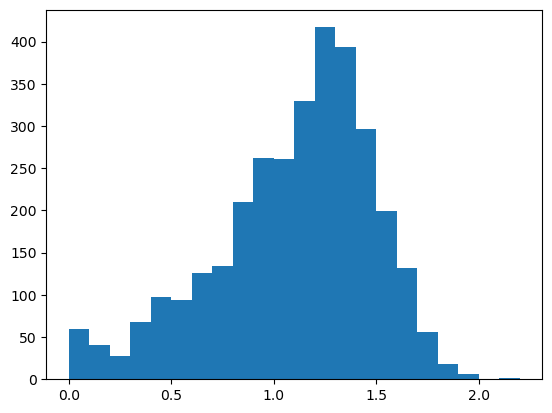

In [98]:
rmsd_list = df['RMSD'].values
print(rmsd_list)
    
plt.hist(rmsd_list,bins=np.arange(0,2.3,0.1)) 

In [63]:
df.loc[(df['RMSD'] >= 1.0)]#&(df['RMSD'] <= 0.2)]
#df.loc[df['Formula']=='C2H4OS2_3']

,Formula,Conf_1,Conf_2,RMSD
14,C2H2N2O_2,CONF1,CONF2,1.165005
17,C2H2N2S2_6,CONF2,CONF3,1.779266
18,C2H2N2S2_6,CONF2,CONF1,1.477907
21,C2H2O3_2,CONF1,CONF2,1.152979
22,C2H2O4,CONF2,CONF1,1.275178
...,...,...,...,...
3223,CH6N4O_2,CONF2,CONF4,1.176210
3225,CH6N4S,CONF2,CONF4,1.342785
3227,CH6N4S,CONF4,CONF3,1.341327
3228,CH6NO3P,CONF1,CONF2,1.352032


# Check Rotational Constants
Units for RMSD are in Angstrom anf in cm-1 for rotational constants.

| Formula | Compared Conformers | RMSD | Difference A | Difference B | Difference C |
|---------|---------------------|------|------------|------------|------------|
| C4H5NO_15 | CONF1/CONF2 | 0.002178 | 1.76e-6 |1.78e-6 |1.05e-6 |
| C3H2N2O_4 | CONF1/CONF2 | 0.00067  | 1.09e-6 |2.42e-7|5.61e-9|
| C2H7NOS_5 | CONF2/CONF7 | 0.104714 |5.37e-6|1.41e-6|3.27e-6|
| C2H5O3P_1 | CONF1/CONF2 | 0.181430 |5.84e-6|1.29e-6|8.30e-6|
| C2H4OS2_3 | CONF4/CONF5 | 0.052327 |1.29e-5|2.13e-5|2.82e-6|
| C2H2N2S2_6 | CONF2/CONF3 | 1.779 |0.00165 | 0.00081 | 0.00054 |
| C2H6S4 | CONF3/CONF4 | 2.21 | 0.0386 | 0.009789 | 0.00199049 |
| C2H2O3_2 | CONF1/CONF2 | 1.15 | 0.00927 | 0.0049866 | 0.0018327 |

In [64]:
data_all = pd.read_csv('/Users/z5380625/Documents/Research/2_BigData/Plots/wB97XD_6-31pGs_2to12Atoms_DataFile.csv')
data_all.loc[data_all['Formula']=='C2H2O3_2']

,Formula,SMILES,# Atoms,Conf#,Rotamer Degeneracy,Relative Energy [kJ/mol],RawFreq [cm-1],ScaledFreq [cm-1],Intensity,mu_a [D],mu_b [D],mu_c [D],mu_tot [D],mu_amu_bmu_c,A [cm-1],B [cm-1],C [cm-1]
435,C2H2O3_2,OC(C=O)=O,7,CONF1,1,0.000000,"[100.5564, 269.4679, 508.7816, 532.1256, 654.6...","[97.53817743103559, 261.3797614290941, 493.510...","[16.7637, 8.96, 19.0006, 27.7782, 96.8225, 132...",-1.258400,-0.206833,0.000570,1.275284,0.000148,0.366915,0.148444,0.105686
436,C2H2O3_2,OC(C=O)=O,7,CONF2,1,2.883847,"[95.2941, 275.7475, 480.6536, 523.5791, 689.27...","[92.4338265285039, 267.4708778473025, 466.2266...","[7.9866, 1.1541, 20.2283, 24.718, 47.7511, 136...",-1.268004,-3.366518,-0.002264,3.597399,-0.009666,0.376190,0.143457,0.103853


In [65]:
A_list = data_all.loc[data_all['Formula']=='C2H2O3_2']['A [cm-1]'].values
print(A_list)
print(A_list[0]-A_list[1])

B_list = data_all.loc[data_all['Formula']=='C2H2O3_2']['B [cm-1]'].values
print(B_list)
print(B_list[0]-B_list[1])

C_list = data_all.loc[data_all['Formula']=='C2H2O3_2']['C [cm-1]'].values
print(C_list)
print(C_list[0]-C_list[1])




[0.36691537 0.37618963]
-0.009274255895390215
[0.14844393 0.14345724]
0.004986685388863293
[0.10568619 0.10385346]
0.0018327240373739034


# Check Rotatable Bonds
CREST - Meta-dynamics simulation used routinely to find conformers in the gas-phase. Combines with atomic RMSDs to bias the applied potential. Works at all levels of theory.

Lipinksi - Rotatable bonds were defined as any single bond, not in a ring, bound to a nonterminal heavy (i.e., non-hydrogen) atom. Excluded from the count were amide C-N bonds because of their high rotational energy barrier.

In [239]:
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')
unique_mols, counts = np.unique(data_all['Formula'].values,return_counts=True)

rota_bond_list = []
bad_rota_bond_mol_list = []
good_rota_bond_mol_list = []
i=0
n=0
for mol in unique_mols:
    smile = data_all.loc[data_all['Formula']==mol]['SMILES'].values[0]
    mol_temp = Chem.MolFromSmiles(smile)
    molh = Chem.AddHs(mol_temp)
    rota_bond_hs = Chem.rdMolDescriptors.CalcNumRotatableBonds(molh, strict = Chem.rdMolDescriptors.NumRotatableBondsOptions.StrictLinkages)

    if rota_bond_hs == 0:
        if counts[i] == 1:
            good_rota_bond_mol_list.append(unique_mols[i])
            n+=1
        elif counts[i] != 1:
            bad_rota_bond_mol_list.append(unique_mols[i])
    else: 
        if counts[i] >= 1:
            good_rota_bond_mol_list.append(unique_mols[i])
#             if counts[i] == 1:
#                 print(mol,'has one conformer and', rota_bond_hs,'rotatable bonds.')
#             elif counts[i] > 1:
#                 print(mol,'has',counts[i],'conformers and', rota_bond_hs,'rotatable bonds.')
                
                
        
    i+=1
    
print(len(bad_rota_bond_mol_list)/(len(bad_rota_bond_mol_list)+len(good_rota_bond_mol_list)))
print(len(good_rota_bond_mol_list))
print(bad_rota_bond_mol_list)
print(n)

0.0
2798
[]
21


# Flag Molecules with VibFreq and Both Errors

In [100]:
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')
single_errors_df=pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/all_RMSD_Single_errors.csv')
data_all.drop(columns=['Flag1'],inplace=True)

In [101]:
data_all

,Unnamed: 0.1,Unnamed: 0,Formula,SMILES,# Atoms,Conf#,Rotamer Degeneracy,Relative Energy [kJ/mol],BW Percent at 10 K,BW Percent at 50 K,...,mu_a [D],mu_b [D],mu_c [D],mu_tot [D],mu_amu_bmu_c,A [cm-1],B [cm-1],C [cm-1],Flag2,Flag3
0,0,0,C2H2,C#C,4,CONF1,1,0.000000,100.0,100.00,...,2.967677e-11,0.000001,-0.000005,0.000005,-1.666957e-22,0.000000,1.184735,1.184735,Present,Complete
1,1,1,C2H2O2,O=CC=O,6,CONF1,1,0.000000,100.0,100.00,...,1.800275e-06,-0.000001,0.000007,0.000007,-1.446818e-17,1.861842,0.159363,0.146798,Present,Complete
2,2,2,C2H2OS_1,C#CSO,6,CONF1,1,0.000000,100.0,100.00,...,-5.466939e-01,0.581126,-1.353319,1.571004,4.299470e-01,0.672851,0.131892,0.111405,Present,Complete
3,3,3,C2H2OS_2,O=CC=S,6,CONF1,1,0.000000,100.0,100.00,...,-1.118855e+00,0.088795,0.000095,1.122373,-9.414538e-06,1.725695,0.095213,0.090234,Present,Complete
4,4,4,C2H2O_1,C1=CO1,5,CONF1,1,0.000000,100.0,100.00,...,-2.330776e+00,-0.060112,-0.000187,2.331551,-2.615070e-05,1.221050,0.800449,0.483497,Present,Complete
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10199,10199,10199,C6H8_6,CC1=CC1C=C,14,CONF2,3,3.827976,0.0,0.01,...,-1.169567e+00,0.386492,-0.092404,1.235233,4.176908e-02,0.219722,0.082840,0.074881,Present,Complete
10200,10200,10200,C6H8_6,CC1=CC1C=C,14,CONF1,3,0.000000,100.0,99.99,...,-1.438603e+00,0.207033,-0.133619,1.459553,3.979669e-02,0.276880,0.070069,0.060904,Present,Complete
10201,10201,10201,C6H8_8,CC1=CC=CC1,14,CONF1,3,0.000000,100.0,100.00,...,-5.666862e-01,-0.476127,0.000000,0.740155,0.000000e+00,0.268572,0.107810,0.079179,Present,Complete
10202,10202,10202,C6H8_8,CC1=CC=CC1,14,CONF2,2,5.755353,0.0,0.00,...,-5.672021e-01,-0.470850,-0.065963,0.740114,-1.761649e-02,0.268571,0.107810,0.079179,Present,Complete


In [102]:
formula_list = data_all['Formula'].values
CONF_list = data_all['Conf#'].values
flag_list = []

for i in np.arange(0,len(CONF_list),1):
    label = single_errors_df.loc[(single_errors_df['Formula']==formula_list[i])&(single_errors_df['CONF']==CONF_list[i])]['Label'].values[0]
    flag_list.append(label)

data_all['Flag1'] = flag_list

In [103]:
data_all.to_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv',index=False,sep=',')

# Check if Ground State Conformers Break

In [104]:
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')
data_all.drop(columns=['Flag2'],inplace=True)
data_all

,Unnamed: 0.1,Unnamed: 0,Formula,SMILES,# Atoms,Conf#,Rotamer Degeneracy,Relative Energy [kJ/mol],BW Percent at 10 K,BW Percent at 50 K,...,mu_a [D],mu_b [D],mu_c [D],mu_tot [D],mu_amu_bmu_c,A [cm-1],B [cm-1],C [cm-1],Flag3,Flag1
0,0,0,C2H2,C#C,4,CONF1,1,0.000000,100.0,100.00,...,2.967677e-11,0.000001,-0.000005,0.000005,-1.666957e-22,0.000000,1.184735,1.184735,Complete,Conformer Retained
1,1,1,C2H2O2,O=CC=O,6,CONF1,1,0.000000,100.0,100.00,...,1.800275e-06,-0.000001,0.000007,0.000007,-1.446818e-17,1.861842,0.159363,0.146798,Complete,Conformer Retained
2,2,2,C2H2OS_1,C#CSO,6,CONF1,1,0.000000,100.0,100.00,...,-5.466939e-01,0.581126,-1.353319,1.571004,4.299470e-01,0.672851,0.131892,0.111405,Complete,Conformer Retained
3,3,3,C2H2OS_2,O=CC=S,6,CONF1,1,0.000000,100.0,100.00,...,-1.118855e+00,0.088795,0.000095,1.122373,-9.414538e-06,1.725695,0.095213,0.090234,Complete,Conformer Retained
4,4,4,C2H2O_1,C1=CO1,5,CONF1,1,0.000000,100.0,100.00,...,-2.330776e+00,-0.060112,-0.000187,2.331551,-2.615070e-05,1.221050,0.800449,0.483497,Complete,Conformer Retained
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10199,10199,10199,C6H8_6,CC1=CC1C=C,14,CONF2,3,3.827976,0.0,0.01,...,-1.169567e+00,0.386492,-0.092404,1.235233,4.176908e-02,0.219722,0.082840,0.074881,Complete,Conformer Retained
10200,10200,10200,C6H8_6,CC1=CC1C=C,14,CONF1,3,0.000000,100.0,99.99,...,-1.438603e+00,0.207033,-0.133619,1.459553,3.979669e-02,0.276880,0.070069,0.060904,Complete,Conformer Retained
10201,10201,10201,C6H8_8,CC1=CC=CC1,14,CONF1,3,0.000000,100.0,100.00,...,-5.666862e-01,-0.476127,0.000000,0.740155,0.000000e+00,0.268572,0.107810,0.079179,Complete,Conformer Retained
10202,10202,10202,C6H8_8,CC1=CC=CC1,14,CONF2,2,5.755353,0.0,0.00,...,-5.672021e-01,-0.470850,-0.065963,0.740114,-1.761649e-02,0.268571,0.107810,0.079179,Complete,CENSO_VibFreq


In [105]:
molecules_list = np.unique(data_all['Formula'].values)
index_list = [data_all.index[data_all['Formula'] == mol].tolist() for mol in molecules_list]

In [106]:
flags_list = list(np.zeros(len(data_all)))
i=0
for mol in molecules_list:
    relative_eng_list = data_all.loc[data_all['Formula']==mol]['Relative Energy [kJ/mol]'].values
    zero_cnt = list(relative_eng_list).count(0.0)
    if zero_cnt == 1:
        flag = 'Present'
    elif zero_cnt == 0:
        flag = 'Missing'
    for j in index_list[i]:
        flags_list[j] = flag
    i+=1
    
print(len(flags_list))
data_all['Flag2'] = flags_list

10204


In [107]:
data_all

,Unnamed: 0.1,Unnamed: 0,Formula,SMILES,# Atoms,Conf#,Rotamer Degeneracy,Relative Energy [kJ/mol],BW Percent at 10 K,BW Percent at 50 K,...,mu_b [D],mu_c [D],mu_tot [D],mu_amu_bmu_c,A [cm-1],B [cm-1],C [cm-1],Flag3,Flag1,Flag2
0,0,0,C2H2,C#C,4,CONF1,1,0.000000,100.0,100.00,...,0.000001,-0.000005,0.000005,-1.666957e-22,0.000000,1.184735,1.184735,Complete,Conformer Retained,Present
1,1,1,C2H2O2,O=CC=O,6,CONF1,1,0.000000,100.0,100.00,...,-0.000001,0.000007,0.000007,-1.446818e-17,1.861842,0.159363,0.146798,Complete,Conformer Retained,Present
2,2,2,C2H2OS_1,C#CSO,6,CONF1,1,0.000000,100.0,100.00,...,0.581126,-1.353319,1.571004,4.299470e-01,0.672851,0.131892,0.111405,Complete,Conformer Retained,Present
3,3,3,C2H2OS_2,O=CC=S,6,CONF1,1,0.000000,100.0,100.00,...,0.088795,0.000095,1.122373,-9.414538e-06,1.725695,0.095213,0.090234,Complete,Conformer Retained,Present
4,4,4,C2H2O_1,C1=CO1,5,CONF1,1,0.000000,100.0,100.00,...,-0.060112,-0.000187,2.331551,-2.615070e-05,1.221050,0.800449,0.483497,Complete,Conformer Retained,Present
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10199,10199,10199,C6H8_6,CC1=CC1C=C,14,CONF2,3,3.827976,0.0,0.01,...,0.386492,-0.092404,1.235233,4.176908e-02,0.219722,0.082840,0.074881,Complete,Conformer Retained,Present
10200,10200,10200,C6H8_6,CC1=CC1C=C,14,CONF1,3,0.000000,100.0,99.99,...,0.207033,-0.133619,1.459553,3.979669e-02,0.276880,0.070069,0.060904,Complete,Conformer Retained,Present
10201,10201,10201,C6H8_8,CC1=CC=CC1,14,CONF1,3,0.000000,100.0,100.00,...,-0.476127,0.000000,0.740155,0.000000e+00,0.268572,0.107810,0.079179,Complete,Conformer Retained,Present
10202,10202,10202,C6H8_8,CC1=CC=CC1,14,CONF2,2,5.755353,0.0,0.00,...,-0.470850,-0.065963,0.740114,-1.761649e-02,0.268571,0.107810,0.079179,Complete,CENSO_VibFreq,Present


In [108]:
data_all[data_all['Formula']=='C3H5N_5']

,Unnamed: 0.1,Unnamed: 0,Formula,SMILES,# Atoms,Conf#,Rotamer Degeneracy,Relative Energy [kJ/mol],BW Percent at 10 K,BW Percent at 50 K,...,mu_b [D],mu_c [D],mu_tot [D],mu_amu_bmu_c,A [cm-1],B [cm-1],C [cm-1],Flag3,Flag1,Flag2
292,292,292,C3H5N_5,CN=C=C,9,CONF2,2,4.214186,0.0,0.0,...,1.087878,-0.566910,1.379194,-0.388741,1.441372,0.148331,0.142027,Complete,CENSO_VibFreq,Present
293,293,293,C3H5N_5,CN=C=C,9,CONF1,6,0.000000,100.0,100.0,...,1.233803,0.000564,1.379283,0.000429,1.441410,0.148329,0.142026,Complete,Conformer Retained,Present


In [109]:
data_all.to_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv',index=True,sep=',')

# Check if Ensembles are Complete

In [110]:
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')
data_all.drop(columns=['Flag3'],inplace=True)

In [111]:
def int_get_gibbs_energy(energy_df,file):
    if os.path.exists(file) == True:
            inp = open(file, 'r')
            mol_id = file.split('/')[-1].split('_bweight')[0]
            energy_info = []
            for line in inp:
                line = line.strip()
                if line.startswith('CONF'):
                    energy_info.append(line.split())
            for row in energy_info:
                if energy_info.index(row) > 0:
                    energy_df.loc[len(energy_df)] = [row[0],float(row[5])*627.509*4.184] # 4.184 is the conversion factor to kJ/mol
    return mol_id,energy_df

def get_censo_gibbs_energy(file):
    energy_df = pd.DataFrame(columns = ['CONF#','G'])
    
    mol_id,final_df = int_get_gibbs_energy(energy_df,file)
        
    
    final_df = final_df.sort_values('G')
    min_energy = np.min(final_df['G'].values)
    final_df['G'] = final_df['G'] - min_energy
    
    return mol_id,len(final_df)

In [112]:
files_list = glob.glob(comp_loc+'4_BigData/?_Atoms/')+glob.glob(comp_loc+'4_BigData/??_Atoms/')
files_list.remove(comp_loc+'4_BigData/21_Atoms/')# Not Complete yet

In [113]:
num_confs_df = pd.DataFrame(columns = ['Formula','# CENSO Confs'])
molecules_list = []
num_confs_list = []
for loc in files_list:
        files_mol = glob.glob(loc+'3_CREST_CENSO_Outputs/BWeights_GeomFiles_Conformers/*.dat')
        for file in files_mol:
            mol_id, num_confs = get_censo_gibbs_energy(file)
            print(mol_id,num_confs)
            molecules_list.append(mol_id)
            num_confs_list.append(num_confs)
            
num_confs_df['Formula'] = molecules_list
num_confs_df['# CENSO Confs'] = num_confs_list


HOP 1
C3N2O 1
O3 1
C3H2O_2 1
CH2O 1
CH4 1
CHNO2S 2
C2N2S 1
C2HN3 1
CN2O_2 1
H3P 1
C2H4 1
CH4S 1
H3NO 1
C2O2 1
C2HNO 1
C4S2 1
C2H2O2 1
CH3OP 1
CN4O 1
CO2 1
C3H2O_1 1
CN2O_1 1
O2S 1
C3HN 1
CHN 1
CH3NO 1
C4N2 1
C3O2 1
HN3 1
CHNO_2 1
C2H2O_2 1
CHNO3_1 1
CO 1
C2H2S_1 1
C2HOP 1
HNO2S 1
CHNO3_2 3
CHNO_1 1
C2H2O_1 1
CH2OS 1
H4NP 1
CH2N2S 2
H3OP 1
C2H2S_2 1
CH2N2 1
H2O 1
CN2O3 1
HNO 1
C2H2 1
C3H2O_3 1
O2 1
O3S 1
CHN3O 2
H2S 1
H2O2 1
H3O2P 2
COS 1
C2H2OS_1 1
H2N2O2 1
C3S2 1
C2N2 1
C4H2 1
CN2OS 2
C2H2OS_2 1
CH2O3 1
P4 1
H3N 1
H2O2S2 3
C2H3N_3 1
CH3NS 1
N2 1
C2H3N_2 1
C2H2S2_2 1
CH2O2 1
HO2P 2
CH2N2O_1 2
C3HNO 1
CS2 1
CH2N2O_2 1
CH4O 1
C2HNS2 1
H2O3S 2
C3OS 1
C2H2S2_1 1
CH2S 1
C2S2 1
C2H3N_1 1
C2N2O 1
H4N2 1
CHNS 1
HNO3 1
C3H4O2_7 1
C2H5NS_4 5
C4H4O_10 2
C3H5N_7 2
C4H4O_9 2
CH5O2P 1
C3H4OS_5 3
C3H4N2_10 1
C3H6_2 1
C4H4O_3 1
C2H5NO_7 3
C3H4S2_3 2
C4H3NO_4 1
CH4O2S2 1
CH4N2S2_2 3
C2H5NS_3 2
C2H5OP_1 2
C3H4OS_2 1
C4H4O_4 1
C4H3NO_3 1
C4H4O_14 2
C2H5OP_2 1
C4H4S_4 1
C4H3NS_3 2
CH4N2S2_1 4
H4NO3P 2
C3H

C4H7NO_43 4
C3H7NO2_7 4
C4H8O_3 1
C4H7OP_8 1
C4H8O_9 6
C4H7NO_49 3
C5H8_5 2
C4H7OP_2 1
C3H8N2_6 13
C5H7N_22 1
C3H7NOS_5 5
C5H7N_13 1
C5H7N_3 3
C4H7NO_9 2
C3H8N2_12 3
C3H7NO2_12 4
C3H7NS2_3 2
C5H7N_19 2
C5H7N_9 1
C4H7NO_3 9
C3H8N2_18 1
C3H7NO2_18 1
C4H7NO_31 1
C4H7NO_44 2
C5H8_8 3
C4H8O_4 1
C3H7O2P_6 5
C5H8_2 1
C4H7OP_5 3
C4H7NS_7 2
C3H8N2_1 2
C5H7N_25 2
C3H7NOS_2 1
C5H7N_14 1
C5H7N_4 9
C2H7O2PS_2 4
C3H8N2_15 3
C3H7NO2_15 3
C4H8S_7 1
C4H7NO_4 2
C3H9N_3 2
C3H8N2_2 1
C5H7N_26 5
C4H7NO_38 1
C3H7O2P_5 10
C5H8_1 1
C3H7NO2_9 2
C4H7OP_6 3
C4H7NS_4 2
C3H7NO2_3 4
C4H8O_7 1
C4H7NO_47 4
C3H8N2_8 2
C4H7NO_32 12
C4H7NO_7 5
C2H7N3S_4 3
C5H7N_17 2
C5H7N_7 1
C3H7NOS_1 2
C3H8N2_16 2
C4H8S_4 3
C3H7NO2_16 2
C2H7O2PS_1 2
C3H9N_4 1
C3H8N2_5 3
C5H7N_21 2
C3H7NO2_20 2
C5H8_6 2
C4H7OP_1 2
C4H7NS_3 5
C3H7NO2_4 2
C4H7NO_40 2
C4H7NS_9 2
C4H7NO_35 4
C4H8S_9 4
C2H7N3S_3 3
C5H7N_10 1
C3H7NOS_6 2
C3H8N2_11 3
C4H8S_3 1
C3H7NO2_11 5
C2H7N3S_2 3
C3H8N2_10 4
C3H7NO2_10 6
C4H8S_2 1
C5H7N_1 2
C5H7N_11 2
C3H7NOS_7 2
C4H8S_8

C5H11N_23 1
C5H11P_17 20
C4H11NO_32 7
C5H11P_5 8
C5H11N_11 1
C5H11N_20 4
C5H11P_26 26
C5H11P_8 2
C5H11P_10 6
C4H11NO_35 9
C5H11P_2 6
C5H11N_16 5
C5H11N_27 7
C5H11P_21 7
C4H11OP_5 11
C4H11NS_7 3
C4H11PS_1 9
C4H11NO_27 1
C5H11N_5 3
C4H11NO_16 10
C4H11NO_4 11
C5H11N_35 14
C5H11N_40 7
C4H11OP_2 9
C5H11N_8 1
C4H11NO_20 3
C5H11N_2 6
C4H11NO_11 8
C5H11N_38 18
C4H11NO_3 11
C5H11N_32 4
C4H11NO_9 1
C5H11N_47 1
C4H11NS_9 35
C4H11NO_23 3
C5H11N_1 5
C4H11NO_29 9
C4H11OP_1 6
C4H11NS_3 40
C4H11NO_18 4
C5H11N_44 1
C5H11N_31 1
C4H11NO_12 6
C4H11PS_2 5
C4H11NO_24 4
C5H11N_6 2
C4H11NS_4 17
C5H11N_43 2
C5H11N_36 11
C4H11NO_7 9
C4H11NO_15 12
C5H11N_49 2
C4H11NO_6 6
C5H11N_48 8
C4H11NO_14 16
C5H11N_42 15
C5H11N_37 3
C4H11NS_5 29
C5H11N_7 1
C4H11PS_3 2
C4H11NO_25 6
C4H11NO_1 9
C4H11NO_13 15
C5H11N_45 1
C4H11NO_19 4
C5H11N_30 7
C4H11NO_28 5
C4H11NS_2 6
C4H11NS_8 16
C4H11NO_22 25
C4H11NO_8 11
C5H11N_33 4
C5H11N_46 6
C4H11NO_10 18
C4H11NO_2 8
C5H11N_39 12
C5H11N_3 5
C4H11NO_21 10
C5H11N_9 1
C4H11NS_1 20
C4H11OP

C4H10N2_16 31
C6H10_44 5
C5H10O_6 6
C6H10_31 6
C5H10O_36 6
C5H10S_32 5
C4H10S2_8 34
C6H10_6 4
C4H10OS_4 12
C4H10N2_27 4
C4H10O2_10 2
C5H10S_5 2
C5H10S_38 4
C4H10S2_2 8
C4H10O2_1 16
C6H10_49 5
C5H10O_44 10
C4H10N2_11 2
C6H10_43 2
C5H10O_1 5
C6H10_36 3
C5H10O_31 7
C5H10S_35 5
C6H10_1 1
C4H10OS_3 9
C5H10S_40 18
C4H10N2_20 3
C5H10S_8 1
C4H10O2_17 23
C5H10S_2 4
C4H10OS_9 33
C4H10S2_5 47
C5H10S_3 6
C4H10S2_12 8
C4H10OS_8 39
C4H10O2_16 20
C4H10S2_4 11
C5H10S_34 4
C5H10S_41 26
C4H10OS_2 5
C5H10S_9 1
C4H10N2_21 3
C3H10NPS 3
C6H10_42 1
C4H10N2_10 7
C5H10O_45 6
C5H10O_30 3
C6H10_37 1
C4H11N_1 5
C6H10_48 3
C5H10S_4 3
C4H10O2_11 8
C5H10S_39 2
C4H10S2_3 3
C5H10S_33 3
C4H10S2_9 35
C6H10_7 3
C4H10OS_5 24
C4H10N2_26 8
C6H10_45 2
C4H10N2_17 16
C5H10O_42 2
C5H10O_37 5
C5H10O_7 4
C6H10_30 5
C4H11N_6 2
C4H10O2_7 9
C5H10O_48 2
C4H10O2_20 6
C4H10N2_25 13
C5H10S_45 1
C4H10OS_6 18
C4H10O2_18 22
C6H10_4 1
C5H10S_30 2
C5H10S_7 1
C4H10O2_12 3
C4H10O2_4 6
C4H11N_5 4
C6H10_39 1
C5H10O_34 2
C6H10_33 2
C5H10O_4 8
C6H

In [114]:
molecules_list = np.unique(data_all['Formula'].values)
index_list = [data_all.index[data_all['Formula'] == mol].tolist() for mol in molecules_list]
flags_list = list(np.zeros(len(data_all)))
i=0
for mol in molecules_list:
    num_confs_censo = num_confs_df.loc[num_confs_df['Formula'] == mol]['# CENSO Confs'].values[0]
    num_confs_vibfreq = len(data_all.loc[data_all['Formula']==mol]['Conf#'].values)

    if num_confs_censo == num_confs_vibfreq:
        flag = 'Complete'
    elif num_confs_censo >= num_confs_vibfreq:
        flag = 'Incomplete'
    else:
        flag = 'Weird'
    for j in index_list[i]:
        flags_list[j] = flag
    i+=1
        

data_all['Flag3'] = flags_list
        

In [115]:
data_all[(data_all['Flag2']=='Missing')&(data_all['Flag3']=='Incomplete')]

,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,Formula,SMILES,# Atoms,Conf#,Rotamer Degeneracy,Relative Energy [kJ/mol],BW Percent at 10 K,...,mu_b [D],mu_c [D],mu_tot [D],mu_amu_bmu_c,A [cm-1],B [cm-1],C [cm-1],Flag1,Flag2,Flag3
136,136,136,136,C2H4O2S_3,OC(=O)SC,9,CONF2,3,7.222219,0.00,...,-3.054604,-0.001089,3.221583,0.003406,0.251820,0.108256,0.076823,Conformer Retained,Missing,Incomplete
229,229,229,229,C3H3NOS_7,Sc1ncoc1,9,CONF2,1,1.774311,0.00,...,2.036733,-0.000173,2.230017,-0.000320,0.317601,0.069942,0.057319,Conformer Retained,Missing,Incomplete
519,519,519,519,C2H4OS_6,CC(S)=O,8,CONF3,3,5.352865,0.00,...,3.391712,0.000350,3.393393,0.000127,0.331473,0.161237,0.110720,Conformer Retained,Missing,Incomplete
642,642,642,642,CH2N4S_2,SC1=NN=NN1,8,CONF2,1,5.517746,0.00,...,-4.499694,0.000821,5.715366,-0.013019,0.336640,0.072151,0.059416,Conformer Retained,Missing,Incomplete
730,730,730,730,H3NO3S,O=S(O)(N)=O,8,CONF1,4,1.332178,0.00,...,2.249759,-1.750371,3.723267,-9.432514,0.168191,0.159521,0.155935,Conformer Retained,Missing,Incomplete
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9879,9879,9879,9879,C5H8O_61,OCC#CCC,14,CONF1,11,0.727000,0.02,...,1.080331,-0.348982,2.078929,0.656597,0.420307,0.042036,0.041805,Conformer Retained,Missing,Incomplete
9880,9880,9880,9880,C5H8O_61,OCC#CCC,14,CONF2,7,0.400126,0.78,...,1.070774,-0.300843,2.079226,0.565905,0.420988,0.042015,0.041802,CENSO_VibFreq,Missing,Incomplete
9881,9881,9881,9881,C5H8O_62,CC=CC(C)=O,14,CONF1,9,0.179321,10.37,...,-2.549621,0.000600,2.606132,-0.000825,0.259337,0.077014,0.060710,Conformer Retained,Missing,Incomplete
10172,10172,10172,10172,C6H8_36,CCC#CC=C,14,CONF2,3,0.102657,13.07,...,-0.097058,-0.003026,0.731863,0.000213,0.613817,0.043628,0.041357,Conformer Retained,Missing,Incomplete


In [116]:
data_all.to_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv',index=False,sep=',')

# Check BW, Energy Overlap with Conformer Ensemble Completeness

In [338]:
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')

In [339]:
def exp_to_sci(x):
    '''From https://stackoverflow.com/questions/50679895/np-expx-when-x-is-small'''
    coeff, exp = np.modf(x / np.log(10.0))
    return 10**(coeff + 1), exp - 1

In [340]:
def get_boltzmannweights_at_T(final_df):
    G_list = final_df['RawG'].values
    for T in [10,50,100,298.15]:
        coeff_list = []
        exp_list = []
        for G in G_list:
            b_exp=float(G/(3.166811563e-6*T))
            coeff,exp = exp_to_sci(-b_exp)
            coeff_list.append(coeff)
            exp_list.append(exp)
        P_list = []
        if exp_list.count(exp_list[0]) == len(exp_list):
            P_list = ["{:.2f}".format(coeff*100/sum(coeff_list)) for coeff in coeff_list]
        elif exp_list.count(exp_list[0]) != len(exp_list):
            n_list = np.max(exp_list)-exp_list
            n_coeff_list = list(zip(n_list,coeff_list))
            
            coeff_list_scaled = [n_coeff[1]/10**n_coeff[0] for n_coeff in n_coeff_list]
            
            P_list = ["{:.2f}".format(coeff*100/sum(coeff_list_scaled)) for coeff in coeff_list_scaled]
        
        col_name= str('BW Percent at '+str(T)+' K')
        final_df[col_name] = P_list
    return

In [341]:
def int_get_gibbs_energy(energy_df,file):
    if os.path.exists(file) == True:
            inp = open(file, 'r')
            mol_id = file.split('/')[-1].split('_bweight')[0]
            energy_info = []
            for line in inp:
                line = line.strip()
                if line.startswith('CONF'):
                    energy_info.append(line.split())
            for row in energy_info:
                if energy_info.index(row) > 0:
                    energy_df.loc[len(energy_df)] = [mol_id,row[0],float(row[5])*627.509*4.184,float(row[5])] # 4.184 is the conversion factor to kJ/mol
    return mol_id,energy_df

def get_censo_gibbs_energy(file):
    energy_df = pd.DataFrame(columns = ['Formula','CONF#','G','RawG'])
    
    mol_id,final_df = int_get_gibbs_energy(energy_df,file)
        
    
    final_df = final_df.sort_values('G')
    min_energy = np.min(final_df['G'].values)
    final_df['G'] = final_df['G'] - min_energy
    
    get_boltzmannweights_at_T(final_df)
    
    return final_df,mol_id

In [342]:
files_list = glob.glob(comp_loc+'4_BigData/?_Atoms/')+glob.glob(comp_loc+'4_BigData/??_Atoms/')
files_list.remove(comp_loc+'4_BigData/21_Atoms/')# Not Complete yet

df_all = pd.DataFrame(columns = ['Formula','CONF#','G','RawG','BW Percent at 10 K','BW Percent at 50 K','BW Percent at 100 K','BW Percent at 298.15 K','VibFreq File Exists'])
for loc in files_list:
        files_mol = glob.glob(loc+'3_CREST_CENSO_Outputs/BWeights_GeomFiles_Conformers/*.dat')
        for file in files_mol:
            df,mol_id = get_censo_gibbs_energy(file)
            conf_list = df['CONF#'].values
            VibFreq_exists_list = []
            for conf in conf_list:
                file_vibfreq = loc+'4_VibrationalCalcs/OutputFiles/'+mol_id+'_'+conf+'_harmonic_conformers.log'
                if os.path.exists(file_vibfreq) == True:
                    VibFreq_exists_list.append('Yes')
                elif os.path.exists(file_vibfreq) == False:
                    VibFreq_exists_list.append('No')
            df['VibFreq File Exists']=VibFreq_exists_list

            data = [df_all, df]
            df_all = pd.concat(data)
        
            


In [343]:
df_all

,Formula,CONF#,G,RawG,BW Percent at 10 K,BW Percent at 50 K,BW Percent at 100 K,BW Percent at 298.15 K,VibFreq File Exists
0,HOP,CONF1,0.000000,-417.583135,100.00,100.00,100.00,100.00,Yes
0,C3N2O,CONF1,0.000000,-299.453558,100.00,100.00,100.00,100.00,Yes
0,O3,CONF1,0.000000,-225.769008,100.00,100.00,100.00,100.00,Yes
0,C3H2O_2,CONF1,0.000000,-190.959958,100.00,100.00,100.00,100.00,Yes
0,CH2O,CONF1,0.000000,-114.679064,100.00,100.00,100.00,100.00,Yes
...,...,...,...,...,...,...,...,...,...
1,C4H8O2_11,CONF2,4.776043,-308.034332,0.00,0.00,0.14,3.93,Yes
6,C4H8O2_11,CONF9,6.451373,-308.033693,0.00,0.00,0.02,2.00,Yes
2,C4H8O2_11,CONF3,8.071830,-308.033076,0.00,0.00,0.00,1.04,Yes
0,C5H8S_28,CONF1,0.000000,-594.111632,100.00,100.00,100.00,100.00,Yes


In [354]:
# make to fix list

df_tofix = df_all.loc[df_all['VibFreq File Exists']=='No']


molecules_list = np.unique(df_tofix['Formula'].values)

flag_BW_list = []
flag_G_list = []
for mol in molecules_list:
    confs_list = df_tofix.loc[df_tofix['Formula']==mol]['CONF#'].values
    for conf in confs_list:
        BW_room = float(df_tofix.loc[(df_tofix['Formula']==mol)&(df_tofix['CONF#']==conf)]['BW Percent at 298.15 K'].values[0])
        if BW_room < 50.:
            flag_BW_list.append('Low')
        else:
            flag_BW_list.append('High')
            
        G = float(df_tofix.loc[(df_tofix['Formula']==mol)&(df_tofix['CONF#']==conf)]['G'].values[0])
        if G < 1:
            flag_G_list.append('Low')
        else:
            flag_G_list.append('High')
        
print(len(flag_BW_list),len(df_tofix))
df_tofix['BW Flag'] = flag_BW_list
df_tofix['G Flag'] = flag_G_list
            
    
    

1042 1042


/var/folders/gd/w_6sx_r160zb391203k006_h0000gq/T/ipykernel_52623/1535979914.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_tofix['BW Flag'] = flag_BW_list
/var/folders/gd/w_6sx_r160zb391203k006_h0000gq/T/ipykernel_52623/1535979914.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_tofix['G Flag'] = flag_G_list


In [355]:
df_tofix

,Formula,CONF#,G,RawG,BW Percent at 10 K,BW Percent at 50 K,BW Percent at 100 K,BW Percent at 298.15 K,VibFreq File Exists,BW Flag,G Flag
0,C2O2,CONF1,0.000000,-227.001280,100.00,100.00,100.00,100.00,No,Low,High
0,CN4O,CONF1,0.000000,-332.912075,100.00,100.00,100.00,100.00,No,Low,High
0,CN2O_1,CONF2,0.000000,-223.211352,100.00,100.00,100.00,100.00,No,High,Low
0,C4N2,CONF1,0.000000,-262.251582,100.00,100.00,100.00,100.00,No,High,Low
0,C3O2,CONF1,0.000000,-265.157605,100.00,100.00,100.00,100.00,No,High,Low
...,...,...,...,...,...,...,...,...,...,...,...
3,C3H9NS_3,CONF4,9.161412,-573.204193,0.00,0.00,0.00,0.86,No,Low,High
1,C5H8O_62,CONF2,0.000000,-270.914451,89.63,60.61,54.73,42.30,No,High,Low
3,C5H8O_62,CONF4,3.635002,-270.913067,0.00,0.01,0.69,9.76,No,Low,High
2,C5H8O_62,CONF3,3.949536,-270.912947,0.00,0.00,0.47,8.60,No,Low,High


In [356]:
df_tofix.to_csv('/Users/z5380625/Documents/Research/4_BigData/VibFreq_ToFix.csv',index=False,sep=',')

# Make Ground State DataFile

In [117]:
data_all = pd.read_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1.csv')
#df_present = data_all.loc[data_all['Flag2']=='Present']
df_ground = data_all.loc[data_all['Relative Energy [kJ/mol]']==0.]
df_ground.to_csv('/Users/z5380625/Documents/Research/4_BigData/B971_def2TZVPD_DataFile1_GroundState.csv',index=False,sep=',')

In [118]:
df_ground

,Unnamed: 0.2,Unnamed: 0.1,Unnamed: 0,Formula,SMILES,# Atoms,Conf#,Rotamer Degeneracy,Relative Energy [kJ/mol],BW Percent at 10 K,...,mu_b [D],mu_c [D],mu_tot [D],mu_amu_bmu_c,A [cm-1],B [cm-1],C [cm-1],Flag1,Flag2,Flag3
0,0,0,0,C2H2,C#C,4,CONF1,1,0.0,100.0,...,0.000001,-0.000005,0.000005,-1.666957e-22,0.000000,1.184735,1.184735,Conformer Retained,Present,Complete
1,1,1,1,C2H2O2,O=CC=O,6,CONF1,1,0.0,100.0,...,-0.000001,0.000007,0.000007,-1.446818e-17,1.861842,0.159363,0.146798,Conformer Retained,Present,Complete
2,2,2,2,C2H2OS_1,C#CSO,6,CONF1,1,0.0,100.0,...,0.581126,-1.353319,1.571004,4.299470e-01,0.672851,0.131892,0.111405,Conformer Retained,Present,Complete
3,3,3,3,C2H2OS_2,O=CC=S,6,CONF1,1,0.0,100.0,...,0.088795,0.000095,1.122373,-9.414538e-06,1.725695,0.095213,0.090234,Conformer Retained,Present,Complete
4,4,4,4,C2H2O_1,C1=CO1,5,CONF1,1,0.0,100.0,...,-0.060112,-0.000187,2.331551,-2.615070e-05,1.221050,0.800449,0.483497,Conformer Retained,Present,Complete
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10196,10196,10196,10196,C6H8_5,CC(C1)=C1C=C,14,CONF1,3,0.0,100.0,...,0.715125,0.000238,0.940538,1.039541e-04,0.317003,0.068717,0.057732,Conformer Retained,Present,Complete
10198,10198,10198,10198,C6H8_50,C=C1CC12CC2,14,CONF1,2,0.0,100.0,...,-0.179251,0.000017,0.671013,1.922556e-06,0.238074,0.092912,0.081065,Conformer Retained,Present,Complete
10200,10200,10200,10200,C6H8_6,CC1=CC1C=C,14,CONF1,3,0.0,100.0,...,0.207033,-0.133619,1.459553,3.979669e-02,0.276880,0.070069,0.060904,Conformer Retained,Present,Complete
10201,10201,10201,10201,C6H8_8,CC1=CC=CC1,14,CONF1,3,0.0,100.0,...,-0.476127,0.000000,0.740155,0.000000e+00,0.268572,0.107810,0.079179,Conformer Retained,Present,Complete


In [119]:
num_mols_missing = len(np.unique(data_all[data_all['Flag2']=='Missing']['Formula']))
print(num_mols_missing)
print(2914-(129+30+8+4))
print(129+30+8+4)

55
2743
171


In [120]:
num_mols_all = len(np.unique(data_all['Formula'].values))
print(num_mols_all)

2798


In [16]:
print((171/2914)*100)

5.868222374742622


# Check Flag Stats

In [231]:
molecules_list = np.unique(data_all['Formula'].values)
num_missing=0
num_incomplete=0
for mol in molecules_list:
    
    missing_ground = data_all.loc[data_all['Formula']==mol]['Flag2'].values
    if missing_ground[0]=='Missing':
        num_missing+=1
    incomplete = data_all.loc[data_all['Formula']==mol]['Flag3'].values
    if incomplete[0]=='Incomplete':
        num_incomplete+=1
    
print(num_missing/len(molecules_list)*100,num_missing,len(molecules_list))
print(num_incomplete/len(molecules_list)*100,num_incomplete)
        


1.9656897784131524 55 2798
18.69192280200143 523


# Check NotWorking Vibrational Frequency Calculations